### Judgment Text Models (CLEANED_TEXT)

In [ ]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 474.3/474.3 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.9/39.9 MB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 10.2 MB/s eta 0:00:00
  Attempting uninstall: pyarrow
    Found existing installation: pyarrow 14.0.2
    Uninstalling pyarrow-14.0.2:
      Successfully uninstalled pyarrow-14.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.4.1 requires pyarrow<15.0.0a0,>=14.0.1, but you have pyarrow 17.0.0 which is incompatible.
ibis-framework 8.0.0 requires pyarrow<16,>=2, but you have pyarrow 17.0.0 which is incompatible.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
unique_df = pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/processed_dataset_cleaned_NER.csv')
unique_df.head()

Mounted at /content/drive


,start,end,text,labels,meta_group,cleaned_text,processed_text
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


##### Layer Freezing and class weights for imbalanced datasets

In [ ]:
from transformers import AutoTokenizer, AutoModel, TrainingArguments, Trainer
from transformers import DataCollatorWithPadding
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, classification_report
import torch
import numpy as np
import pandas as pd
from torch.utils.data import DataLoader, Dataset
import torch.nn as nn

# Load the tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("law-ai/InLegalBERT")
bert_model = AutoModel.from_pretrained("law-ai/InLegalBERT")

# Freeze all layers except the last few for fine-tuning
for param in bert_model.parameters():
    param.requires_grad = False
# Unfreeze the last 2 layers
for param in bert_model.encoder.layer[-2:].parameters():
    param.requires_grad = True

# Custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels):
        self.texts = texts
        self.labels = labels

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        item = tokenizer(self.texts[idx], padding='max_length', truncation=True, max_length=128, return_tensors="pt")
        item = {key: val.squeeze(0) for key, val in item.items()}  # Flatten tensor dimension
        item['labels'] = torch.tensor(self.labels[idx], dtype=torch.long)
        return item

X = unique_df['cleaned_text'].tolist()
y = unique_df['labels']

# Encode the labels
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Calculate class weights for imbalanced datasets
class_counts = np.bincount(y_encoded)
class_weights = [len(y_encoded) / (len(label_encoder.classes_) * count) for count in class_counts]

# Convert class weights to a tensor
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to('cuda')

# Create the dataset and dataloader
dataset = TextDataset(X, y_encoded)
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)
dataloader = DataLoader(dataset, batch_size=32, collate_fn=data_collator)

# Define model with an additional classification head
class LegalBERTClassifier(nn.Module):
    def __init__(self, bert_model, num_labels):
        super(LegalBERTClassifier, self).__init__()
        self.bert = bert_model
        self.dropout = nn.Dropout(0.3)
        self.classifier = nn.Linear(bert_model.config.hidden_size, num_labels)

    def forward(self, input_ids, attention_mask, labels=None):
        outputs = self.bert(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs[1]  # CLS token representation
        pooled_output = self.dropout(pooled_output)
        logits = self.classifier(pooled_output)
        loss = None
        if labels is not None:
            loss_fn = nn.CrossEntropyLoss(weight=class_weights_tensor)
            loss = loss_fn(logits.view(-1, len(label_encoder.classes_)), labels.view(-1))
        return (loss, logits) if loss is not None else logits

# Initialize the model
model = LegalBERTClassifier(bert_model, num_labels=len(label_encoder.classes_))
model.to("cuda")

# Define Training Arguments
training_args = TrainingArguments(
    output_dir='/results',
    num_train_epochs=3,
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='/logs',
    logging_steps=10,
    evaluation_strategy="epoch",
)

# Define compute metrics
def compute_metrics(eval_pred):
    logits, labels = eval_pred
    preds = np.argmax(logits, axis=1)
    accuracy = accuracy_score(labels, preds)
    return {'accuracy': accuracy}

# Define Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=dataset,
    eval_dataset=dataset,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/516 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


In [ ]:
from sklearn.metrics import classification_report
from sklearn.model_selection import KFold

# Define K-Fold Cross-Validation
kf = KFold(n_splits=3, shuffle=True, random_state=42)

# Track overall performance metrics
all_fold_accuracies = []
all_preds = []
all_labels = []

# Perform cross-validation
for fold, (train_index, val_index) in enumerate(kf.split(X)):
    print(f"Starting fold {fold + 1}...")

    # Split data into training and validation sets
    X_train, X_val = [X[i] for i in train_index], [X[i] for i in val_index]
    y_train, y_val = [y_encoded[i] for i in train_index], [y_encoded[i] for i in val_index]

    # Create datasets for the current fold
    train_dataset = TextDataset(X_train, y_train)
    val_dataset = TextDataset(X_val, y_val)

    # Define Trainer for current fold
    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=data_collator,
        compute_metrics=compute_metrics,
    )

    # Train the model for the current fold
    trainer.train()

    # Evaluate the model on the validation set for the current fold
    fold_results = trainer.evaluate()
    print(f"Fold {fold + 1} Accuracy:", fold_results['eval_accuracy'])

    # Store fold results
    all_fold_accuracies.append(fold_results['eval_accuracy'])

    # Collect predictions and true labels for classification report
    predictions = trainer.predict(val_dataset)
    preds = np.argmax(predictions.predictions, axis=1)
    all_preds.extend(preds)
    all_labels.extend(y_val)

# Calculate and print the average accuracy across all folds
average_accuracy = np.mean(all_fold_accuracies)
print(f"Average Accuracy across 3 folds: {average_accuracy}")

# Print the overall classification report
print("Overall Classification Report:")
print(classification_report(all_labels, all_preds, target_names=label_encoder.classes_))


Starting fold 1...


Epoch,Training Loss,Validation Loss,Accuracy
1,1.296000,1.367925,0.465452
2,1.473200,1.241027,0.489581
3,1.162800,1.211528,0.495739


Fold 1 Accuracy: 0.4957394752383363
Starting fold 2...


Epoch,Training Loss,Validation Loss,Accuracy
1,1.118100,1.071497,0.538981
2,1.129100,1.049252,0.529615
3,1.077800,1.030234,0.539487


Fold 2 Accuracy: 0.5394870064124199
Starting fold 3...


Epoch,Training Loss,Validation Loss,Accuracy
1,1.040200,0.936174,0.546996
2,0.935100,0.927733,0.554506
3,1.022800,0.897611,0.571380


Fold 3 Accuracy: 0.5713803577455282
Average Accuracy across 3 folds: 0.5355356131320947
Overall Classification Report:
                precision    recall  f1-score   support

      ANALYSIS       0.76      0.26      0.39     12799
ARG_PETITIONER       0.33      0.43      0.37      1568
ARG_RESPONDENT       0.23      0.50      0.31       805
           FAC       0.64      0.69      0.66      7183
         ISSUE       0.53      0.91      0.67       458
          NONE       0.73      0.85      0.79      1859
      PREAMBLE       0.85      0.69      0.76      5271
PRE_NOT_RELIED       0.15      0.31      0.20       171
    PRE_RELIED       0.35      0.65      0.46      1711
         RATIO       0.16      0.66      0.26       872
           RLC       0.29      0.67      0.41       944
           RPC       0.68      0.85      0.76      1357
           STA       0.35      0.86      0.50       559

      accuracy                           0.54     35557
     macro avg       0.47      0.64    

##### 5 epochs

In [ ]:
# Load the tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("law-ai/InLegalBERT")
bert_model = AutoModel.from_pretrained("law-ai/InLegalBERT")

# Freeze all layers except the last few for fine-tuning
for param in bert_model.parameters():
    param.requires_grad = False
# Unfreeze the last 2 layers
for param in bert_model.encoder.layer[-2:].parameters():
    param.requires_grad = True

class TextDataset(Dataset):
    def __init__(self, texts, labels):
        self.texts = texts
        self.labels = labels

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        item = tokenizer(self.texts[idx], padding='max_length', truncation=True, max_length=128, return_tensors="pt")
        item = {key: val.squeeze(0) for key, val in item.items()}  # Flatten tensor dimension
        item['labels'] = torch.tensor(self.labels[idx], dtype=torch.long)
        return item

X = unique_df['cleaned_text'].tolist()
y = unique_df['labels']

# Encode the labels
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Calculate class weights for imbalanced datasets
class_counts = np.bincount(y_encoded)
class_weights = [len(y_encoded) / (len(label_encoder.classes_) * count) for count in class_counts]

# Convert class weights to a tensor
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to('cuda')

dataset = TextDataset(X, y_encoded)
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)
dataloader = DataLoader(dataset, batch_size=32, collate_fn=data_collator)

# Define model with an additional classification head
class LegalBERTClassifier(nn.Module):
    def __init__(self, bert_model, num_labels):
        super(LegalBERTClassifier, self).__init__()
        self.bert = bert_model
        self.dropout = nn.Dropout(0.3)
        self.classifier = nn.Linear(bert_model.config.hidden_size, num_labels)

    def forward(self, input_ids, attention_mask, labels=None):
        outputs = self.bert(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs[1]  # CLS token representation
        pooled_output = self.dropout(pooled_output)
        logits = self.classifier(pooled_output)
        loss = None
        if labels is not None:
            loss_fn = nn.CrossEntropyLoss(weight=class_weights_tensor)
            loss = loss_fn(logits.view(-1, len(label_encoder.classes_)), labels.view(-1))
        return (loss, logits) if loss is not None else logits


model = LegalBERTClassifier(bert_model, num_labels=len(label_encoder.classes_))
model.to("cuda")

training_args = TrainingArguments(
    output_dir='/results',
    num_train_epochs=5,
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    warmup_steps=500,
    weight_decay=0.001,
    logging_dir='/logs',
    logging_steps=10,
    evaluation_strategy="epoch",
)

def compute_metrics(eval_pred):
    logits, labels = eval_pred
    preds = np.argmax(logits, axis=1)
    accuracy = accuracy_score(labels, preds)
    return {'accuracy': accuracy}


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


In [ ]:
from sklearn.metrics import classification_report
from sklearn.model_selection import KFold

kf = KFold(n_splits=5, shuffle=True, random_state=42)

all_fold_accuracies = []
all_preds = []
all_labels = []

for fold, (train_index, val_index) in enumerate(kf.split(X)):
    print(f"Starting fold {fold + 1}...")

    X_train, X_val = [X[i] for i in train_index], [X[i] for i in val_index]
    y_train, y_val = [y_encoded[i] for i in train_index], [y_encoded[i] for i in val_index]

    train_dataset = TextDataset(X_train, y_train)
    val_dataset = TextDataset(X_val, y_val)


    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=data_collator,
        compute_metrics=compute_metrics,
    )

    trainer.train()

    fold_results = trainer.evaluate()
    print(f"Fold {fold + 1} Accuracy:", fold_results['eval_accuracy'])

    all_fold_accuracies.append(fold_results['eval_accuracy'])

    predictions = trainer.predict(val_dataset)
    preds = np.argmax(predictions.predictions, axis=1)
    all_preds.extend(preds)
    all_labels.extend(y_val)

# Calculate and print the average accuracy across all folds
average_accuracy = np.mean(all_fold_accuracies)
print(f"Average Accuracy across 3 folds: {average_accuracy}")

# Print the overall classification report
print("Overall Classification Report:")
print(classification_report(all_labels, all_preds, target_names=label_encoder.classes_))


Starting fold 1...


Epoch,Training Loss,Validation Loss,Accuracy
1,1.344000,1.304082,0.454865
2,0.977100,1.186667,0.509421
3,1.211700,1.146039,0.494235
4,1.082500,1.127445,0.517717
5,0.971200,1.121834,0.524888


Fold 1 Accuracy: 0.5248875140607424
Starting fold 2...


Epoch,Training Loss,Validation Loss,Accuracy
1,0.954400,0.975025,0.529528
2,1.285600,0.952180,0.543448
3,1.131300,0.917213,0.593223
4,0.908800,0.909249,0.573678
5,0.763000,0.900969,0.585208


Fold 2 Accuracy: 0.5852080989876266
Starting fold 3...


Epoch,Training Loss,Validation Loss,Accuracy
1,0.755100,0.670019,0.604416
2,0.739600,0.655256,0.620447
3,0.705000,0.643978,0.633385
4,0.553900,0.633087,0.645619
5,0.745300,0.631793,0.647026


Fold 3 Accuracy: 0.6470257347771059
Starting fold 4...


Epoch,Training Loss,Validation Loss,Accuracy
1,0.765600,0.450625,0.674870
2,0.916300,0.460975,0.668682
3,0.595500,0.456149,0.676417
4,0.500200,0.441339,0.699480
5,0.513200,0.434884,0.703558


Fold 4 Accuracy: 0.703557868091689
Starting fold 5...


Epoch,Training Loss,Validation Loss,Accuracy
1,0.662800,0.350508,0.727464
2,0.388100,0.359877,0.725636
3,0.381200,0.354453,0.740683
4,0.283100,0.342654,0.749121
5,0.430400,0.330294,0.767121


Fold 5 Accuracy: 0.7671213612712698


In [ ]:
(0.5248875140607424+0.5852080989876266+0.6470257347771059+0.703557868091689+0.7671213612712698) / 5

0.6455601154376868

#### DL Models

In [ ]:
!pip install scikeras torch transformers datasets
#!pip install scikit-learn==1.2.2 --force-reinstall

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import StratifiedKFold
from keras.models import Sequential
from keras.layers import Dense, LSTM, GRU, SimpleRNN, Bidirectional
from transformers import AutoTokenizer, AutoModel
from scikeras.wrappers import KerasClassifier
import torch
import warnings

warnings.filterwarnings("ignore")

# Load InLegalBERT model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("law-ai/InLegalBERT")
bert_model = AutoModel.from_pretrained("law-ai/InLegalBERT")

# Define a function to generate InLegalBERT embeddings
def generate_inlegalbert_embeddings(text):
    embeddings = []
    for sentence in text:
        # Tokenize input text
        input_ids = tokenizer.encode(sentence, add_special_tokens=True, max_length=512, truncation=True)
        input_ids = torch.tensor([input_ids])
        with torch.no_grad():
            # Get InLegalBERT model output
            outputs = bert_model(input_ids)
            # Extract the output embeddings (last layer hidden states)
            last_hidden_states = outputs.last_hidden_state
            # Average the token embeddings to get sentence embedding
            sentence_embedding = torch.mean(last_hidden_states, dim=1).squeeze().numpy()
            embeddings.append(sentence_embedding)
    return np.array(embeddings)

# Separate features (X) and target variable (y)
X = unique_df['cleaned_text']
y = unique_df['labels']

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Encode the target variable
y_encoded = label_encoder.fit_transform(y)

tokenizer_config.json:   0%|          | 0.00/516 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

In [ ]:
# Generate embeddings using InLegalBERT
# X_embeddings = generate_inlegalbert_embeddings(X)
# torch.save(X_embeddings, '/content/drive/My Drive/X_embeddings_InLegalBERT.pt')
X_embeddings = torch.load('/content/drive/MyDrive/IndianLegalClassification/Code/X_embeddings_InLegalBERT.pt')

# Define models
def build_lstm_model(input_shape, num_classes):
    model = Sequential()
    model.add(LSTM(128, return_sequences=True, input_shape=input_shape))  # First LSTM layer
    model.add(LSTM(64, return_sequences=True))  # Second LSTM layer
    model.add(LSTM(32))  # Third LSTM layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

models = {
    'LSTM': build_lstm_model
}

# Loop over the models
for model_name, model in models.items():
    print(f"Model: {model_name}")
    classification_reports = []
    accuracies = []
    all_true = []
    all_pred = []
    losses = []

    # Loop over the splits
    for fold, (train_index, val_index) in enumerate(kfold.split(X_embeddings, y_encoded)):
        X_train, X_val = X_embeddings[train_index], X_embeddings[val_index]
        y_train, y_val = y_encoded[train_index], y_encoded[val_index]

        X_train = np.reshape(X_train, (X_train.shape[0], 1, X_train.shape[1]))
        X_val = np.reshape(X_val, (X_val.shape[0], 1, X_val.shape[1]))

        # Define and compile the model
        some_model = model((X_train.shape[1], X_train.shape[2]), len(label_encoder.classes_))
        some_model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

        # Train the model
        some_model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

        # Evaluate the model
        loss, accuracy = some_model.evaluate(X_val, y_val)
        accuracies.append(accuracy)
        losses.append(loss)
        print(f"Fold {fold+1} Accuracy: {accuracy}")

        # Generate classification report
        y_pred = np.argmax(some_model.predict(X_val), axis=1)
        report = classification_report(y_val, y_pred, target_names=label_encoder.classes_)
        classification_reports.append(report)
        all_true.extend(y_val)
        all_pred.extend(y_pred)

    # Print average accuracy across all folds
    print(f"Average Accuracy: {np.mean(accuracies)}")
    print(f"Average Loss: {np.mean(losses)}")

    # Print overall classification report
    print(f"Classification Report (Overall):\n")
    print(classification_report(all_true, all_pred, target_names=label_encoder.classes_))

Model: LSTM
Epoch 1/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 14s 10ms/step - accuracy: 0.4505 - loss: 1.7855
Epoch 2/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.6201 - loss: 1.1859
Epoch 3/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.6534 - loss: 1.0686
Epoch 4/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - accuracy: 0.6695 - loss: 0.9886
Epoch 5/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - accuracy: 0.6899 - loss: 0.9309
Epoch 6/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.7057 - loss: 0.8733
Epoch 7/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - accuracy: 0.7172 - loss: 0.8299
Epoch 8/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 10s 7ms/step - accuracy: 0.7370 - loss: 0.7702
Epoch 9/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.7538 - loss: 0.7288
Epoch 10/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.7788 - loss: 0.6628
Epoch 11/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - accuracy: 0.7923 - loss: 0.6196
Epoch 12/100
741/741 ━━━━━

In [ ]:
X_embeddings = torch.load('/content/drive/MyDrive/IndianLegalClassification/Code/X_embeddings_InLegalBERT.pt')


def build_gru_model(input_shape, num_classes):
    model = Sequential()
    model.add(GRU(128, return_sequences=True, input_shape=input_shape))  # First GRU layer
    model.add(GRU(64, return_sequences=True))  # Second GRU layer
    model.add(GRU(32))  # Third GRU layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_rnn_model(input_shape, num_classes):
    model = Sequential()
    model.add(SimpleRNN(128, return_sequences=True, input_shape=input_shape))  # First SimpleRNN layer
    model.add(SimpleRNN(64, return_sequences=True))  # Second SimpleRNN layer
    model.add(SimpleRNN(32))  # Third SimpleRNN layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_bigru_model(input_shape, num_classes):
    model = Sequential()
    model.add(Bidirectional(GRU(128, return_sequences=True), input_shape=input_shape))  # First BiGRU layer
    model.add(Bidirectional(GRU(64, return_sequences=True)))  # Second BiGRU layer
    model.add(Bidirectional(GRU(32)))  # Third BiGRU layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_bilstm_model(input_shape, num_classes):
    model = Sequential()
    model.add(Bidirectional(LSTM(128, return_sequences=True), input_shape=input_shape))  # First BiLSTM layer
    model.add(Bidirectional(LSTM(64, return_sequences=True)))  # Second BiLSTM layer
    model.add(Bidirectional(LSTM(32)))  # Third BiLSTM layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

models = {
    'GRU': build_gru_model,
    'RNN': build_rnn_model,
    'Bi-GRU': build_bigru_model,
    'Bi-LSTM': build_bilstm_model
}

# Loop over the models
for model_name, model in models.items():
    print(f"Model: {model_name}")
    classification_reports = []
    accuracies = []
    all_true = []
    all_pred = []
    losses = []

    # Loop over the splits
    for fold, (train_index, val_index) in enumerate(kfold.split(X_embeddings, y_encoded)):
        X_train, X_val = X_embeddings[train_index], X_embeddings[val_index]
        y_train, y_val = y_encoded[train_index], y_encoded[val_index]

        X_train = np.reshape(X_train, (X_train.shape[0], 1, X_train.shape[1]))
        X_val = np.reshape(X_val, (X_val.shape[0], 1, X_val.shape[1]))

        # Define and compile the model
        some_model = model((X_train.shape[1], X_train.shape[2]), len(label_encoder.classes_))
        some_model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

        # Train the model
        some_model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

        # Evaluate the model
        loss, accuracy = some_model.evaluate(X_val, y_val)
        accuracies.append(accuracy)
        losses.append(loss)
        print(f"Fold {fold+1} Accuracy: {accuracy}")

        # Generate classification report
        y_pred = np.argmax(some_model.predict(X_val), axis=1)
        report = classification_report(y_val, y_pred, target_names=label_encoder.classes_)
        classification_reports.append(report)
        all_true.extend(y_val)
        all_pred.extend(y_pred)

    # Print average accuracy across all folds
    print(f"Average Accuracy: {np.mean(accuracies)}")
    print(f"Average Loss: {np.mean(losses)}")

    # Print overall classification report
    print(f"Classification Report (Overall):\n")
    print(classification_report(all_true, all_pred, target_names=label_encoder.classes_))

Model: GRU
Epoch 1/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 23s 13ms/step - accuracy: 0.5041 - loss: 1.5955
Epoch 2/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 9s 13ms/step - accuracy: 0.6272 - loss: 1.1359
Epoch 3/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 11s 15ms/step - accuracy: 0.6611 - loss: 1.0193
Epoch 4/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 20s 14ms/step - accuracy: 0.6735 - loss: 0.9618
Epoch 5/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 18s 10ms/step - accuracy: 0.6934 - loss: 0.8959
Epoch 6/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - accuracy: 0.7074 - loss: 0.8539
Epoch 7/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 11s 15ms/step - accuracy: 0.7237 - loss: 0.7901
Epoch 8/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 20s 15ms/step - accuracy: 0.7361 - loss: 0.7553
Epoch 9/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 17s 10ms/step - accuracy: 0.7566 - loss: 0.6916
Epoch 10/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 11s 12ms/step - accuracy: 0.7737 - loss: 0.6498
Epoch 11/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 10s 14ms/step - accuracy: 0.7920 - loss: 0.5916
Epoch 12/

### NER Masked with Grouping (NER_TEXT) Text Models

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/IndianLegalClassification/Code/NER_Dataset.csv')
df.head()

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
from sklearn.model_selection import train_test_split
texts = df['ner_text'].tolist()
labels = df['labels'].tolist()
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, labels, test_size=0.2, random_state=42
)
# Checking the shape of the resulting sets
print("Train set shape:", len(train_texts))
print("Test set shape:", len(test_texts))

Train set shape: 28445
Test set shape: 7112


In [ ]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 474.3/474.3 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.9/39.9 MB 14.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 9.8 MB/s eta 0:00:00
  Attempting uninstall: pyarrow
    Found existing installation: pyarrow 14.0.2
    Uninstalling pyarrow-14.0.2:
      Successfully uninstalled pyarrow-14.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.4.1 requires pyarrow<15.0.0a0,>=14.0.1, but you have pyarrow 17.0.0 which is incompatible.
ibis-framework 8.0.0 requires pyarrow<16,>=2, but you have pyarrow 17.0.0 which is incompatible.


#### Stratified 80-20

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = df['ner_text'].tolist()
labels = df['labels'].tolist()

unique_labels = list(set(labels))
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]


train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42, stratify=int_labels
)
# Checking the shape of the resulting sets
print("Train set shape:", len(train_texts))
print("Test set shape:", len(test_texts))

def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    eval_accumulation_steps=10,
    fp16=True,
    num_train_epochs=5,
    weight_decay=0.01,
    save_steps=500,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy = "epoch",
    metric_for_best_model="eval_loss",  # Metric to monitor for early stopping
    greater_is_better=False,
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

from transformers import EarlyStoppingCallback
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
    callbacks=[EarlyStoppingCallback(early_stopping_patience=3)]
)


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Train set shape: 28445
Test set shape: 7112


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:488: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


In [ ]:
# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.314300,1.000047,0.667885,0.659092,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '1': {'precision': 0.4843205574912892, 'recall': 0.4426751592356688, 'f1-score': 0.4625623960066556, 'support': 314.0}, '2': {'precision': 0.7931034482758621, 'recall': 0.75, 'f1-score': 0.770949720670391, 'support': 92.0}, '3': {'precision': 0.42857142857142855, 'recall': 0.09316770186335403, 'f1-score': 0.1530612244897959, 'support': 161.0}, '4': {'precision': 0.7854545454545454, 'recall': 0.7970479704797048, 'f1-score': 0.7912087912087911, 'support': 271.0}, '5': {'precision': 0.8331491712707182, 'recall': 0.715370018975332, 'f1-score': 0.7697805002552323, 'support': 1054.0}, '6': {'precision': 0.6620013995801259, 'recall': 0.6583159359777314, 'f1-score': 0.6601535240753664, 'support': 1437.0}, '7': {'precision': 0.3627450980392157, 'recall': 0.21264367816091953, 'f1-score': 0.26811594202898553, 'support': 174.0}, '8': {'precision': 0.8532934131736527, 'recall': 0.7661290322580645, 'f1-score': 0.8073654390934843, 'support': 372.0}, '9': {'precision': 0.5652173913043478, 'recall': 0.6964285714285714, 'f1-score': 0.6239999999999999, 'support': 112.0}, '10': {'precision': 0.5467625899280576, 'recall': 0.4444444444444444, 'f1-score': 0.4903225806451613, 'support': 342.0}, '11': {'precision': 0.6464779460171165, 'recall': 0.7671875, 'f1-score': 0.7016791711325473, 'support': 2560.0}, '12': {'precision': 0.46568627450980393, 'recall': 0.5026455026455027, 'f1-score': 0.4834605597964377, 'support': 189.0}, 'accuracy': 0.6678852643419573, 'macro avg': {'precision': 0.5712910202781664, 'recall': 0.5266196550360995, 'f1-score': 0.5371276807232961, 'support': 7112.0}, 'weighted avg': {'precision': 0.6622854035229021, 'recall': 0.6678852643419573, 'f1-score': 0.6590923553586662, 'support': 7112.0}}"
2,0.903400,0.963735,0.688273,0.680239,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '1': {'precision': 0.5310077519379846, 'recall': 0.43630573248407645, 'f1-score': 0.479020979020979, 'support': 314.0}, '2': {'precision': 0.8235294117647058, 'recall': 0.7608695652173914, 'f1-score': 0.7909604519774012, 'support': 92.0}, '3': {'precision': 0.5, 'recall': 0.2919254658385093, 'f1-score': 0.3686274509803922, 'support': 161.0}, '4': {'precision': 0.7857142857142857, 'recall': 0.8118081180811808, 'f1-score': 0.7985480943738656, 'support': 271.0}, '5': {'precision': 0.8987654320987655, 'recall': 0.6907020872865275, 'f1-score': 0.7811158798283261, 'support': 1054.0}, '6': {'precision': 0.6955922865013774, 'recall': 0.7028531663187195, 'f1-score': 0.6992038767739702, 'support': 1437.0}, '7': {'precision': 0.4125, 'recall': 0.1896551724137931, 'f1-score': 0.2598425196850394, 'support': 174.0}, '8': {'precision': 0.8567415730337079, 'recall': 0.8198924731182796, 'f1-score': 0.8379120879120879, 'support': 372.0}, '9': {'precision': 0.7011494252873564, 'recall': 0.5446428571428571, 'f1-score': 0.6130653266331658, 'support': 112.0}, '10': {'precision': 0.5311475409836065, 'recall': 0.47368421052631576, 'f1-score': 0.5007727975270478, 'support': 342.0}, '11': {'precision': 0.6416510318949343, 'recall': 0.8015625, 'f1-score': 0.7127474817645014, 'support': 2560.0}, '12': {'precision': 0.6542056074766355, 'recall': 0.37037037037037035, 'f1-score': 0.4729729729729729, 'support': 189.0}, 'accuracy': 0.688273340832396, 'macro avg': {'precision': 0.6178464882071815, 'recall': 0.5303285937536939, 'f1-score': 0.5626761476499806, 'support': 7112.0}, 'weighted avg': {'precision': 0.6889384355786363, 'recall': 0.688273340832396, 'f1-score': 0.6802386901174906, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.0

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.314300,1.000047,0.667885,0.659092,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '1': {'precision': 0.4843205574912892, 'recall': 0.4426751592356688, 'f1-score': 0.4625623960066556, 'support': 314.0}, '2': {'precision': 0.7931034482758621, 'recall': 0.75, 'f1-score': 0.770949720670391, 'support': 92.0}, '3': {'precision': 0.42857142857142855, 'recall': 0.09316770186335403, 'f1-score': 0.1530612244897959, 'support': 161.0}, '4': {'precision': 0.7854545454545454, 'recall': 0.7970479704797048, 'f1-score': 0.7912087912087911, 'support': 271.0}, '5': {'precision': 0.8331491712707182, 'recall': 0.715370018975332, 'f1-score': 0.7697805002552323, 'support': 1054.0}, '6': {'precision': 0.6620013995801259, 'recall': 0.6583159359777314, 'f1-score': 0.6601535240753664, 'support': 1437.0}, '7': {'precision': 0.3627450980392157, 'recall': 0.21264367816091953, 'f1-score': 0.26811594202898553, 'support': 174.0}, '8': {'precision': 0.8532934131736527, 'recall': 0.7661290322580645, 'f1-score': 0.8073654390934843, 'support': 372.0}, '9': {'precision': 0.5652173913043478, 'recall': 0.6964285714285714, 'f1-score': 0.6239999999999999, 'support': 112.0}, '10': {'precision': 0.5467625899280576, 'recall': 0.4444444444444444, 'f1-score': 0.4903225806451613, 'support': 342.0}, '11': {'precision': 0.6464779460171165, 'recall': 0.7671875, 'f1-score': 0.7016791711325473, 'support': 2560.0}, '12': {'precision': 0.46568627450980393, 'recall': 0.5026455026455027, 'f1-score': 0.4834605597964377, 'support': 189.0}, 'accuracy': 0.6678852643419573, 'macro avg': {'precision': 0.5712910202781664, 'recall': 0.5266196550360995, 'f1-score': 0.5371276807232961, 'support': 7112.0}, 'weighted avg': {'precision': 0.6622854035229021, 'recall': 0.6678852643419573, 'f1-score': 0.6590923553586662, 'support': 7112.0}}"
2,0.903400,0.963735,0.688273,0.680239,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '1': {'precision': 0.5310077519379846, 'recall': 0.43630573248407645, 'f1-score': 0.479020979020979, 'support': 314.0}, '2': {'precision': 0.8235294117647058, 'recall': 0.7608695652173914, 'f1-score': 0.7909604519774012, 'support': 92.0}, '3': {'precision': 0.5, 'recall': 0.2919254658385093, 'f1-score': 0.3686274509803922, 'support': 161.0}, '4': {'precision': 0.7857142857142857, 'recall': 0.8118081180811808, 'f1-score': 0.7985480943738656, 'support': 271.0}, '5': {'precision': 0.8987654320987655, 'recall': 0.6907020872865275, 'f1-score': 0.7811158798283261, 'support': 1054.0}, '6': {'precision': 0.6955922865013774, 'recall': 0.7028531663187195, 'f1-score': 0.6992038767739702, 'support': 1437.0}, '7': {'precision': 0.4125, 'recall': 0.1896551724137931, 'f1-score': 0.2598425196850394, 'support': 174.0}, '8': {'precision': 0.8567415730337079, 'recall': 0.8198924731182796, 'f1-score': 0.8379120879120879, 'support': 372.0}, '9': {'precision': 0.7011494252873564, 'recall': 0.5446428571428571, 'f1-score': 0.6130653266331658, 'support': 112.0}, '10': {'precision': 0.5311475409836065, 'recall': 0.47368421052631576, 'f1-score': 0.5007727975270478, 'support': 342.0}, '11': {'precision': 0.6416510318949343, 'recall': 0.8015625, 'f1-score': 0.7127474817645014, 'support': 2560.0}, '12': {'precision': 0.6542056074766355, 'recall': 0.37037037037037035, 'f1-score': 0.4729729729729729, 'support': 189.0}, 'accuracy': 0.688273340832396, 'macro avg': {'precision': 0.6178464882071815, 'recall': 0.5303285937536939, 'f1-score': 0.5626761476499806, 'support': 7112.0}, 'weighted avg': {'precision': 0.6889384355786363, 'recall': 0.688273340832396, 'f1-score': 0.6802386901174906, 'support': 7112.0}}"
3,0.686900,1.025064,0.668870,0.662513,"{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '1': {'precision': 0.4890282131661442, 'recall': 0.4968152866242038, 'f1-score': 0.49289099526066354, 'support': 314.0}, '2': {'precision': 0.8214285714285714, 'recall': 0.75, 'f1-s

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.0

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.0

Accuracy: 0.6883
F1 Score: 0.6802
Classification Report:
{'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '1': {'precision': 0.5310077519379846, 'recall': 0.43630573248407645, 'f1-score': 0.479020979020979, 'support': 314.0}, '2': {'precision': 0.8235294117647058, 'recall': 0.7608695652173914, 'f1-score': 0.7909604519774012, 'support': 92.0}, '3': {'precision': 0.5, 'recall': 0.2919254658385093, 'f1-score': 0.3686274509803922, 'support': 161.0}, '4': {'precision': 0.7857142857142857, 'recall': 0.8118081180811808, 'f1-score': 0.7985480943738656, 'support': 271.0}, '5': {'precision': 0.8987654320987655, 'recall': 0.6907020872865275, 'f1-score': 0.7811158798283261, 'support': 1054.0}, '6': {'precision': 0.6955922865013774, 'recall': 0.7028531663187195, 'f1-score': 0.6992038767739702, 'support': 1437.0}, '7': {'precision': 0.4125, 'recall': 0.1896551724137931, 'f1-score': 0.2598425196850394, 'support': 174.0}, '8': {'precision': 0.8567415730337079, 'recall': 0.819

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Accuracy: 0.6883
F1 Score: 0.6802
Classification Report:
                precision    recall  f1-score   support

PRE_NOT_RELIED       0.00      0.00      0.00        34
ARG_PETITIONER       0.53      0.44      0.48       314
         ISSUE       0.82      0.76      0.79        92
ARG_RESPONDENT       0.50      0.29      0.37       161
           RPC       0.79      0.81      0.80       271
      PREAMBLE       0.90      0.69      0.78      1054
           FAC       0.70      0.70      0.70      1437
         RATIO       0.41      0.19      0.26       174
          NONE       0.86      0.82      0.84       372
           STA       0.70      0.54      0.61       112
    PRE_RELIED       0.53      0.47      0.50       342
      ANALYSIS       0.64      0.80      0.71      2560
           RLC       0.65      0.37      0.47       189

      accuracy                           0.69      7112
     macro avg       0.62      0.53      0.56      7112
  weighted avg       0.69      0.69      0.68

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Batch size 8 using Stratified 80-20

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = df['ner_text'].tolist()
labels = df['labels'].tolist()

unique_labels = list(set(labels))
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]


train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42, stratify=int_labels
)
# Checking the shape of the resulting sets
print("Train set shape:", len(train_texts))
print("Test set shape:", len(test_texts))

def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    per_device_train_batch_size=8,
    per_device_eval_batch_size=8,
    #eval_accumulation_steps=10,
    fp16=True,
    num_train_epochs=3,
    weight_decay=0.01,
    save_steps=500,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy = "epoch",
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

from transformers import EarlyStoppingCallback
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/516 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Train set shape: 28445
Test set shape: 7112


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:488: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


In [ ]:
# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.036000,1.015648,0.665636,0.652621,"{'0': {'precision': 0.6226415094339622, 'recall': 0.38596491228070173, 'f1-score': 0.4765342960288808, 'support': 342.0}, '1': {'precision': 0.3684210526315789, 'recall': 0.043478260869565216, 'f1-score': 0.07777777777777777, 'support': 161.0}, '2': {'precision': 0.6824946846208363, 'recall': 0.6701461377870563, 'f1-score': 0.6762640449438202, 'support': 1437.0}, '3': {'precision': 0.4839650145772595, 'recall': 0.5286624203821656, 'f1-score': 0.5053272450532724, 'support': 314.0}, '4': {'precision': 0.59375, 'recall': 0.30158730158730157, 'f1-score': 0.39999999999999997, 'support': 189.0}, '5': {'precision': 0.25, 'recall': 0.16091954022988506, 'f1-score': 0.19580419580419578, 'support': 174.0}, '6': {'precision': 0.7037037037037037, 'recall': 0.8413284132841329, 'f1-score': 0.7663865546218488, 'support': 271.0}, '7': {'precision': 0.7596153846153846, 'recall': 0.8586956521739131, 'f1-score': 0.8061224489795917, 'support': 92.0}, '8': {'precision': 0.7714285714285715, 'recall': 0.48214285714285715, 'f1-score': 0.5934065934065934, 'support': 112.0}, '9': {'precision': 0.7436548223350253, 'recall': 0.7876344086021505, 'f1-score': 0.7650130548302871, 'support': 372.0}, '10': {'precision': 0.6238361266294227, 'recall': 0.78515625, 'f1-score': 0.6952611553095813, 'support': 2560.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '12': {'precision': 0.8906832298136645, 'recall': 0.6802656546489564, 'f1-score': 0.771382463690156, 'support': 1054.0}, 'accuracy': 0.6656355455568054, 'macro avg': {'precision': 0.5764764692145699, 'recall': 0.5019986006914374, 'f1-score': 0.517636910034308, 'support': 7112.0}, 'weighted avg': {'precision': 0.6636833989692595, 'recall': 0.6656355455568054, 'f1-score': 0.6526205230390928, 'support': 7112.0}}"
2,0.847200,0.955488,0.688836,0.678470,"{'0': {'precision': 0.6759776536312849, 'recall': 0.3538011695906433, 'f1-score': 0.46449136276391556, 'support': 342.0}, '1': {'precision': 0.43820224719101125, 'recall': 0.2422360248447205, 'f1-score': 0.312, 'support': 161.0}, '2': {'precision': 0.694949494949495, 'recall': 0.7181628392484343, 'f1-score': 0.7063655030800822, 'support': 1437.0}, '3': {'precision': 0.47058823529411764, 'recall': 0.5095541401273885, 'f1-score': 0.4892966360856269, 'support': 314.0}, '4': {'precision': 0.6373626373626373, 'recall': 0.30687830687830686, 'f1-score': 0.41428571428571426, 'support': 189.0}, '5': {'precision': 0.4246575342465753, 'recall': 0.1781609195402299, 'f1-score': 0.25101214574898784, 'support': 174.0}, '6': {'precision': 0.8508064516129032, 'recall': 0.7785977859778598, 'f1-score': 0.8131021194605009, 'support': 271.0}, '7': {'precision': 0.8, 'recall': 0.8260869565217391, 'f1-score': 0.8128342245989306, 'support': 92.0}, '8': {'precision': 0.7586206896551724, 'recall': 0.5892857142857143, 'f1-score': 0.6633165829145728, 'support': 112.0}, '9': {'precision': 0.8693009118541033, 'recall': 0.7688172043010753, 'f1-score': 0.8159771754636234, 'support': 372.0}, '10': {'precision': 0.64281210592686, 'recall': 0.796484375, 'f1-score': 0.7114445219818561, 'support': 2560.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '12': {'precision': 0.8441558441558441, 'recall': 0.7400379506641366, 'f1-score': 0.788675429726997, 'support': 1054.0}, 'accuracy': 0.6888357705286839, 'macro avg': {'precision': 0.6236487542984619, 'recall': 0.5237002605369422, 'f1-score': 0.5571385704700621, 'support': 7112.0}, 'weighted avg': {'precision': 0.6876191302919145, 'recall': 0.6888357705286839, 'f1-score': 0.6784700224808988, 'support': 7112.0}}"
3,0.515300,1.095000,0.683352,0.678021,"{'0': {'precision': 0.5566037735849056, 'recall': 0.5175438596491229, 'f1-score': 0.5363636363636364, 'support': 342.0}, '1': {'precision': 0.4588235294117647, 'recall': 0.2422360248447205, 'f1-score': 0.3170731707317073, 'support': 161.0}, '2': {'precision':

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.6

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.6

Accuracy: 0.6888
F1 Score: 0.6785
Classification Report:
{'0': {'precision': 0.6759776536312849, 'recall': 0.3538011695906433, 'f1-score': 0.46449136276391556, 'support': 342.0}, '1': {'precision': 0.43820224719101125, 'recall': 0.2422360248447205, 'f1-score': 0.312, 'support': 161.0}, '2': {'precision': 0.694949494949495, 'recall': 0.7181628392484343, 'f1-score': 0.7063655030800822, 'support': 1437.0}, '3': {'precision': 0.47058823529411764, 'recall': 0.5095541401273885, 'f1-score': 0.4892966360856269, 'support': 314.0}, '4': {'precision': 0.6373626373626373, 'recall': 0.30687830687830686, 'f1-score': 0.41428571428571426, 'support': 189.0}, '5': {'precision': 0.4246575342465753, 'recall': 0.1781609195402299, 'f1-score': 0.25101214574898784, 'support': 174.0}, '6': {'precision': 0.8508064516129032, 'recall': 0.7785977859778598, 'f1-score': 0.8131021194605009, 'support': 271.0}, '7': {'precision': 0.8, 'recall': 0.8260869565217391, 'f1-score': 0.8128342245989306, 'support': 92.0}, '8': 

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Accuracy: 0.6888
F1 Score: 0.6785
Classification Report:
                precision    recall  f1-score   support

    PRE_RELIED       0.68      0.35      0.46       342
ARG_RESPONDENT       0.44      0.24      0.31       161
           FAC       0.69      0.72      0.71      1437
ARG_PETITIONER       0.47      0.51      0.49       314
           RLC       0.64      0.31      0.41       189
         RATIO       0.42      0.18      0.25       174
           RPC       0.85      0.78      0.81       271
         ISSUE       0.80      0.83      0.81        92
           STA       0.76      0.59      0.66       112
          NONE       0.87      0.77      0.82       372
      ANALYSIS       0.64      0.80      0.71      2560
PRE_NOT_RELIED       0.00      0.00      0.00        34
      PREAMBLE       0.84      0.74      0.79      1054

      accuracy                           0.69      7112
     macro avg       0.62      0.52      0.56      7112
  weighted avg       0.69      0.69      0.68

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Learning rate, Batch size 32

In [ ]:
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = df['ner_text'].tolist()
labels = df['labels'].tolist()

unique_labels = list(set(labels))
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]


train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42, stratify=int_labels
)
# Checking the shape of the resulting sets
print("Train set shape:", len(train_texts))
print("Test set shape:", len(test_texts))

def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    eval_steps=1000,
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    gradient_accumulation_steps=2,  # Simulates larger batch size
    fp16=True,
    fp16_full_eval=True,
    num_train_epochs=3,
    weight_decay=0.01,
    learning_rate=3e-5,
    lr_scheduler_type="cosine_with_restarts",  # Experiment with different schedulers
    save_steps=1000,
    save_total_limit=1,  # Reduce checkpoint limit
    load_best_model_at_end=True,
    save_strategy="epoch",
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

from transformers import EarlyStoppingCallback
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Train set shape: 28445
Test set shape: 7112


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:488: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


In [ ]:
# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
0,No log,1.015384,0.672947,0.651241,"{'0': {'precision': 0.6818181818181818, 'recall': 0.3508771929824561, 'f1-score': 0.4633204633204632, 'support': 342.0}, '1': {'precision': 0.6666666666666666, 'recall': 0.012422360248447204, 'f1-score': 0.024390243902439022, 'support': 161.0}, '2': {'precision': 0.6724949562878278, 'recall': 0.6958942240779401, 'f1-score': 0.6839945280437756, 'support': 1437.0}, '3': {'precision': 0.5189003436426117, 'recall': 0.48089171974522293, 'f1-score': 0.4991735537190083, 'support': 314.0}, '4': {'precision': 0.5909090909090909, 'recall': 0.2751322751322751, 'f1-score': 0.3754512635379061, 'support': 189.0}, '5': {'precision': 0.5555555555555556, 'recall': 0.028735632183908046, 'f1-score': 0.0546448087431694, 'support': 174.0}, '6': {'precision': 0.8372093023255814, 'recall': 0.7970479704797048, 'f1-score': 0.8166351606805293, 'support': 271.0}, '7': {'precision': 0.8701298701298701, 'recall': 0.7282608695652174, 'f1-score': 0.7928994082840236, 'support': 92.0}, '8': {'precision': 0.7307692307692307, 'recall': 0.5089285714285714, 'f1-score': 0.6, 'support': 112.0}, '9': {'precision': 0.7412935323383084, 'recall': 0.8010752688172043, 'f1-score': 0.7700258397932815, 'support': 372.0}, '10': {'precision': 0.6188790560471976, 'recall': 0.81953125, 'f1-score': 0.7052100840336134, 'support': 2560.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '12': {'precision': 0.8440797186400938, 'recall': 0.683111954459203, 'f1-score': 0.7551127425275301, 'support': 1054.0}, 'accuracy': 0.6729471316085489, 'macro avg': {'precision': 0.6406696542407858, 'recall': 0.47553148377847304, 'f1-score': 0.5031429305065953, 'support': 7112.0}, 'weighted avg': {'precision': 0.6772647666252383, 'recall': 0.6729471316085489, 'f1-score': 0.6512405340523428, 'support': 7112.0}}"
2,0.936400,0.955389,0.681665,0.670211,"{'0': {'precision': 0.5567765567765568, 'recall': 0.4444444444444444, 'f1-score': 0.49430894308943085, 'support': 342.0}, '1': {'precision': 0.6086956521739131, 'recall': 0.08695652173913043, 'f1-score': 0.15217391304347827, 'support': 161.0}, '2': {'precision': 0.6700898587933247, 'recall': 0.7265135699373695, 'f1-score': 0.6971619365609348, 'support': 1437.0}, '3': {'precision': 0.48632218844984804, 'recall': 0.5095541401273885, 'f1-score': 0.4976671850699845, 'support': 314.0}, '4': {'precision': 0.5538461538461539, 'recall': 0.38095238095238093, 'f1-score': 0.45141065830721, 'support': 189.0}, '5': {'precision': 0.3888888888888889, 'recall': 0.16091954022988506, 'f1-score': 0.22764227642276422, 'support': 174.0}, '6': {'precision': 0.8211678832116789, 'recall': 0.8302583025830258, 'f1-score': 0.8256880733944953, 'support': 271.0}, '7': {'precision': 0.8020833333333334, 'recall': 0.8369565217391305, 'f1-score': 0.8191489361702128, 'support': 92.0}, '8': {'precision': 0.6756756756756757, 'recall': 0.6696428571428571, 'f1-score': 0.672645739910314, 'support': 112.0}, '9': {'precision': 0.839541547277937, 'recall': 0.7876344086021505, 'f1-score': 0.8127600554785022, 'support': 372.0}, '10': {'precision': 0.6538331644714623, 'recall': 0.75625, 'f1-score': 0.70132222423474, 'support': 2560.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 34.0}, '12': {'precision': 0.8247863247863247, 'recall': 0.7324478178368121, 'f1-score': 0.7758793969849245, 'support': 1054.0}, 'accuracy': 0.6816647919010124, 'macro avg': {'precision': 0.6062851713603921, 'recall': 0.532502346564198, 'f1-score': 0.5482930260513071, 'support': 7112.0}, 'weighted avg': {'precision': 0.6754550686265834, 'recall': 0.6816647919010124, 'f1-score': 0.6702105230586077, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.6

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Trainer is attempting to log a value of "{'0': {'precision': 0.5

Accuracy: 0.6815
F1 Score: 0.6701
Classification Report:
{'0': {'precision': 0.5567765567765568, 'recall': 0.4444444444444444, 'f1-score': 0.49430894308943085, 'support': 342.0}, '1': {'precision': 0.6086956521739131, 'recall': 0.08695652173913043, 'f1-score': 0.15217391304347827, 'support': 161.0}, '2': {'precision': 0.6705202312138728, 'recall': 0.7265135699373695, 'f1-score': 0.6973947895791583, 'support': 1437.0}, '3': {'precision': 0.48632218844984804, 'recall': 0.5095541401273885, 'f1-score': 0.4976671850699845, 'support': 314.0}, '4': {'precision': 0.5538461538461539, 'recall': 0.38095238095238093, 'f1-score': 0.45141065830721, 'support': 189.0}, '5': {'precision': 0.3888888888888889, 'recall': 0.16091954022988506, 'f1-score': 0.22764227642276422, 'support': 174.0}, '6': {'precision': 0.8241758241758241, 'recall': 0.8302583025830258, 'f1-score': 0.8272058823529412, 'support': 271.0}, '7': {'precision': 0.8020833333333334, 'recall': 0.8369565217391305, 'f1-score': 0.8191489361702

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Accuracy: 0.6815
F1 Score: 0.6701
Classification Report:
                precision    recall  f1-score   support

    PRE_RELIED       0.56      0.44      0.49       342
ARG_RESPONDENT       0.61      0.09      0.15       161
           FAC       0.67      0.73      0.70      1437
ARG_PETITIONER       0.49      0.51      0.50       314
           RLC       0.55      0.38      0.45       189
         RATIO       0.39      0.16      0.23       174
           RPC       0.82      0.83      0.83       271
         ISSUE       0.80      0.84      0.82        92
           STA       0.68      0.67      0.67       112
          NONE       0.84      0.79      0.81       372
      ANALYSIS       0.65      0.76      0.70      2560
PRE_NOT_RELIED       0.00      0.00      0.00        34
      PREAMBLE       0.82      0.73      0.78      1054

      accuracy                           0.68      7112
     macro avg       0.61      0.53      0.55      7112
  weighted avg       0.68      0.68      0.67

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Stratified K fold (K=3) On Entire Corpus

In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
from datasets import Dataset
import torch
import numpy as np

# Convert labels to integer
unique_labels = list(set(labels))
label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

# Stratified K-Fold to maintain class balance
skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Function to tokenize input text
def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

# Metrics computation
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    return {'accuracy': accuracy, 'f1': f1}

# Initialize accumulators for overall results
overall_accuracy = []
overall_f1 = []
all_true_labels = []
all_pred_labels = []
conf_matrix_sum = None

# Cross-validation loop
for fold, (train_index, test_index) in enumerate(skf.split(texts, int_labels)):
    print(f"Fold {fold + 1}")

    # Split the data into training and test sets for this fold
    train_texts = [texts[i] for i in train_index]
    test_texts = [texts[i] for i in test_index]
    train_labels = [int_labels[i] for i in train_index]
    test_labels = [int_labels[i] for i in test_index]

    # Tokenize the text data
    train_encodings = tokenize_function(train_texts)
    test_encodings = tokenize_function(test_texts)

    train_dataset = Dataset.from_dict({
        'input_ids': train_encodings['input_ids'],
        'attention_mask': train_encodings['attention_mask'],
        'labels': torch.tensor(train_labels)
    })

    test_dataset = Dataset.from_dict({
        'input_ids': test_encodings['input_ids'],
        'attention_mask': test_encodings['attention_mask'],
        'labels': torch.tensor(test_labels)
    })

    # Initialize a fresh model for each fold
    model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(unique_labels))

    # Training arguments (use fewer epochs to make it faster)
    training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    eval_accumulation_steps=10,
    fp16=True,
    num_train_epochs=3,
    weight_decay=0.01,
    save_steps=500,
    save_total_limit=2,
    load_best_model_at_end=True,
    save_strategy = "epoch",
    metric_for_best_model="eval_loss",  # Metric to monitor for early stopping
    greater_is_better=False,
    )

    data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

    # Trainer initialization
    trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
    callbacks=[EarlyStoppingCallback(early_stopping_patience=2)]
    )

    # Train the model for this fold
    trainer.train()

    # Evaluate the model on the test set
    predictions = trainer.predict(test_dataset)
    preds = np.argmax(predictions.predictions, axis=-1)
    true_labels = predictions.label_ids

    # Compute metrics for this fold
    fold_accuracy = accuracy_score(true_labels, preds)
    fold_f1 = f1_score(true_labels, preds, average='weighted')
    overall_accuracy.append(fold_accuracy)
    overall_f1.append(fold_f1)

    # Accumulate true and predicted labels
    all_true_labels.extend(true_labels)
    all_pred_labels.extend(preds)

    # Confusion matrix
    fold_conf_matrix = confusion_matrix(true_labels, preds)
    if conf_matrix_sum is None:
        conf_matrix_sum = fold_conf_matrix
    else:
        conf_matrix_sum += fold_conf_matrix

# Compute overall metrics
accuracy_avg = np.mean(overall_accuracy)
f1_avg = np.mean(overall_f1)
classification_rep = classification_report(all_true_labels, all_pred_labels, target_names=unique_labels)

# Print final results
print(f"Overall Accuracy: {accuracy_avg:.4f}")
print(f"Overall F1 Score: {f1_avg:.4f}")
print("Overall Classification Report:")
print(classification_rep)
print("Overall Confusion Matrix:")
print(conf_matrix_sum)


Fold 1


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:488: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1
1,1.255200,1.028413,0.658821,0.641594
2,0.950900,0.991534,0.675947,0.665316
3,0.647000,1.026722,0.677803,0.670027


Fold 2


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:488: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1
1,1.272700,1.009177,0.670688,0.650771
2,0.956100,0.975920,0.684188,0.670880
3,0.654600,1.000146,0.685116,0.675963


Fold 3


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:488: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1
1,1.245600,0.996402,0.672882,0.660764
2,0.977500,0.967642,0.683851,0.670744


Epoch,Training Loss,Validation Loss,Accuracy,F1
1,1.245600,0.996402,0.672882,0.660764
2,0.977500,0.967642,0.683851,0.670744
3,0.668100,0.996654,0.684610,0.678025


Overall Accuracy: 0.6813
Overall F1 Score: 0.6690
Overall Classification Report:
                precision    recall  f1-score   support

PRE_NOT_RELIED       0.00      0.00      0.00       171
ARG_PETITIONER       0.47      0.50      0.48      1568
         ISSUE       0.78      0.76      0.77       458
ARG_RESPONDENT       0.62      0.09      0.16       805
           RPC       0.79      0.80      0.79      1357
      PREAMBLE       0.86      0.72      0.78      5271
           FAC       0.68      0.70      0.69      7183
         RATIO       0.44      0.17      0.24       872
          NONE       0.84      0.77      0.80      1859
           STA       0.67      0.57      0.62       559
    PRE_RELIED       0.59      0.41      0.48      1711
      ANALYSIS       0.65      0.80      0.71     12799
           RLC       0.51      0.37      0.43       944

      accuracy                           0.68     35557
     macro avg       0.61      0.51      0.54     35557
  weighted avg       

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### DL Models on NER TEXT

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import StratifiedKFold
from keras.models import Sequential
from keras.layers import Dense, LSTM, GRU, SimpleRNN, Bidirectional
from transformers import AutoTokenizer, AutoModel

import torch
import warnings

warnings.filterwarnings("ignore")

# Load InLegalBERT model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("law-ai/InLegalBERT")
bert_model = AutoModel.from_pretrained("law-ai/InLegalBERT")

# Define a function to generate InLegalBERT embeddings
def generate_inlegalbert_embeddings(text):
    embeddings = []
    for sentence in text:
        # Tokenize input text
        input_ids = tokenizer.encode(sentence, add_special_tokens=True, max_length=512, truncation=True)
        input_ids = torch.tensor([input_ids])
        with torch.no_grad():
            # Get InLegalBERT model output
            outputs = bert_model(input_ids)
            # Extract the output embeddings (last layer hidden states)
            last_hidden_states = outputs.last_hidden_state
            # Average the token embeddings to get sentence embedding
            sentence_embedding = torch.mean(last_hidden_states, dim=1).squeeze().numpy()
            embeddings.append(sentence_embedding)
    return np.array(embeddings)

# Separate features (X) and target variable (y)
X = df['ner_text']
y = df['labels']

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Encode the target variable
y_encoded = label_encoder.fit_transform(y)

tokenizer_config.json:   0%|          | 0.00/516 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

In [ ]:
# Generate embeddings using InLegalBERT
X_embeddings = generate_inlegalbert_embeddings(X)
torch.save(X_embeddings, '/content/drive/My Drive/X_embeddings_InLegalBERT_ner.pt')
X_embeddings = torch.load('/content/drive/My Drive/X_embeddings_InLegalBERT_ner.pt')

# Define models
def build_lstm_model(input_shape, num_classes):
    model = Sequential()
    model.add(LSTM(128, return_sequences=True, input_shape=input_shape))  # First LSTM layer
    model.add(LSTM(64, return_sequences=True))  # Second LSTM layer
    model.add(LSTM(32))  # Third LSTM layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model


def build_gru_model(input_shape, num_classes):
    model = Sequential()
    model.add(GRU(128, return_sequences=True, input_shape=input_shape))  # First GRU layer
    model.add(GRU(64, return_sequences=True))  # Second GRU layer
    model.add(GRU(32))  # Third GRU layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_rnn_model(input_shape, num_classes):
    model = Sequential()
    model.add(SimpleRNN(128, return_sequences=True, input_shape=input_shape))  # First SimpleRNN layer
    model.add(SimpleRNN(64, return_sequences=True))  # Second SimpleRNN layer
    model.add(SimpleRNN(32))  # Third SimpleRNN layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_bigru_model(input_shape, num_classes):
    model = Sequential()
    model.add(Bidirectional(GRU(128, return_sequences=True), input_shape=input_shape))  # First BiGRU layer
    model.add(Bidirectional(GRU(64, return_sequences=True)))  # Second BiGRU layer
    model.add(Bidirectional(GRU(32)))  # Third BiGRU layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_bilstm_model(input_shape, num_classes):
    model = Sequential()
    model.add(Bidirectional(LSTM(128, return_sequences=True), input_shape=input_shape))  # First BiLSTM layer
    model.add(Bidirectional(LSTM(64, return_sequences=True)))  # Second BiLSTM layer
    model.add(Bidirectional(LSTM(32)))  # Third BiLSTM layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

models = {
    'LSTM': build_lstm_model,
    'GRU': build_gru_model,
    'RNN': build_rnn_model,
    'Bi-GRU': build_bigru_model,
    'Bi-LSTM': build_bilstm_model
}

# Loop over the models
for model_name, model in models.items():
    print(f"Model: {model_name}")
    classification_reports = []
    accuracies = []
    all_true = []
    all_pred = []
    losses = []

    # Loop over the splits
    for fold, (train_index, val_index) in enumerate(kfold.split(X_embeddings, y_encoded)):
        X_train, X_val = X_embeddings[train_index], X_embeddings[val_index]
        y_train, y_val = y_encoded[train_index], y_encoded[val_index]

        X_train = np.reshape(X_train, (X_train.shape[0], 1, X_train.shape[1]))
        X_val = np.reshape(X_val, (X_val.shape[0], 1, X_val.shape[1]))

        # Define and compile the model
        some_model = model((X_train.shape[1], X_train.shape[2]), len(label_encoder.classes_))
        some_model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

        # Train the model
        some_model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

        # Evaluate the model
        loss, accuracy = some_model.evaluate(X_val, y_val)
        accuracies.append(accuracy)
        losses.append(loss)
        print(f"Fold {fold+1} Accuracy: {accuracy}")

        # Generate classification report
        y_pred = np.argmax(some_model.predict(X_val), axis=1)
        report = classification_report(y_val, y_pred, target_names=label_encoder.classes_)
        classification_reports.append(report)
        all_true.extend(y_val)
        all_pred.extend(y_pred)

    # Print average accuracy across all folds
    print(f"Average Accuracy: {np.mean(accuracies)}")
    print(f"Average Loss: {np.mean(losses)}")

    # Print overall classification report
    print(f"Classification Report (Overall):\n")
    print(classification_report(all_true, all_pred, target_names=label_encoder.classes_))


Model: LSTM
Epoch 1/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 20s 16ms/step - accuracy: 0.4453 - loss: 1.7970
Epoch 2/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 10s 14ms/step - accuracy: 0.6113 - loss: 1.1931
Epoch 3/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - accuracy: 0.6528 - loss: 1.0629
Epoch 4/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - accuracy: 0.6728 - loss: 0.9769
Epoch 5/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 10s 14ms/step - accuracy: 0.6912 - loss: 0.9219
Epoch 6/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 18s 11ms/step - accuracy: 0.7065 - loss: 0.8752
Epoch 7/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 10s 14ms/step - accuracy: 0.7189 - loss: 0.8288
Epoch 8/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 18s 11ms/step - accuracy: 0.7416 - loss: 0.7694
Epoch 9/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 10s 14ms/step - accuracy: 0.7614 - loss: 0.7117
Epoch 10/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - accuracy: 0.7771 - loss: 0.6583
Epoch 11/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 9s 12ms/step - accuracy: 0.8024 - loss: 0.5937
Epoch 12/1

#### DL with tf-idf

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_extraction.text import TfidfVectorizer
from keras.models import Sequential
from keras.layers import Dense, LSTM, GRU, SimpleRNN, Bidirectional
import warnings

warnings.filterwarnings("ignore")

X = df['ner_text']
y = df['labels']

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Encode the target variable
y_encoded = label_encoder.fit_transform(y)

# Generate TF-IDF features
tfidf_vectorizer = TfidfVectorizer(max_features=512)  # Adjust max_features as needed
X_tfidf = tfidf_vectorizer.fit_transform(X).toarray()  # Convert to dense array

# Reshape the TF-IDF features to be compatible with RNN models (needed 3D for LSTM/GRU)
X_embeddings = np.reshape(X_tfidf, (X_tfidf.shape[0], 1, X_tfidf.shape[1]))

# Build the RNN, GRU, and LSTM models as before
def build_lstm_model(input_shape, num_classes):
    model = Sequential()
    model.add(LSTM(128, return_sequences=True, input_shape=input_shape))  # First LSTM layer
    model.add(LSTM(64, return_sequences=True))  # Second LSTM layer
    model.add(LSTM(32))  # Third LSTM layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_gru_model(input_shape, num_classes):
    model = Sequential()
    model.add(GRU(128, return_sequences=True, input_shape=input_shape))  # First GRU layer
    model.add(GRU(64, return_sequences=True))  # Second GRU layer
    model.add(GRU(32))  # Third GRU layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_rnn_model(input_shape, num_classes):
    model = Sequential()
    model.add(SimpleRNN(128, return_sequences=True, input_shape=input_shape))  # First SimpleRNN layer
    model.add(SimpleRNN(64, return_sequences=True))  # Second SimpleRNN layer
    model.add(SimpleRNN(32))  # Third SimpleRNN layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_bigru_model(input_shape, num_classes):
    model = Sequential()
    model.add(Bidirectional(GRU(128, return_sequences=True), input_shape=input_shape))  # First BiGRU layer
    model.add(Bidirectional(GRU(64, return_sequences=True)))  # Second BiGRU layer
    model.add(Bidirectional(GRU(32)))  # Third BiGRU layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

def build_bilstm_model(input_shape, num_classes):
    model = Sequential()
    model.add(Bidirectional(LSTM(128, return_sequences=True), input_shape=input_shape))  # First BiLSTM layer
    model.add(Bidirectional(LSTM(64, return_sequences=True)))  # Second BiLSTM layer
    model.add(Bidirectional(LSTM(32)))  # Third BiLSTM layer
    model.add(Dense(num_classes, activation='softmax'))  # Output layer
    return model

# StratifiedKFold for cross-validation
kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

models = {
    'LSTM': build_lstm_model,
    'GRU': build_gru_model,
    'RNN': build_rnn_model,
    'Bi-GRU': build_bigru_model,
    'Bi-LSTM': build_bilstm_model
}

# Loop over the models
for model_name, model in models.items():
    print(f"Model: {model_name}")
    classification_reports = []
    accuracies = []
    all_true = []
    all_pred = []
    losses = []

    # Loop over the splits
    for fold, (train_index, val_index) in enumerate(kfold.split(X_embeddings, y_encoded)):
        X_train, X_val = X_embeddings[train_index], X_embeddings[val_index]
        y_train, y_val = y_encoded[train_index], y_encoded[val_index]

        # Define and compile the model
        some_model = model((X_train.shape[1], X_train.shape[2]), len(label_encoder.classes_))
        some_model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

        # Train the model
        some_model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

        # Evaluate the model
        loss, accuracy = some_model.evaluate(X_val, y_val)
        accuracies.append(accuracy)
        losses.append(loss)
        print(f"Fold {fold+1} Accuracy: {accuracy}")

        # Generate classification report
        y_pred = np.argmax(some_model.predict(X_val), axis=1)
        report = classification_report(y_val, y_pred, target_names=label_encoder.classes_)
        classification_reports.append(report)
        all_true.extend(y_val)
        all_pred.extend(y_pred)

    # Print average accuracy across all folds
    print(f"Average Accuracy: {np.mean(accuracies)}")
    print(f"Average Loss: {np.mean(losses)}")

    # Print overall classification report
    print(f"Classification Report (Overall):\n")
    print(classification_report(all_true, all_pred, target_names=label_encoder.classes_))


Model: LSTM
Epoch 1/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - accuracy: 0.3725 - loss: 2.0325
Epoch 2/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - accuracy: 0.4800 - loss: 1.5824
Epoch 3/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.5259 - loss: 1.4699
Epoch 4/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.5549 - loss: 1.3664
Epoch 5/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - accuracy: 0.5767 - loss: 1.2896
Epoch 6/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.5883 - loss: 1.2472
Epoch 7/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.5947 - loss: 1.2195
Epoch 8/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - accuracy: 0.5990 - loss: 1.1981
Epoch 9/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.6030 - loss: 1.1793
Epoch 10/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.6080 - loss: 1.1611
Epoch 11/100
741/741 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - accuracy: 0.6126 - loss: 1.1427
Epoch 12/100
741/741 ━━━━━━━━

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')
import pandas as pd
df = pd.read_csv('/content/drive/My Drive/NER_Dataset.csv')
df.head()

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


### NER Masked Dataset NEW NER

#### TF-iDF Experiments

##### Label wise word cloud TF-IDF (Stopwords intact)

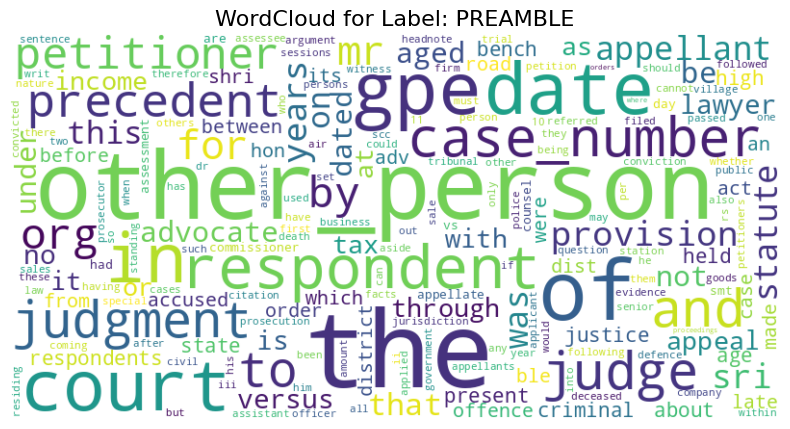

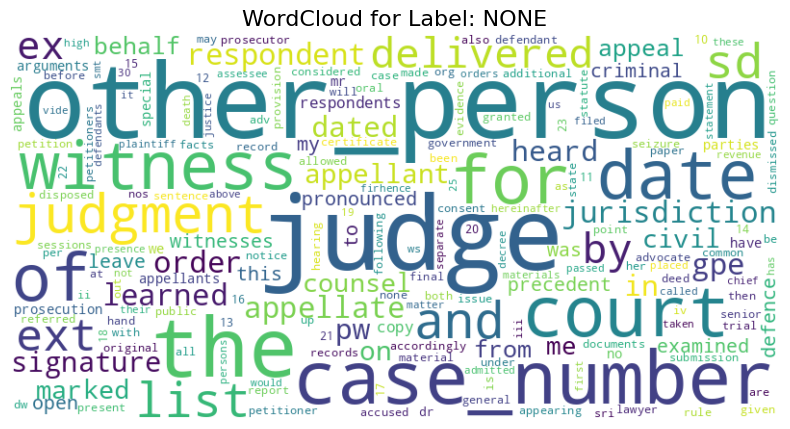

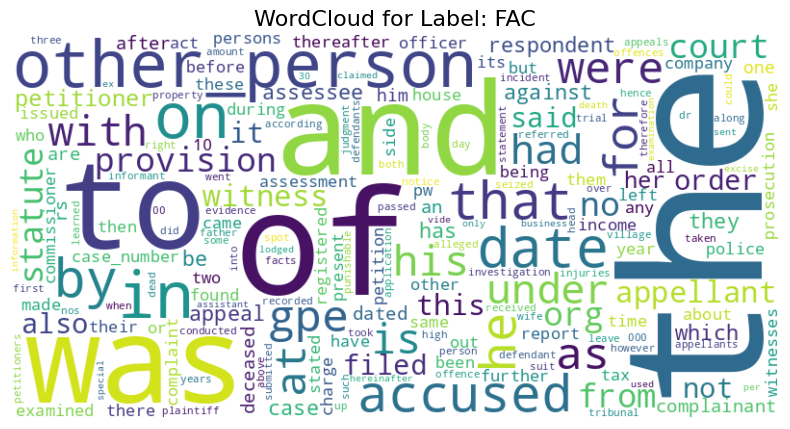

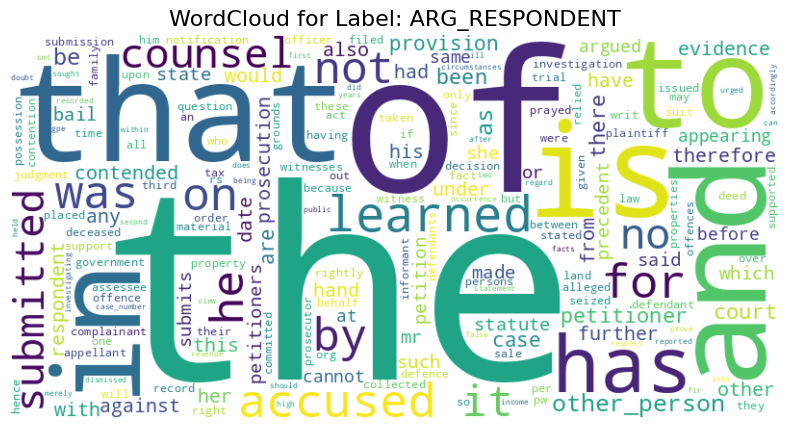

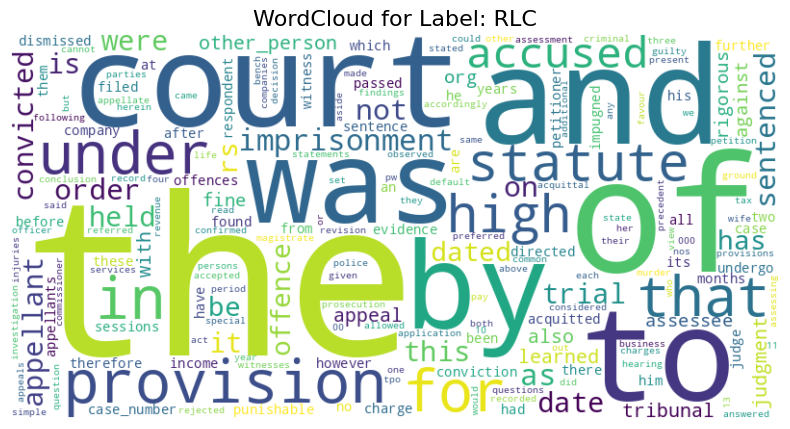

...

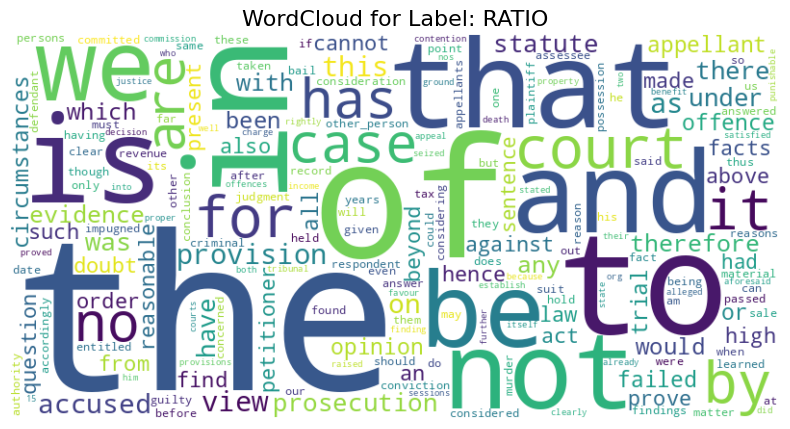

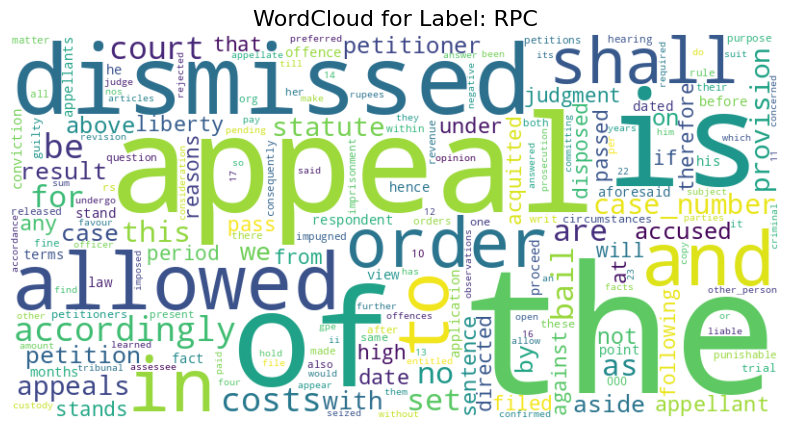

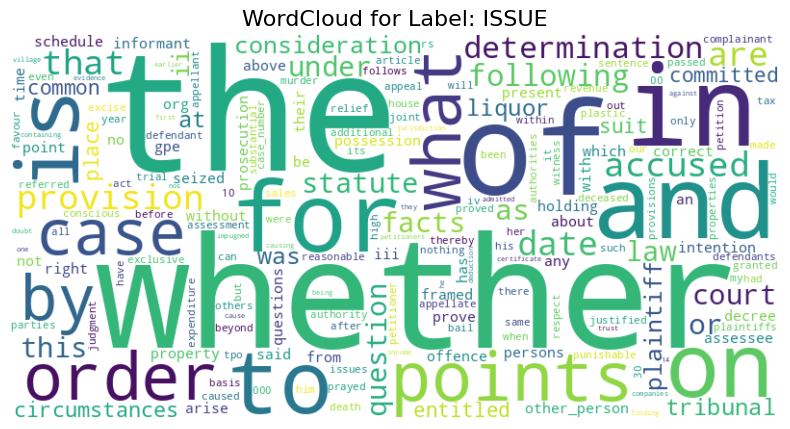

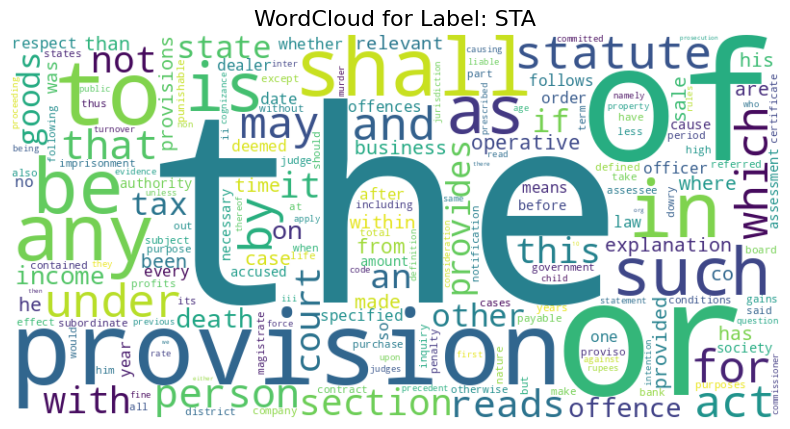

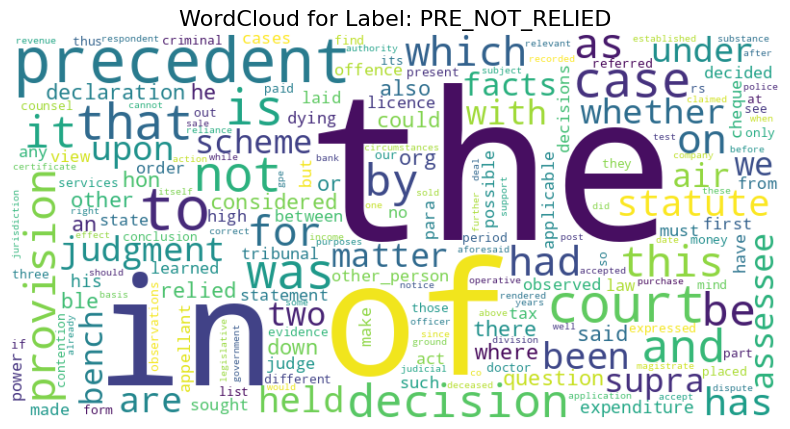

In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from wordcloud import WordCloud
import matplotlib.pyplot as plt

vectorizer = TfidfVectorizer(max_features=1000)

tfidf_matrix = vectorizer.fit_transform(unique_df['new_ner'])
feature_names = vectorizer.get_feature_names_out()

label_word_tfidf = {}

for label in unique_df['labels'].unique():
    label_texts = unique_df[unique_df['labels'] == label]['new_ner']

    label_tfidf_matrix = vectorizer.transform(label_texts)

    label_tfidf_avg = label_tfidf_matrix.mean(axis=0).A1

    label_word_tfidf[label] = {word: label_tfidf_avg[idx] for idx, word in enumerate(feature_names)}

# Function to plot word clouds for each label
def plot_wordcloud(label_word_tfidf):
    for label, word_tfidf in label_word_tfidf.items():
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_tfidf)

        # Plot the WordCloud for each label
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'WordCloud for Label: {label}', fontsize=16)
        plt.show()

# Generate and display the word clouds for each label
plot_wordcloud(label_word_tfidf)


In [ ]:
import json
print(json.dumps(label_word_tfidf, indent=4))

{
    "PREAMBLE": {
        "00": 0.0006568294490317616,
        "000": 0.0009880810578117203,
        "10": 0.0022797714960301318,
        "11": 0.002506487716338799,
        "12": 0.001983821160309518,
        "13": 0.0013779073474474162,
        "14": 0.0009610276718478577,
        "15": 0.0005945400672768846,
        "16": 0.0010511214264881826,
        "17": 0.0007356222234084328,
        "18": 0.0007212158552956301,
        "19": 0.0006715733303541151,
        "1st": 0.0013177768275635926,
        "20": 0.0010487483321513836,
        "21": 0.0008030013524961835,
        "22": 0.0014081953504249663,
        "23": 0.0010731672284533544,
        "24": 0.0013485261762336378,
        "25": 0.0010288346041889235,
        "26": 0.0013288141288300417,
        "27": 0.0012326690424630472,
        "30": 0.0012203609576801183,
        "34": 0.0020467057311189564,
        "50": 0.0014481785460115479,
        "about": 0.009992608601556804,
        "above": 0.000263819585145669,
        "absen

In [ ]:
from collections import defaultdict

# Get the top words for each label based on their TF-IDF scores
def get_discriminative_words(label_word_tfidf, top_n=10):
    discriminative_words = defaultdict(list)

    # Iterate over each label and its corresponding word-TF-IDF dictionary
    for label, word_tfidf in label_word_tfidf.items():
        # Sort words by their TF-IDF score in descending order
        sorted_words = sorted(word_tfidf.items(), key=lambda x: x[1], reverse=True)
        # Get top N words for this label
        discriminative_words[label] = sorted_words[:top_n]

    return discriminative_words

# Get top 10 discriminative words per label
top_discriminative_words = get_discriminative_words(label_word_tfidf, top_n=10)

# Print results
for label, words in top_discriminative_words.items():
    print(f"Top {len(words)} discriminative words for label {label}:")
    for word, tfidf_score in words:
        print(f"  {word}: {tfidf_score:.4f}")

Top 10 discriminative words for label PREAMBLE:
  the: 0.0932
  other_person: 0.0729
  of: 0.0541
  gpe: 0.0416
  date: 0.0403
  court: 0.0396
  in: 0.0369
  respondent: 0.0363
  case_number: 0.0348
  judge: 0.0317
Top 10 discriminative words for label NONE:
  other_person: 0.1180
  judge: 0.1139
  the: 0.0685
  case_number: 0.0599
  court: 0.0532
  date: 0.0498
  for: 0.0496
  witness: 0.0479
  of: 0.0463
  judgment: 0.0426
Top 10 discriminative words for label FAC:
  the: 0.1646
  of: 0.0836
  and: 0.0630
  to: 0.0578
  was: 0.0569
  other_person: 0.0498
  in: 0.0495
  on: 0.0467
  date: 0.0358
  by: 0.0334
Top 10 discriminative words for label ARG_RESPONDENT:
  the: 0.1856
  of: 0.0882
  that: 0.0721
  is: 0.0617
  and: 0.0603
  to: 0.0585
  in: 0.0528
  has: 0.0457
  learned: 0.0447
  for: 0.0408
Top 10 discriminative words for label RLC:
  the: 0.1990
  of: 0.0912
  and: 0.0631
  court: 0.0599
  to: 0.0595
  by: 0.0500
  was: 0.0486
  provision: 0.0471
  in: 0.0463
  for: 0.0446
T

In [ ]:
def get_common_words_across_labels(label_word_tfidf, threshold=0.1):
    word_occurrences = defaultdict(list)

    # Check each word's TF-IDF score across all labels
    for label, word_tfidf in label_word_tfidf.items():
        for word, tfidf_score in word_tfidf.items():
            if tfidf_score > threshold:
                word_occurrences[word].append((label, tfidf_score))

    # Filter words that appear in more than one label
    common_words = {word: occurrences for word, occurrences in word_occurrences.items() if len(occurrences) > 1}

    return common_words

# Get common words that have high TF-IDF scores across labels (e.g., threshold of 0.1)
common_words = get_common_words_across_labels(label_word_tfidf, threshold=0.01)

# Print results
print(f"Common/confusing words across labels:")
for word, occurrences in common_words.items():
    print(f"Word: {word}")
    for label, score in occurrences:
        print(f"  Label {label}: {score:.4f}")


Common/confusing words across labels:
Word: and
  Label PREAMBLE: 0.0314
  Label NONE: 0.0383
  Label FAC: 0.0630
  Label ARG_RESPONDENT: 0.0603
  Label RLC: 0.0631
  Label ARG_PETITIONER: 0.0580
  Label ANALYSIS: 0.0533
  Label PRE_RELIED: 0.0516
  Label RATIO: 0.0507
  Label RPC: 0.0492
  Label ISSUE: 0.0618
  Label STA: 0.0432
  Label PRE_NOT_RELIED: 0.0423
Word: appeal
  Label PREAMBLE: 0.0111
  Label NONE: 0.0125
  Label FAC: 0.0125
  Label RLC: 0.0187
  Label RPC: 0.0716
  Label ISSUE: 0.0114
Word: appellant
  Label PREAMBLE: 0.0179
  Label NONE: 0.0169
  Label FAC: 0.0183
  Label RLC: 0.0226
  Label ARG_PETITIONER: 0.0184
  Label ANALYSIS: 0.0111
  Label RATIO: 0.0157
  Label RPC: 0.0165
Word: as
  Label PREAMBLE: 0.0107
  Label FAC: 0.0256
  Label ARG_RESPONDENT: 0.0277
  Label RLC: 0.0295
  Label ARG_PETITIONER: 0.0312
  Label ANALYSIS: 0.0306
  Label PRE_RELIED: 0.0361
  Label RATIO: 0.0302
  Label RPC: 0.0285
  Label ISSUE: 0.0281
  Label STA: 0.0475
  Label PRE_NOT_RELIED: 

##### Stopwords intact

In [ ]:
from collections import defaultdict
from sklearn.feature_extraction.text import TfidfVectorizer

import pandas as pd
# unique_df = pd.read_csv('/content/drive/MyDrive/NER_masked_dataset.csv')
# unique_df.head()


vectorizer = TfidfVectorizer(
    max_features=1000,
    #min_df=2,  # Only consider words that appear in at least 2 documents
    #max_df=0.90,  # Ignore words that appear in more than 90% of the documents
    ngram_range=(2, 3)  # Capture unigrams and bigrams
)

# Fit and transform the text data
tfidf_matrix = vectorizer.fit_transform(unique_df['new_ner'])
feature_names = vectorizer.get_feature_names_out()

# label_word_tfidf_stop = {}

# for label in unique_df['labels'].unique():
#     label_texts = unique_df[unique_df['labels'] == label]['new_ner']

#     label_tfidf_matrix = vectorizer.transform(label_texts)

#     label_tfidf_avg = label_tfidf_matrix.mean(axis=0).A1

#     label_word_tfidf_stop[label] = {word: label_tfidf_avg[idx] for idx, word in enumerate(feature_names)}


# Find highly discriminative words for each label
def get_highly_discriminative_words(label_word_tfidf, min_ratio=5, top_n=20):
    discriminative_words = defaultdict(list)

    # Iterate through each label
    for label, word_tfidf in label_word_tfidf.items():
        for word, tfidf_score in word_tfidf.items():
            # Get the maximum TF-IDF score of this word in all other labels
            max_other_tfidf = max(
                [label_word_tfidf[other_label].get(word, 0) for other_label in label_word_tfidf if other_label != label]
            )

            # Check if the word's TF-IDF score in this label is significantly higher than in others
            if max_other_tfidf == 0 or (tfidf_score / max_other_tfidf) > min_ratio:
                # If the ratio of TF-IDF scores is greater than the threshold, we consider it discriminative
                discriminative_words[label].append((word, tfidf_score))

        # Sort the discriminative words by their TF-IDF score within the label
        discriminative_words[label] = sorted(discriminative_words[label], key=lambda x: x[1], reverse=True)[:top_n]

    return discriminative_words

# Get top 20 highly discriminative words per label, min_ratio defines how distinct the word should be compared to others
highly_discriminative_words = get_highly_discriminative_words(label_word_tfidf_stop, min_ratio=10, top_n=20)

# Print the highly discriminative words for each label
for label, words in highly_discriminative_words.items():
    print(f"Top {len(words)} highly discriminative words for label {label}:")
    for word, tfidf_score in words:
        print(f"  {word}: {tfidf_score:.4f}")


Top 4 highly discriminative words for label PREAMBLE:
  aged about: 0.0209
  by sri: 0.0128
  bench judge: 0.0101
  sri lawyer: 0.0091
Top 8 highly discriminative words for label NONE:
  list of: 0.0439
  other_person for: 0.0361
  other_person for the: 0.0337
  and other_person for: 0.0230
  signature of: 0.0197
  the court was: 0.0175
  ext signature: 0.0142
  ext signature of: 0.0140
Top 0 highly discriminative words for label FAC:
Top 0 highly discriminative words for label ARG_RESPONDENT:
Top 0 highly discriminative words for label RLC:
Top 0 highly discriminative words for label ARG_PETITIONER:
Top 0 highly discriminative words for label ANALYSIS:
Top 0 highly discriminative words for label PRE_RELIED:
Top 0 highly discriminative words for label RATIO:
Top 1 highly discriminative words for label RPC:
  the result: 0.0238
Top 4 highly discriminative words for label ISSUE:
  whether the: 0.1124
  whether on: 0.0599
  on the facts: 0.0232
  the circumstances of: 0.0199
Top 0 highly 

In [ ]:
# Function to find discriminative words for a specific label with ratio comparison across other labels
def find_discriminative_words_for_label(selected_label, label_word_tfidf, ratio_threshold=5):
    """
    Finds words whose TF-IDF in the selected label is 'ratio_threshold' times higher than their TF-IDF in other labels.

    Args:
    - selected_label: the label for which to find discriminative words
    - label_word_tfidf: a dictionary with TF-IDF values for each word in each label
    - ratio_threshold: the minimum ratio of TF-IDF in selected label compared to other labels

    Returns:
    - discriminative_words: a list of (word, tfidf_value_in_label, {other_labels_tfidf})
    """
    discriminative_words = []

    # Check if the selected label has any TF-IDF values
    if selected_label not in label_word_tfidf:
        print(f"Label '{selected_label}' not found in TF-IDF dictionary.")
        return discriminative_words

    selected_label_tfidf = label_word_tfidf[selected_label]

    # Get list of all other labels except the selected one
    other_labels = [label for label in label_word_tfidf if label != selected_label]

    for word, tfidf_value in selected_label_tfidf.items():
        # Only consider words with a non-zero TF-IDF in the selected label
        if tfidf_value > 0:
            is_discriminative = True
            tfidf_across_other_labels = {}

            for other_label in other_labels:
                other_label_tfidf_value = label_word_tfidf[other_label].get(word, 0.0)
                tfidf_across_other_labels[other_label] = other_label_tfidf_value

                # If word is present in other label with comparable TF-IDF, it's not discriminative
                if other_label_tfidf_value > 0 and tfidf_value / other_label_tfidf_value < ratio_threshold:
                    is_discriminative = False
                    break

            if is_discriminative:
                discriminative_words.append((word, tfidf_value, tfidf_across_other_labels))

    return discriminative_words

# Function to display discriminative words for a selected label
def display_discriminative_words(selected_label, label_word_tfidf, ratio_threshold=5, top_n=4):
    discriminative_words = find_discriminative_words_for_label(selected_label, label_word_tfidf, ratio_threshold)

    # Sort words by TF-IDF value in the selected label
    discriminative_words = sorted(discriminative_words, key=lambda x: x[1], reverse=True)[:top_n]

    # Display the results
    print(f"Top {top_n} highly discriminative words for label '{selected_label}':")

    for word, tfidf_value, tfidf_across_other_labels in discriminative_words:
        other_labels_tfidf_str = ', '.join([f"{label}: {tfidf:.4f}" for label, tfidf in tfidf_across_other_labels.items()])
        print(f"  {word}: {tfidf_value:.4f} [{other_labels_tfidf_str}]")

    print("\n")

# Example usage
selected_label = "PRE_NOT_RELIED"  # You can dynamically select this
display_discriminative_words(selected_label, label_word_tfidf_stop, ratio_threshold=5, top_n=10)

for x in label_word_tfidf.keys():
    display_discriminative_words(x, label_word_tfidf_stop, ratio_threshold=10, top_n=20)

Top 10 highly discriminative words for label 'PRE_NOT_RELIED':


Top 20 highly discriminative words for label 'PREAMBLE':
  aged about: 0.0209 [NONE: 0.0004, FAC: 0.0002, ARG_RESPONDENT: 0.0000, RLC: 0.0004, ARG_PETITIONER: 0.0003, ANALYSIS: 0.0002, PRE_RELIED: 0.0000, RATIO: 0.0007, RPC: 0.0001, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0000]
  by sri: 0.0128 [NONE: 0.0000, FAC: 0.0001, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0005, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0003, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0000]
  bench judge: 0.0101 [NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0009, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0000]
  sri lawyer: 0.0091 [NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0

In [ ]:
import csv
import json

def display_discriminative_words(selected_label, label_word_tfidf, ratio_threshold=5, top_n=4):
    discriminative_words = find_discriminative_words_for_label(selected_label, label_word_tfidf, ratio_threshold)
    discriminative_words = sorted(discriminative_words, key=lambda x: x[1], reverse=True)[:top_n]
    return discriminative_words


discriminative_word_data = []
for x in label_word_tfidf.keys():
    top_discriminative_words = display_discriminative_words(x, label_word_tfidf, ratio_threshold=5, top_n=20)
    for word, tfidf_value, tfidf_across_other_labels in top_discriminative_words:
        discriminative_word_data.append({
            "label": x,
            "word": word,
            "tfidf_value": tfidf_value,
            "tfidf_across_other_labels": tfidf_across_other_labels
        })

!mkdir -p /content/drive/MyDrive/DiscriminativeWords_StopwordsAlso
with open('/content/drive/MyDrive/DiscriminativeWords_StopwordsAlso/stop_discriminative_words_ratio5.csv', 'w', newline='', encoding='utf-8') as csvfile:
    fieldnames = ['label', 'word', 'tfidf_value', 'tfidf_across_other_labels']
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    writer.writeheader()
    writer.writerows(discriminative_word_data)

with open('/content/drive/MyDrive/DiscriminativeWords_StopwordsAlso/stop_discriminative_words_ratio5json.json', 'w', encoding='utf-8') as jsonfile:
    json.dump(discriminative_word_data, jsonfile, indent=4)

print("Discriminative word data saved to 'discriminative_words.csv' and 'discriminative_words.json'")

Discriminative word data saved to 'discriminative_words.csv' and 'discriminative_words.json'


In [ ]:
label_word_tfidf

{'PREAMBLE': {'00 000': 0.0003117053032061067,
  '00 pm': 0.0,
  '000 and': 9.138391413685304e-05,
  '000 in': 5.26868911454238e-05,
  '000 rupees': 0.0,
  '000 to': 0.00011137301247200701,
  '10 00': 2.084583526205359e-05,
  '10 000': 2.0250832358825718e-05,
  '10 in': 0.00016793723251512993,
  '10 the': 0.00012919465547827285,
  '11 the': 3.072802716749163e-05,
  '1st defendant': 0.0,
  '1st respondent': 3.607459208716777e-05,
  '34 to': 0.0010707621182462752,
  '34 to 37': 0.0009232538590264529,
  '3rd defendant': 0.0,
  '50 000': 0.00015566891511082493,
  'able to': 9.952375550949638e-05,
  'about 00': 3.7778341448056864e-05,
  'about 10': 0.00014783109861395577,
  'about 30': 0.00054463248641719,
  'about the': 0.00024729206714718373,
  'above discussion': 0.0,
  'above said': 0.0,
  'above the': 0.0,
  'absence of': 0.000369734786916733,
  'absence of any': 7.303123826631075e-05,
  'absolute owner': 0.0,
  'abuse of': 0.00010958510835964641,
  'accept the': 0.00024703730501117666

In [ ]:
label_word_tfidf_stop

{'PREAMBLE': {'00 000': 0.0004316484240722585,
  'about the': 0.00036645324190021946,
  'absence of': 0.0005375747090082605,
  'accordance with': 0.0005934624118290092,
  'according to': 0.0012887865995477258,
  'according to the': 0.0004392555398205499,
  'account of': 0.0009380419095392571,
  'accused and': 0.00047008273317087197,
  'accused in': 0.0006966296945850833,
  'accused is': 0.0007852292141358856,
  'accused no': 0.00035251430054263256,
  'accused nos': 0.0005500247623624547,
  'accused nos and': 0.0002057549431477421,
  'accused other_person': 0.00027755754689808736,
  'accused persons': 0.001983631220569632,
  'accused to': 0.00021571858440314764,
  'accused was': 0.0005606573313388561,
  'act of': 0.00015772890880446123,
  'after the': 0.0014875719876396407,
  'against the': 0.003273035003160068,
  'against the accused': 0.00039897913419536634,
  'aged about': 0.020852950844608066,
  'all the': 0.0015282717455260223,
  'along with': 0.0013588437890514342,
  'also the': 0

##### Label wise word cloud TF-IDF (Stopwords Removed)

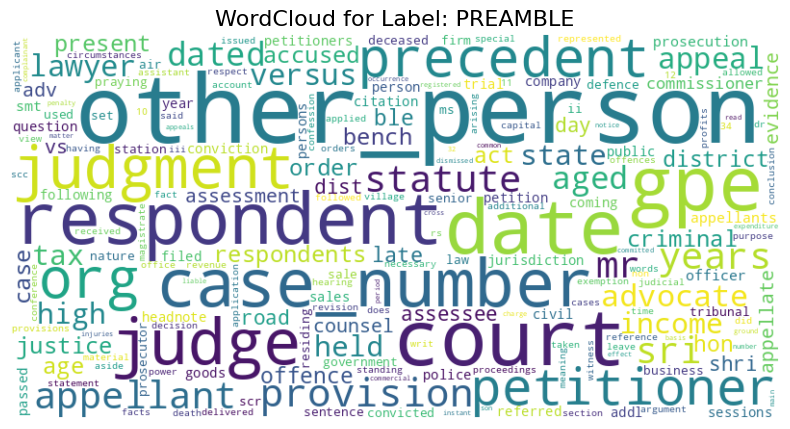

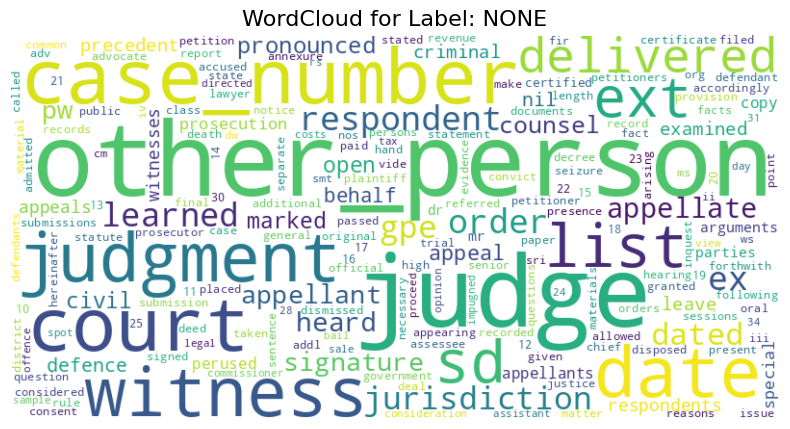

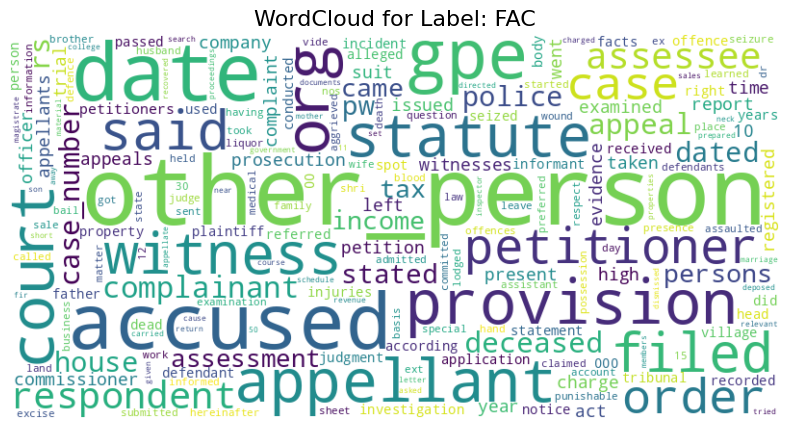

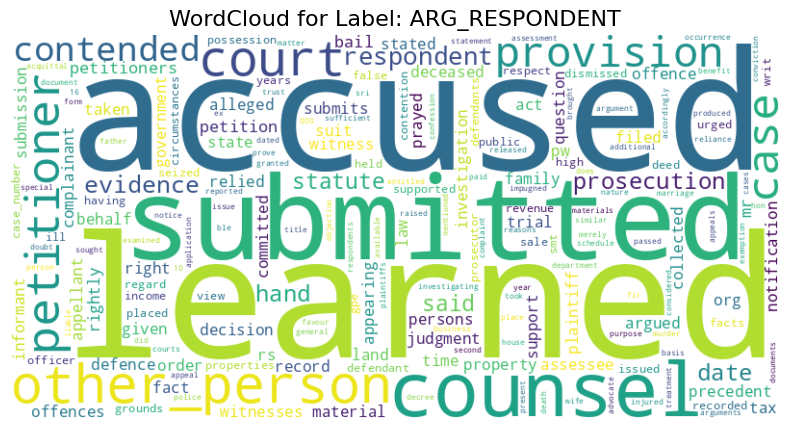

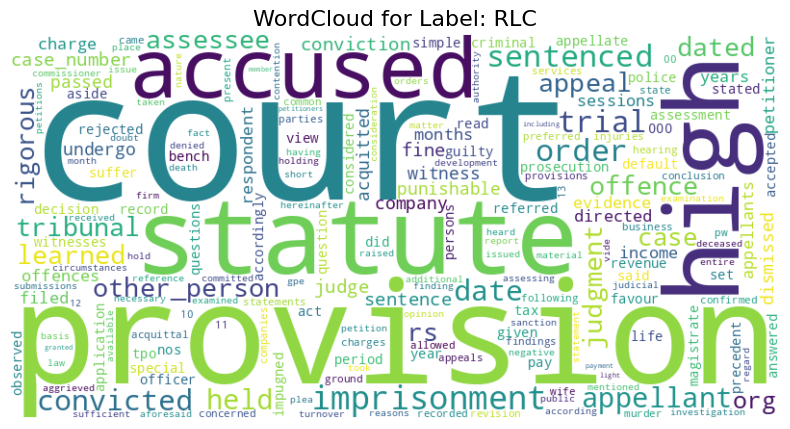

...

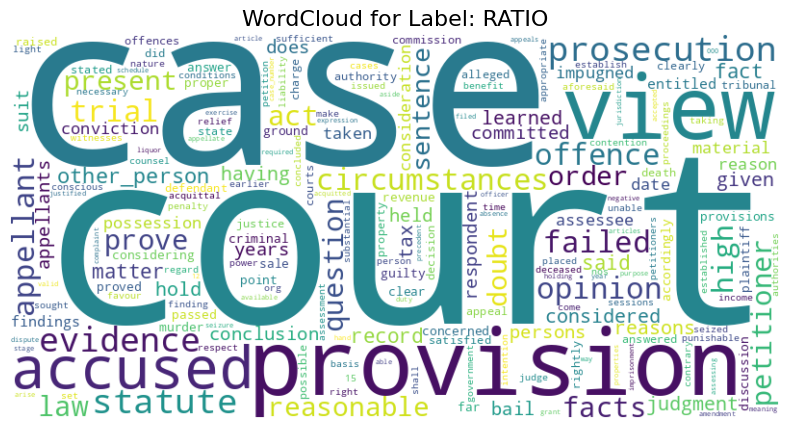

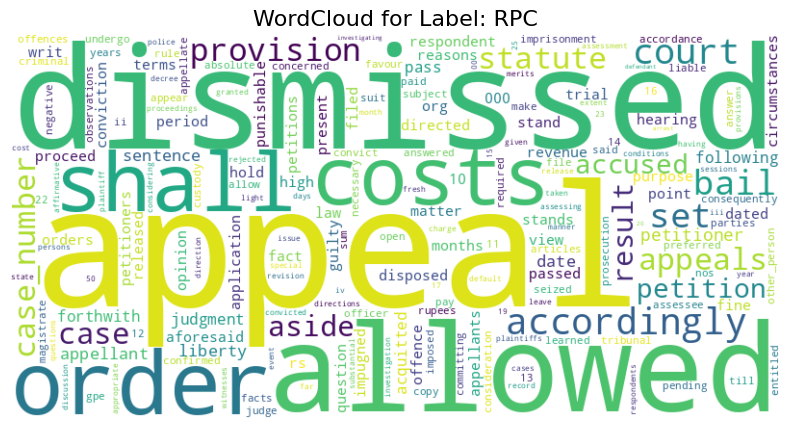

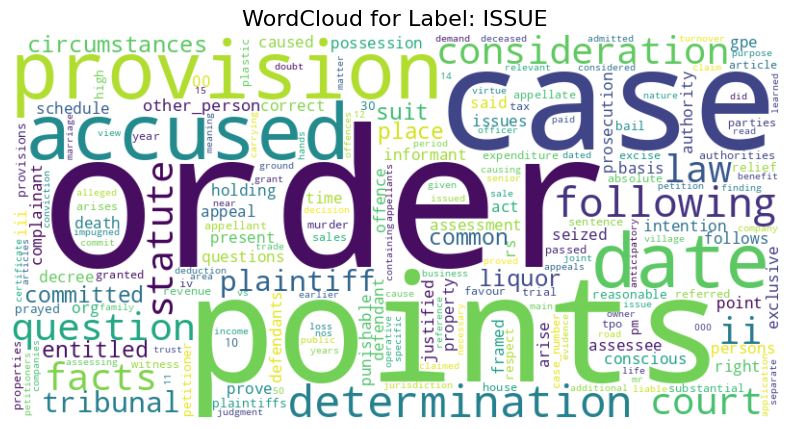

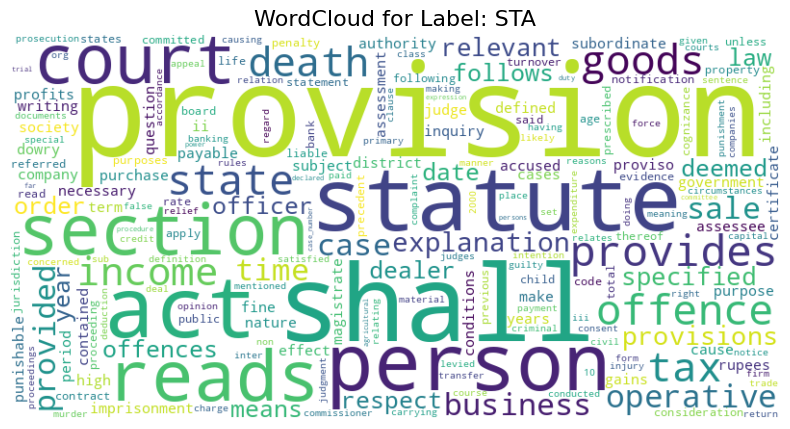

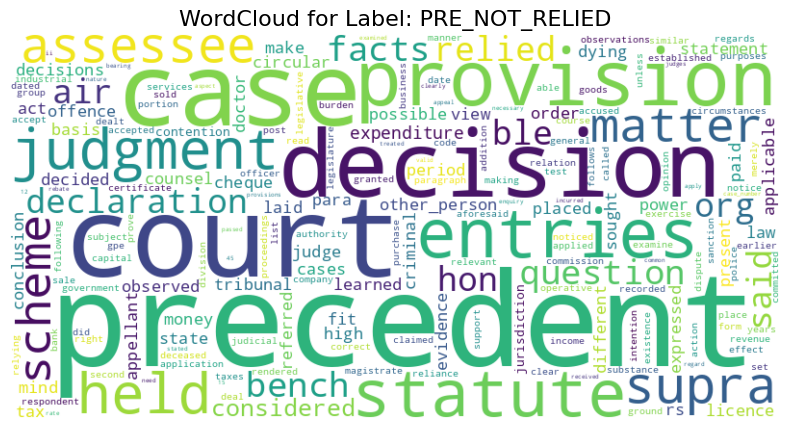

In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from wordcloud import WordCloud
import matplotlib.pyplot as plt

vectorizer = TfidfVectorizer(max_features=1000,stop_words='english')

tfidf_matrix = vectorizer.fit_transform(unique_df['new_ner'])
feature_names = vectorizer.get_feature_names_out()

label_word_tfidf = {}

for label in unique_df['labels'].unique():
    label_texts = unique_df[unique_df['labels'] == label]['new_ner']

    label_tfidf_matrix = vectorizer.transform(label_texts)

    label_tfidf_avg = label_tfidf_matrix.mean(axis=0).A1

    label_word_tfidf[label] = {word: label_tfidf_avg[idx] for idx, word in enumerate(feature_names)}

# Function to plot word clouds for each label
def plot_wordcloud(label_word_tfidf):
    for label, word_tfidf in label_word_tfidf.items():
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_tfidf)

        # Plot the WordCloud for each label
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'WordCloud for Label: {label}', fontsize=16)
        plt.show()

# Generate and display the word clouds for each label
plot_wordcloud(label_word_tfidf)


In [ ]:
import json
print(json.dumps(label_word_tfidf, indent=4))

{
    "PREAMBLE": {
        "00": 0.0007802194174057105,
        "000": 0.0011781383180498274,
        "07": 0.0009600480570124084,
        "08": 0.00100662528834255,
        "10": 0.0024749716440428623,
        "11": 0.0026767864768719877,
        "12": 0.0021063080309554486,
        "13": 0.0014486914171714018,
        "14": 0.001002718594479173,
        "15": 0.0006480014643505188,
        "16": 0.001102450787796308,
        "17": 0.0007987719117545481,
        "18": 0.0007622496827402985,
        "19": 0.0007115132135955648,
        "1st": 0.0013798448255241613,
        "20": 0.0011316827976603613,
        "2000": 0.00017412408666903512,
        "21": 0.0008489660165211671,
        "22": 0.0015389360850163924,
        "23": 0.0011076168836727273,
        "24": 0.0014108818479619501,
        "25": 0.001123734696934016,
        "26": 0.0013975062607514861,
        "27": 0.0013464150980155346,
        "28": 0.0015727721285039322,
        "30": 0.001290338599910986,
        "31": 0.001

In [ ]:
from collections import defaultdict

# Get the top words for each label based on their TF-IDF scores
def get_discriminative_words(label_word_tfidf, top_n=10):
    discriminative_words = defaultdict(list)

    # Iterate over each label and its corresponding word-TF-IDF dictionary
    for label, word_tfidf in label_word_tfidf.items():
        # Sort words by their TF-IDF score in descending order
        sorted_words = sorted(word_tfidf.items(), key=lambda x: x[1], reverse=True)
        # Get top N words for this label
        discriminative_words[label] = sorted_words[:top_n]

    return discriminative_words

# Get top 10 discriminative words per label
top_discriminative_words = get_discriminative_words(label_word_tfidf, top_n=10)

# Print results
for label, words in top_discriminative_words.items():
    print(f"Top {len(words)} discriminative words for label {label}:")
    for word, tfidf_score in words:
        print(f"  {word}: {tfidf_score:.4f}")

Top 10 discriminative words for label PREAMBLE:
  other_person: 0.0744
  court: 0.0472
  date: 0.0433
  gpe: 0.0430
  respondent: 0.0391
  case_number: 0.0363
  judge: 0.0331
  judgment: 0.0308
  org: 0.0276
  precedent: 0.0273
Top 10 discriminative words for label NONE:
  other_person: 0.1252
  judge: 0.1169
  case_number: 0.0624
  court: 0.0598
  date: 0.0538
  judgment: 0.0488
  witness: 0.0481
  list: 0.0367
  sd: 0.0356
  ext: 0.0313
Top 10 discriminative words for label FAC:
  other_person: 0.0619
  date: 0.0425
  accused: 0.0396
  gpe: 0.0303
  provision: 0.0247
  court: 0.0243
  org: 0.0242
  appellant: 0.0228
  statute: 0.0227
  witness: 0.0209
Top 10 discriminative words for label ARG_RESPONDENT:
  learned: 0.0534
  accused: 0.0506
  submitted: 0.0386
  counsel: 0.0376
  other_person: 0.0358
  court: 0.0300
  petitioner: 0.0279
  case: 0.0256
  provision: 0.0248
  contended: 0.0233
Top 10 discriminative words for label RLC:
  court: 0.0713
  provision: 0.0568
  statute: 0.044

In [ ]:
def get_common_words_across_labels(label_word_tfidf, threshold=0.1):
    word_occurrences = defaultdict(list)

    # Check each word's TF-IDF score across all labels
    for label, word_tfidf in label_word_tfidf.items():
        for word, tfidf_score in word_tfidf.items():
            if tfidf_score > threshold:
                word_occurrences[word].append((label, tfidf_score))

    # Filter words that appear in more than one label
    common_words = {word: occurrences for word, occurrences in word_occurrences.items() if len(occurrences) > 1}

    return common_words

# Get common words that have high TF-IDF scores across labels (e.g., threshold of 0.1)
common_words = get_common_words_across_labels(label_word_tfidf, threshold=0.001)

# Print results
print(f"Common/confusing words across labels:")
for word, occurrences in common_words.items():
    print(f"Word: {word}")
    for label, score in occurrences:
        print(f"  Label {label}: {score:.4f}")


Streaming output truncated to the last 5000 lines.
  Label FAC: 0.0029
  Label RLC: 0.0089
  Label ARG_PETITIONER: 0.0013
  Label ANALYSIS: 0.0019
  Label PRE_RELIED: 0.0041
  Label RATIO: 0.0020
  Label RPC: 0.0016
  Label ISSUE: 0.0047
  Label STA: 0.0072
  Label PRE_NOT_RELIED: 0.0052
Word: reason
  Label PREAMBLE: 0.0015
  Label FAC: 0.0013
  Label ARG_RESPONDENT: 0.0038
  Label RLC: 0.0011
  Label ARG_PETITIONER: 0.0047
  Label ANALYSIS: 0.0045
  Label PRE_RELIED: 0.0033
  Label RATIO: 0.0086
  Label STA: 0.0032
  Label PRE_NOT_RELIED: 0.0042
Word: reasonable
  Label PREAMBLE: 0.0010
  Label ARG_RESPONDENT: 0.0030
  Label RLC: 0.0024
  Label ARG_PETITIONER: 0.0018
  Label ANALYSIS: 0.0027
  Label PRE_RELIED: 0.0050
  Label RATIO: 0.0154
  Label ISSUE: 0.0099
  Label STA: 0.0028
Word: rebate
  Label PREAMBLE: 0.0017
  Label ANALYSIS: 0.0013
  Label ISSUE: 0.0017
  Label PRE_NOT_RELIED: 0.0046
Word: receipt
  Label PREAMBLE: 0.0011
  Label FAC: 0.0025
  Label ARG_RESPONDENT: 0.0011


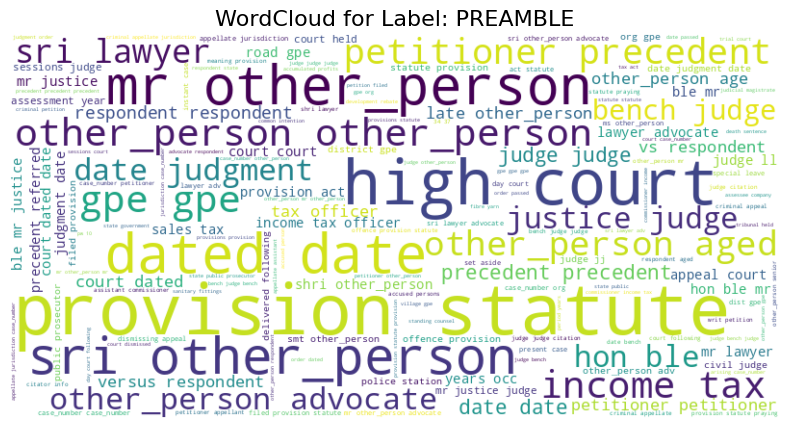

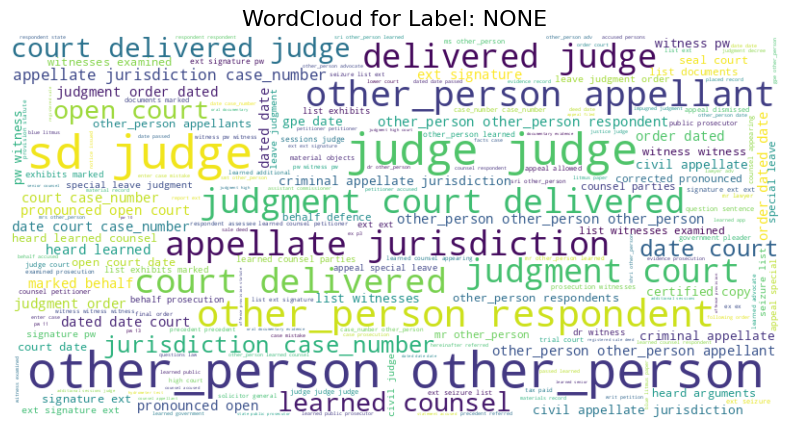

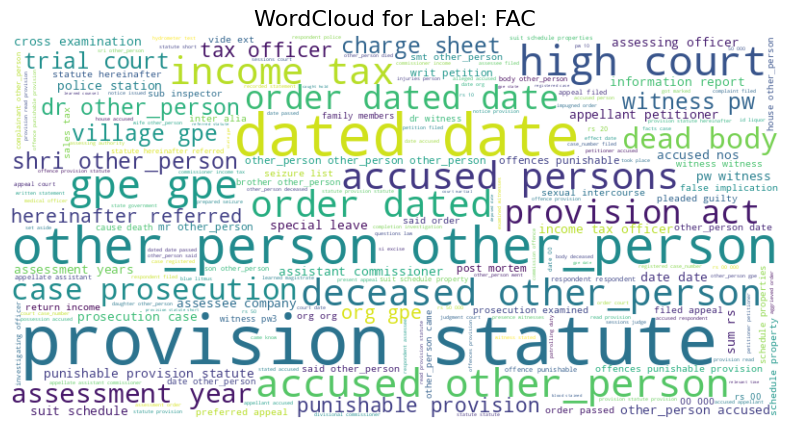

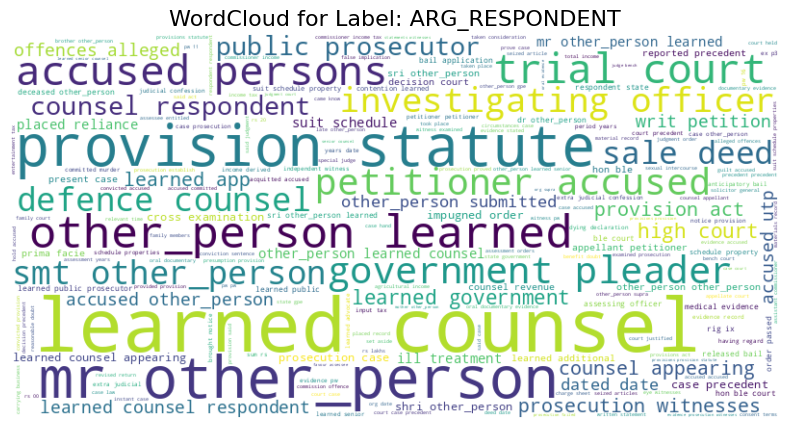

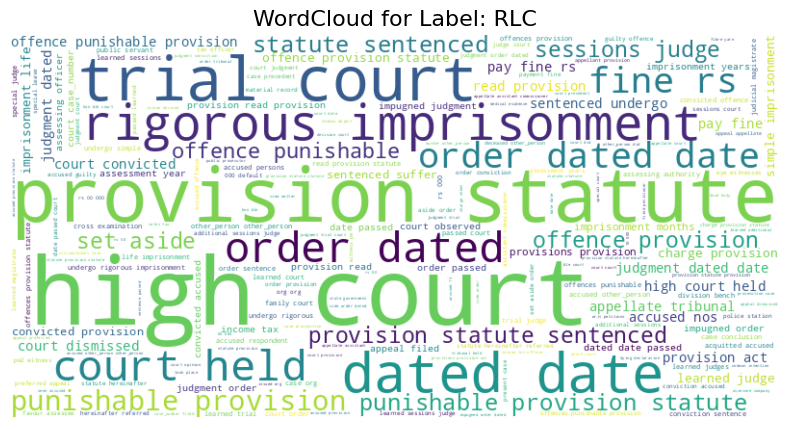

...

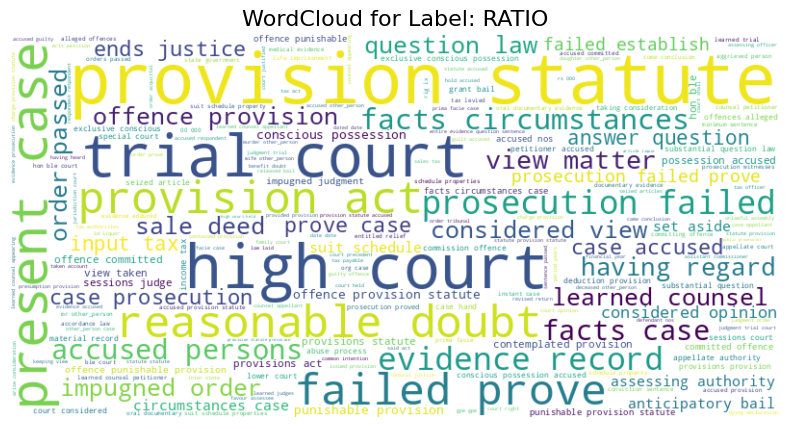

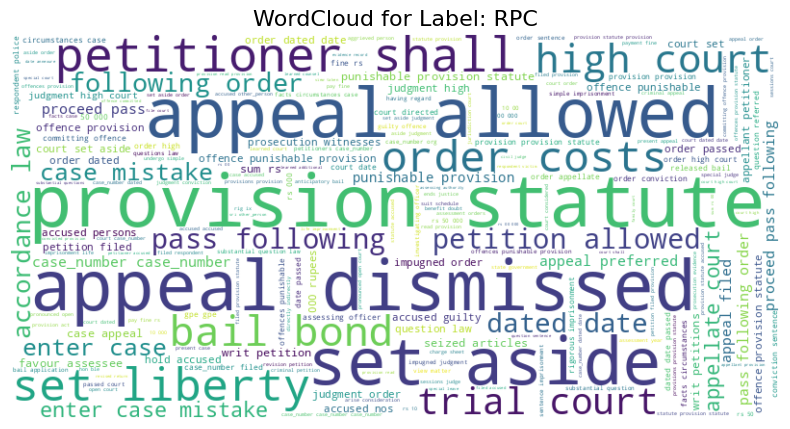

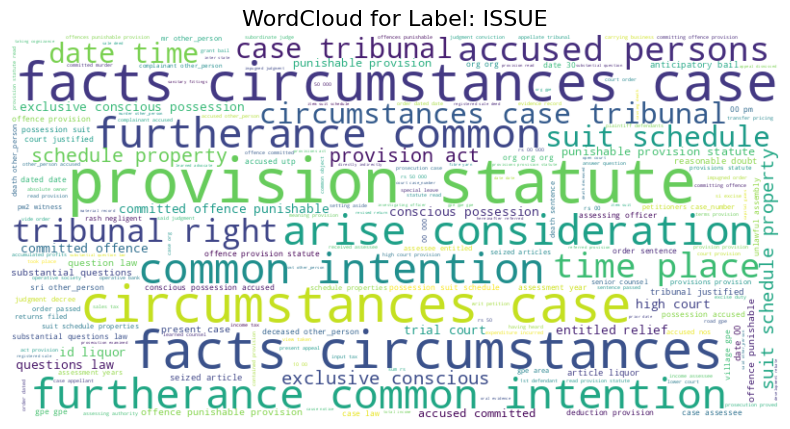

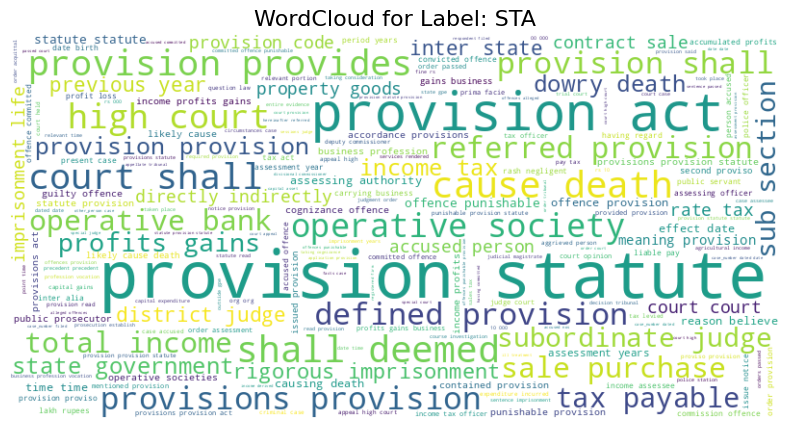

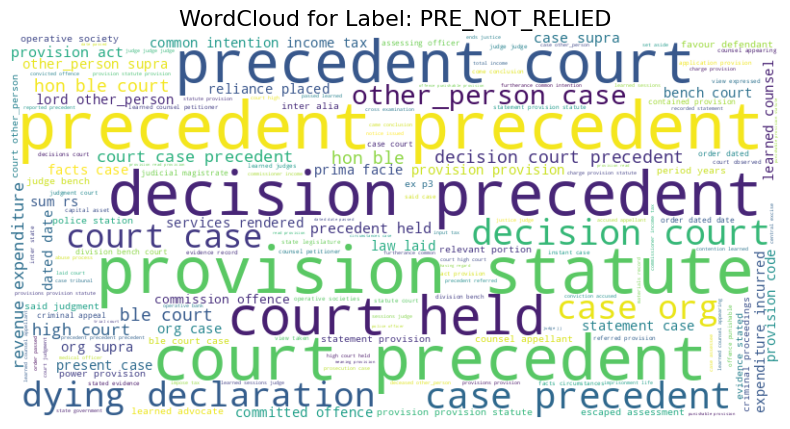

In [ ]:
vectorizer = TfidfVectorizer(
    stop_words='english',
    max_features=1000,
    #min_df=2,  # Only consider words that appear in at least 2 documents
    max_df=0.90,  # Ignore words that appear in more than 90% of the documents
    ngram_range=(2, 3)  # Capture unigrams and bigrams
)

# Fit and transform the text data
tfidf_matrix = vectorizer.fit_transform(unique_df['new_ner'])
feature_names = vectorizer.get_feature_names_out()

label_word_tfidf = {}

for label in unique_df['labels'].unique():
    label_texts = unique_df[unique_df['labels'] == label]['new_ner']

    label_tfidf_matrix = vectorizer.transform(label_texts)

    label_tfidf_avg = label_tfidf_matrix.mean(axis=0).A1

    label_word_tfidf[label] = {word: label_tfidf_avg[idx] for idx, word in enumerate(feature_names)}

# Function to plot word clouds for each label
def plot_wordcloud(label_word_tfidf):
    for label, word_tfidf in label_word_tfidf.items():
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_tfidf)

        # Plot the WordCloud for each label
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'WordCloud for Label: {label}', fontsize=16)
        plt.show()

# Generate and display the word clouds for each label
plot_wordcloud(label_word_tfidf)

In [ ]:
print(json.dumps(label_word_tfidf, indent=4))

{
    "PREAMBLE": {
        "00 000": 0.0007021059839799948,
        "00 pm": 0.0,
        "000 default": 7.501654416064134e-05,
        "000 rupees": 0.0,
        "10 00": 4.1048471456014206e-05,
        "10 000": 3.38749279577554e-05,
        "1st defendant": 0.0,
        "1st respondent": 6.0354499813283967e-05,
        "34 37": 0.0023095967823576775,
        "3rd defendant": 0.0,
        "50 000": 0.0002865938822911281,
        "85 000": 0.00025312632240899463,
        "absolute owner": 0.0,
        "abuse process": 7.825931309778976e-05,
        "accordance law": 0.0005044542369287712,
        "accordance provisions": 0.00014876109179027774,
        "accumulated profits": 0.0013931042830401827,
        "accused 13": 0.0,
        "accused accused": 0.0,
        "accused appellant": 0.00013632321197722968,
        "accused assaulted": 0.0,
        "accused committed": 0.0001237576073819802,
        "accused guilty": 0.0001709259995651691,
        "accused nos": 0.0007564297085104519

In [ ]:
from collections import defaultdict

# Get the top words for each label based on their TF-IDF scores
def get_discriminative_words(label_word_tfidf, top_n=10):
    discriminative_words = defaultdict(list)

    # Iterate over each label and its corresponding word-TF-IDF dictionary
    for label, word_tfidf in label_word_tfidf.items():
        # Sort words by their TF-IDF score in descending order
        sorted_words = sorted(word_tfidf.items(), key=lambda x: x[1], reverse=True)
        # Get top N words for this label
        discriminative_words[label] = sorted_words[:top_n]

    return discriminative_words

# Get top 10 discriminative words per label
top_discriminative_words = get_discriminative_words(label_word_tfidf, top_n=10)

# Print results
for label, words in top_discriminative_words.items():
    print(f"Top {len(words)} discriminative words for label {label}:")
    for word, tfidf_score in words:
        print(f"  {word}: {tfidf_score:.4f}")

Top 10 discriminative words for label PREAMBLE:
  provision statute: 0.0235
  high court: 0.0189
  mr other_person: 0.0138
  dated date: 0.0138
  sri other_person: 0.0123
  other_person other_person: 0.0120
  gpe gpe: 0.0117
  income tax: 0.0113
  petitioner precedent: 0.0102
  other_person aged: 0.0098
Top 10 discriminative words for label NONE:
  other_person other_person: 0.0413
  sd judge: 0.0376
  judge judge: 0.0324
  other_person respondent: 0.0221
  other_person appellant: 0.0196
  court delivered: 0.0192
  judgment court delivered: 0.0183
  appellate jurisdiction: 0.0183
  judgment court: 0.0175
  delivered judge: 0.0174
Top 10 discriminative words for label FAC:
  provision statute: 0.0273
  dated date: 0.0190
  other_person other_person: 0.0168
  high court: 0.0102
  gpe gpe: 0.0097
  accused other_person: 0.0091
  accused persons: 0.0087
  income tax: 0.0086
  deceased other_person: 0.0084
  order dated: 0.0084
Top 10 discriminative words for label ARG_RESPONDENT:
  learned

In [ ]:
def get_common_words_across_labels(label_word_tfidf, threshold=0.1):
    word_occurrences = defaultdict(list)

    # Check each word's TF-IDF score across all labels
    for label, word_tfidf in label_word_tfidf.items():
        for word, tfidf_score in word_tfidf.items():
            if tfidf_score > threshold:
                word_occurrences[word].append((label, tfidf_score))

    # Filter words that appear in more than one label
    common_words = {word: occurrences for word, occurrences in word_occurrences.items() if len(occurrences) > 1}

    return common_words

# Get common words that have high TF-IDF scores across labels (e.g., threshold of 0.1)
common_words = get_common_words_across_labels(label_word_tfidf, threshold=0.001)

# Print results
print(f"Common/confusing words across labels:")
for word, occurrences in common_words.items():
    print(f"Word: {word}")
    for label, score in occurrences:
        print(f"  Label {label}: {score:.4f}")


Common/confusing words across labels:
Word: 34 37
  Label PREAMBLE: 0.0023
  Label ARG_PETITIONER: 0.0016
Word: accumulated profits
  Label PREAMBLE: 0.0014
  Label PRE_RELIED: 0.0016
  Label ISSUE: 0.0034
  Label STA: 0.0039
Word: accused offence
  Label PREAMBLE: 0.0010
  Label ARG_RESPONDENT: 0.0014
  Label RLC: 0.0031
  Label PRE_RELIED: 0.0017
  Label RATIO: 0.0013
  Label STA: 0.0041
Word: accused person
  Label PREAMBLE: 0.0021
  Label FAC: 0.0019
  Label ANALYSIS: 0.0019
  Label PRE_RELIED: 0.0031
  Label ISSUE: 0.0012
  Label STA: 0.0081
Word: accused persons
  Label PREAMBLE: 0.0024
  Label NONE: 0.0016
  Label FAC: 0.0087
  Label ARG_RESPONDENT: 0.0147
  Label RLC: 0.0054
  Label ARG_PETITIONER: 0.0051
  Label ANALYSIS: 0.0071
  Label PRE_RELIED: 0.0011
  Label RATIO: 0.0102
  Label RPC: 0.0048
  Label ISSUE: 0.0248
Word: appeal court
  Label PREAMBLE: 0.0053
  Label FAC: 0.0023
  Label RLC: 0.0020
  Label PRE_RELIED: 0.0013
  Label ISSUE: 0.0010
Word: appeal filed
  Label P

In [ ]:
unique_df.head()

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from collections import defaultdict

def get_discriminative_words(df, label_column, text_column, label, n=10, ngram_range=(2, 3), min_ratio=5):
    # Separate the dataset into text data and labels
    label_df = df[df[label_column] == label]

    # Create TF-IDF vectorizer for bigrams and trigrams, and remove English stopwords
    tfidf_vectorizer = TfidfVectorizer(ngram_range=ngram_range, stop_words='english')

    # Fit the TF-IDF model on the whole dataset
    tfidf_matrix = tfidf_vectorizer.fit_transform(df[text_column])
    feature_names = tfidf_vectorizer.get_feature_names_out()

    # Get the tf-idf scores for the label-specific texts
    label_matrix = tfidf_vectorizer.transform(label_df[text_column])

    # Get the average tf-idf score for each word in the label
    label_tfidf_scores = label_matrix.mean(axis=0).A1  # A1 to flatten the matrix

    # Get the average tf-idf scores for each word across other labels
    other_labels_tfidf_scores = defaultdict(list)
    for other_label in df[label_column].unique():
        if other_label != label:
            other_label_df = df[df[label_column] == other_label]
            other_label_matrix = tfidf_vectorizer.transform(other_label_df[text_column])
            other_labels_tfidf_scores[other_label] = other_label_matrix.mean(axis=0).A1

    # Create a dataframe for the label-specific tf-idf scores
    word_scores = []
    for idx, word in enumerate(feature_names):
        word_info = {'word': word, label: label_tfidf_scores[idx]}
        if label_tfidf_scores[idx] > 0:  # Only add words with non-zero tf-idf for the selected label
            max_other_label_tfidf = 0
            for other_label in other_labels_tfidf_scores:
                word_info[other_label] = other_labels_tfidf_scores[other_label][idx]
                # Find the maximum TF-IDF score across the other labels
                max_other_label_tfidf = max(max_other_label_tfidf, other_labels_tfidf_scores[other_label][idx])

            # Check the ratio condition
            if max_other_label_tfidf == 0 or (label_tfidf_scores[idx] / max_other_label_tfidf) >= min_ratio:
                word_scores.append(word_info)

    word_scores_df = pd.DataFrame(word_scores)

    # Sort the words based on the highest tf-idf for the chosen label in descending order
    top_words_df = word_scores_df.sort_values(by=label, ascending=False).head(n)

    # Formatting output as required (excluding the self-label)
    output = f"Top {n} highly discriminative words for label '{label}' (with min_ratio {min_ratio}):\n"
    for _, row in top_words_df.iterrows():
        word = row['word']
        # Exclude the self label from the tf-idf values in the brackets
        tfidf_values = [f"{key}: {row[key]:.4f}" for key in word_scores_df.columns if key not in ['word', label]]
        output += f"  {word}: {row[label]:.4f} [{', '.join(tfidf_values)}]\n"

    return output

label = 'PRE_NOT_RELIED'
output = get_discriminative_words(unique_df, label_column='labels', text_column='new_ner', label=label, n=10, ngram_range=(2, 3))
print(output)


Top 10 highly discriminative words for label 'PRE_NOT_RELIED' (with min_ratio 5):
  case org: 0.0064 [PREAMBLE: 0.0000, NONE: 0.0000, FAC: 0.0001, ARG_RESPONDENT: 0.0000, RLC: 0.0010, ARG_PETITIONER: 0.0001, ANALYSIS: 0.0003, PRE_RELIED: 0.0010, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0010, STA: 0.0000]
  applicable facts: 0.0063 [PREAMBLE: 0.0000, NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0003, RLC: 0.0000, ARG_PETITIONER: 0.0001, ANALYSIS: 0.0001, PRE_RELIED: 0.0003, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000]
  matter touched: 0.0041 [PREAMBLE: 0.0000, NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000]
  quashed hon ble: 0.0040 [PREAMBLE: 0.0000, NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000]
  circular quashe

##### High self TF-IDF, low across others

In [ ]:
from collections import defaultdict
from sklearn.feature_extraction.text import TfidfVectorizer

import pandas as pd
unique_df = pd.read_csv('/content/drive/MyDrive/NER_masked_dataset.csv')
unique_df.head()

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
from collections import defaultdict
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(
    stop_words='english',
    #min_df=2,  # Only consider words that appear in at least 2 documents
    #max_df=0.90,  # Ignore words that appear in more than 90% of the documents
    ngram_range=(2, 3)  # Capture unigrams and bigrams
)

# Fit and transform the text data
tfidf_matrix = vectorizer.fit_transform(unique_df['new_ner'])
feature_names = vectorizer.get_feature_names_out()

label_word_tfidf = {}

# Label wise TF-IDF
for label in unique_df['labels'].unique():
    label_texts = unique_df[unique_df['labels'] == label]['new_ner']

    label_tfidf_matrix = vectorizer.transform(label_texts)

    label_tfidf_avg = label_tfidf_matrix.mean(axis=0).A1

    label_word_tfidf[label] = {word: label_tfidf_avg[idx] for idx, word in enumerate(feature_names)}


# Find highly discriminative words for each label
def get_highly_discriminative_words(label_word_tfidf, min_ratio=5, top_n=20):
    discriminative_words = defaultdict(list)

    # Iterate through each label
    for label, word_tfidf in label_word_tfidf.items():
        for word, tfidf_score in word_tfidf.items():
            # Get the maximum TF-IDF score of this word in all other labels
            max_other_tfidf = max(
                [label_word_tfidf[other_label].get(word, 0) for other_label in label_word_tfidf if other_label != label]
            )

            # Check if the word's TF-IDF score in this label is significantly higher than in others
            if max_other_tfidf == 0 or (tfidf_score / max_other_tfidf) > min_ratio:
                # If the ratio of TF-IDF scores is greater than the threshold, we consider it discriminative
                discriminative_words[label].append((word, tfidf_score))

        # Sort the discriminative words by their TF-IDF score within the label
        discriminative_words[label] = sorted(discriminative_words[label], key=lambda x: x[1], reverse=True)[:top_n]

    return discriminative_words

# Get top 20 highly discriminative words per label, min_ratio defines how distinct the word should be compared to others
highly_discriminative_words = get_highly_discriminative_words(label_word_tfidf, min_ratio=5, top_n=20)

# Print the highly discriminative words for each label
for label, words in highly_discriminative_words.items():
    print(f"Top {len(words)} highly discriminative words for label {label}:")
    for word, tfidf_score in words:
        print(f"  {word}: {tfidf_score:.4f}")


Top 20 highly discriminative words for label PREAMBLE:
  petitioner precedent: 0.0091
  other_person advocate: 0.0056
  justice judge: 0.0048
  date judgment: 0.0047
  court dated: 0.0046
  court dated date: 0.0042
  mr justice: 0.0040
  respondent respondent: 0.0039
  ble mr: 0.0036
  ble mr justice: 0.0036
  hon ble mr: 0.0036
  mr justice judge: 0.0036
  sri lawyer: 0.0036
  judgment date: 0.0036
  other_person aged: 0.0036
  vs respondent: 0.0035
  late other_person: 0.0035
  date judgment date: 0.0031
  versus respondent: 0.0029
  bench judge: 0.0026
Top 20 highly discriminative words for label NONE:
  judge judge: 0.0218
  sd judge: 0.0184
  other_person respondent: 0.0182
  appellate jurisdiction: 0.0171
  court delivered: 0.0171
  other_person appellant: 0.0169
  judgment court delivered: 0.0168
  delivered judge: 0.0163
  court delivered judge: 0.0158
  judgment court: 0.0156
  jurisdiction case_number: 0.0141
  appellate jurisdiction case_number: 0.0140
  date court: 0.0133
 

In [ ]:
# Function to find discriminative words for a specific label with ratio comparison across other labels
def find_discriminative_words_for_label(selected_label, label_word_tfidf, ratio_threshold=5):
    """
    Finds words whose TF-IDF in the selected label is 'ratio_threshold' times higher than their TF-IDF in other labels.

    Args:
    - selected_label: the label for which to find discriminative words
    - label_word_tfidf: a dictionary with TF-IDF values for each word in each label
    - ratio_threshold: the minimum ratio of TF-IDF in selected label compared to other labels

    Returns:
    - discriminative_words: a list of (word, tfidf_value_in_label, {other_labels_tfidf})
    """
    discriminative_words = []

    # Check if the selected label has any TF-IDF values
    if selected_label not in label_word_tfidf:
        print(f"Label '{selected_label}' not found in TF-IDF dictionary.")
        return discriminative_words

    selected_label_tfidf = label_word_tfidf[selected_label]

    # Get list of all other labels except the selected one
    other_labels = [label for label in label_word_tfidf if label != selected_label]

    for word, tfidf_value in selected_label_tfidf.items():
        # Only consider words with a non-zero TF-IDF in the selected label
        if tfidf_value > 0:
            is_discriminative = True
            tfidf_across_other_labels = {}

            for other_label in other_labels:
                other_label_tfidf_value = label_word_tfidf[other_label].get(word, 0.0)
                tfidf_across_other_labels[other_label] = other_label_tfidf_value

                # If word is present in other label with comparable TF-IDF, it's not discriminative
                if other_label_tfidf_value > 0 and tfidf_value / other_label_tfidf_value < ratio_threshold:
                    is_discriminative = False
                    break

            if is_discriminative:
                discriminative_words.append((word, tfidf_value, tfidf_across_other_labels))

    return discriminative_words

# Function to display discriminative words for a selected label
def display_discriminative_words(selected_label, label_word_tfidf, ratio_threshold=5, top_n=4):
    discriminative_words = find_discriminative_words_for_label(selected_label, label_word_tfidf, ratio_threshold)

    # Sort words by TF-IDF value in the selected label
    discriminative_words = sorted(discriminative_words, key=lambda x: x[1], reverse=True)[:top_n]

    # Display the results
    print(f"Top {top_n} highly discriminative words for label '{selected_label}':")

    for word, tfidf_value, tfidf_across_other_labels in discriminative_words:
        other_labels_tfidf_str = ', '.join([f"{label}: {tfidf:.4f}" for label, tfidf in tfidf_across_other_labels.items()])
        print(f"  {word}: {tfidf_value:.4f} [{other_labels_tfidf_str}]")

    print("\n")

# Example usage
selected_label = "PRE_NOT_RELIED"  # You can dynamically select this
display_discriminative_words(selected_label, label_word_tfidf, ratio_threshold=5, top_n=10)


Top 10 highly discriminative words for label 'PRE_NOT_RELIED':
  case org: 0.0064 [PREAMBLE: 0.0000, NONE: 0.0000, FAC: 0.0001, ARG_RESPONDENT: 0.0000, RLC: 0.0010, ARG_PETITIONER: 0.0001, ANALYSIS: 0.0003, PRE_RELIED: 0.0010, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0010, STA: 0.0000]
  applicable facts: 0.0063 [PREAMBLE: 0.0000, NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0003, RLC: 0.0000, ARG_PETITIONER: 0.0001, ANALYSIS: 0.0001, PRE_RELIED: 0.0003, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000]
  matter touched: 0.0041 [PREAMBLE: 0.0000, NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000]
  circular quashed: 0.0040 [PREAMBLE: 0.0000, NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000]
  circular quashed hon: 0.0040 [PRE

In [ ]:
# Filter label_word_tfidf with only non zero TF-IDF values, sorted in reverse order
pre_not_relied_tfidf = label_word_tfidf.get('PRE_NOT_RELIED')
if pre_not_relied_tfidf:
  non_zero_tfidf = {word: tfidf for word, tfidf in pre_not_relied_tfidf.items() if tfidf > 0}
  sorted_tfidf = dict(sorted(non_zero_tfidf.items(), key=lambda item: item[1], reverse=True))
  print(sorted_tfidf)
else:
  print("'PRE_NOT_RELIED' label not found in label_word_tfidf.")


{'precedent precedent': 0.01855225602734952, 'decision precedent': 0.01195610622699613, 'case precedent': 0.00964178622242164, 'provision statute': 0.008757885134476435, 'decision court': 0.00843215412500845, 'court case': 0.008426752141800395, 'court precedent': 0.007855849343795103, 'precedent court': 0.007644285461998277, 'court case precedent': 0.007542169546086373, 'hon ble': 0.007315304156243751, 'decision court precedent': 0.007183698539296297, 'hon ble court': 0.00717989937876723, 'ble court': 0.00717348152760613, 'other_person case': 0.006574314590825361, 'case org': 0.006368013677664442, 'applicable facts': 0.006334485540297681, 'dying declaration': 0.0052154692225769616, 'high court': 0.00477310843213455, 'court held': 0.004733872785669291, 'privy council': 0.00442909990001414, 'matter touched': 0.00409906928640341, 'circular quashed': 0.003976028758079864, 'circular quashed hon': 0.003976028758079864, 'quashed hon ble': 0.003976028758079864, 'scheme underlying': 0.003973717

In [ ]:
for x in label_word_tfidf.keys():
    display_discriminative_words(x, label_word_tfidf, ratio_threshold=5, top_n=20)

Top 20 highly discriminative words for label 'PREAMBLE':
  petitioner precedent: 0.0091 [NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0000]
  other_person advocate: 0.0056 [NONE: 0.0002, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0001, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0001, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0000]
  justice judge: 0.0048 [NONE: 0.0006, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0003, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0006]
  date judgment: 0.0047 [NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0002, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0000]
  co

##### Save as CSV and JSON

In [ ]:
import csv
import json

def display_discriminative_words(selected_label, label_word_tfidf, ratio_threshold=5, top_n=4):
    discriminative_words = find_discriminative_words_for_label(selected_label, label_word_tfidf, ratio_threshold)
    discriminative_words = sorted(discriminative_words, key=lambda x: x[1], reverse=True)[:top_n]
    return discriminative_words


discriminative_word_data = []
for x in label_word_tfidf.keys():
    top_discriminative_words = display_discriminative_words(x, label_word_tfidf, ratio_threshold=5, top_n=20)
    for word, tfidf_value, tfidf_across_other_labels in top_discriminative_words:
        discriminative_word_data.append({
            "label": x,
            "word": word,
            "tfidf_value": tfidf_value,
            "tfidf_across_other_labels": tfidf_across_other_labels
        })

#!mkdir -p /content/drive/MyDrive/DiscriminativeWords
with open('/content/drive/MyDrive/DiscriminativeWords/discriminative_words_ratio5.csv', 'w', newline='', encoding='utf-8') as csvfile:
    fieldnames = ['label', 'word', 'tfidf_value', 'tfidf_across_other_labels']
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    writer.writeheader()
    writer.writerows(discriminative_word_data)

with open('/content/drive/MyDrive/DiscriminativeWords/discriminative_words_ratio5json.json', 'w', encoding='utf-8') as jsonfile:
    json.dump(discriminative_word_data, jsonfile, indent=4)

print("Discriminative word data saved to 'discriminative_words.csv' and 'discriminative_words.json'")

Discriminative word data saved to 'discriminative_words.csv' and 'discriminative_words.json'


In [ ]:
with open('/content/drive/MyDrive/DiscriminativeWords/label_word_tfidf.json', 'w', encoding='utf-8') as jsonfile:
    json.dump(label_word_tfidf, jsonfile, indent=4)
label_word_tfidf

{'PREAMBLE': {'00 00': 0.0,
  '00 00 000': 0.0,
  '00 00 accused': 0.0,
  '00 00 appellant': 0.0,
  '00 00 ex': 0.0,
  '00 00 mark': 0.0,
  '00 00 org': 0.0,
  '00 00 pm': 0.0,
  '00 00 pw': 0.0,
  '00 00 till': 0.0,
  '00 000': 0.0002156093673981982,
  '00 000 00': 0.0,
  '00 000 10': 0.0,
  '00 000 11': 0.0,
  '00 000 150': 0.0,
  '00 000 595': 2.081168455715831e-05,
  '00 000 accordance': 0.0,
  '00 000 accordingly': 0.0,
  '00 000 account': 0.0,
  '00 000 accused': 0.0,
  '00 000 afforded': 1.8577832505553174e-05,
  '00 000 alp': 0.0,
  '00 000 amounts': 0.0,
  '00 000 appellate': 0.0,
  '00 000 articles': 0.0,
  '00 000 assessee': 0.0,
  '00 000 belonged': 7.915921593504437e-05,
  '00 000 case_number': 0.0,
  '00 000 cash': 0.0,
  '00 000 cheque': 0.0,
  '00 000 company': 0.0,
  '00 000 complainant': 0.0,
  '00 000 consisting': 0.0,
  '00 000 constructing': 0.0,
  '00 000 construction': 0.0,
  '00 000 contents': 0.0,
  '00 000 date': 2.38296924694693e-05,
  '00 000 decisive': 4.63

In [ ]:
label_word_tfidf.get('PRE_NOT_RELIED').get('case org')

0.006368013677664442

##### Custom BERT with TF-IDF features

In [ ]:
!pip install datasets
from collections import defaultdict
from sklearn.feature_extraction.text import TfidfVectorizer

import pandas as pd
unique_df = pd.read_csv('/content/drive/MyDrive/NER_masked_dataset.csv')
unique_df.head()

INFO: pip is looking at multiple versions of multiprocess to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 471.6/471.6 kB 16.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 15.5 MB/s eta 0:00:00


,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
print("Train set shape:", len(train_texts))
print("Test set shape:", len(test_texts))

Train set shape: 28445
Test set shape: 7112


In [ ]:
tfidf_dict

{'PREAMBLE': {'petitioner precedent': 0.009070867313992526,
  'other_person advocate': 0.00556387461425651,
  'justice judge': 0.00477950599866829,
  'date judgment': 0.004728187207582198,
  'court dated': 0.004620921755197093,
  'court dated date': 0.004238957262250013,
  'mr justice': 0.004015186971250763,
  'respondent respondent': 0.003945459108077863,
  'ble mr': 0.0036133061298103102,
  'ble mr justice': 0.0036133061298103102,
  'hon ble mr': 0.0036133061298103102,
  'mr justice judge': 0.0035756391248943564,
  'sri lawyer': 0.00357219578711782,
  'judgment date': 0.003565142523114718,
  'other_person aged': 0.0035535838638407523,
  'vs respondent': 0.003537617028745141,
  'late other_person': 0.0035326460288745806,
  'date judgment date': 0.0030516615215942207,
  'versus respondent': 0.0029403119724510074,
  'bench judge': 0.0026475676807594076},
 'NONE': {'judge judge': 0.021834775403165214,
  'sd judge': 0.0183579044354671,
  'other_person respondent': 0.018178385170842654,
  

###### View words used for appending Tf-iDF features

In [ ]:
df_tfidf = pd.DataFrame(discriminative_words_data)

# Display the words and corresponding TF-IDF features
for index, row in df_tfidf.iterrows():
    label = row['label']
    word = row['word']
    tfidf_value = row['tfidf_value']

    print(f"Label: {label}, Word: {word}, TF-IDF Value: {tfidf_value:.4f}")

    # Optionally, display TF-IDF values across other labels
    tfidf_across_other_labels = row['tfidf_across_other_labels']
    tfidf_str = ', '.join([f"{other_label}: {tfidf:.4f}" for other_label, tfidf in tfidf_across_other_labels.items()])
    print(f"TF-IDF Across Other Labels: {tfidf_str}\n")

Label: PREAMBLE, Word: petitioner precedent, TF-IDF Value: 0.0091
TF-IDF Across Other Labels: NONE: 0.0000, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0000

Label: PREAMBLE, Word: other_person advocate, TF-IDF Value: 0.0056
TF-IDF Across Other Labels: NONE: 0.0002, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0001, ANALYSIS: 0.0000, PRE_RELIED: 0.0000, RATIO: 0.0000, RPC: 0.0001, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0000

Label: PREAMBLE, Word: justice judge, TF-IDF Value: 0.0048
TF-IDF Across Other Labels: NONE: 0.0006, FAC: 0.0000, ARG_RESPONDENT: 0.0000, RLC: 0.0000, ARG_PETITIONER: 0.0000, ANALYSIS: 0.0000, PRE_RELIED: 0.0003, RATIO: 0.0000, RPC: 0.0000, ISSUE: 0.0000, STA: 0.0000, PRE_NOT_RELIED: 0.0006

Label: PREAMBLE, Word: date judgment, TF-IDF Value: 0.0047
TF-IDF Across Other Labels: NONE: 0.0000, FAC: 

In [ ]:
# Fetch InLegalBERT embedding size
inlegalbert_embedding_size = model.config.hidden_size  # Typically 768 for InLegalBERT

# Get the shape of tfidf_features_train to determine the number of TF-IDF features
tfidf_features_size = tfidf_features_train.shape[1]  # Number of features per sample

# Calculate the final input length
final_input_length = inlegalbert_embedding_size + tfidf_features_size

print(f"InLegalBERT Embedding Size: {inlegalbert_embedding_size}")
print(f"TF-IDF Features Size: {tfidf_features_size}")
print(f"Final Input Length (without padding): {final_input_length}")


InLegalBERT Embedding Size: 768
TF-IDF Features Size: 512
Final Input Length (without padding): 1280


#### Tf-IDF append - Model

In [ ]:
!pip install datasets
# from collections import defaultdict
# from sklearn.feature_extraction.text import TfidfVectorizer

import pandas as pd
unique_df = pd.read_csv('/content/drive/MyDrive/NER_masked_dataset.csv')
unique_df.head()

INFO: pip is looking at multiple versions of multiprocess to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 471.6/471.6 kB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.9/39.9 MB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 16.4 MB/s eta 0:00:00
  Attempting uninstall: pyarrow
    Found existing installation: pyarrow 14.0.2
    Uninstalling pyarrow-14.0.2:
      Successfully uninstalled pyarrow-14.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.4.1 requires pyarrow<15.0.0a0,>=14.0.1, but you have pyarrow 17.0.0 which is incompatible.
ibis-framew

,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


#### Individual Tf-iDF features appended for row per label - Model (1) (0.6791)

In [ ]:
import json
import numpy as np
import torch
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from transformers import AutoTokenizer, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding, BertModel
from datasets import Dataset
import torch.nn as nn

# Saved from ModelNER Colab File
with open('/content/drive/MyDrive/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
    discriminative_words_data = json.load(f)

# Load the InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Assuming unique_df is defined with 'new_ner' as the cleaned text and 'labels' as the labels
texts = unique_df['new_ner'].tolist()
labels = unique_df['labels'].tolist()

# Get unique labels
unique_labels = list(set(labels))

# Create a mapping of labels to integers
label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

# Train/test split
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

# Create TF-IDF dictionary from the discriminative words
def create_tfidf_dict(discriminative_words):
    tfidf_dict = {}
    for item in discriminative_words:
        label = item['label']
        word = item['word']
        tfidf_value = item['tfidf_value']
        if label not in tfidf_dict:
            tfidf_dict[label] = {}
        tfidf_dict[label][word] = tfidf_value
    return tfidf_dict

tfidf_dict = create_tfidf_dict(discriminative_words_data)

# Compute TF-IDF features for each sample
def compute_tfidf_features(texts, labels, tfidf_dict, max_length=512):
    tfidf_features = []
    for text, label in zip(texts, labels):
        words = text.split()
        tfidf_vector = []
        for word in words:
            tfidf_value = tfidf_dict.get(unique_labels[label], {}).get(word, 0.0)
            tfidf_vector.append(tfidf_value)
        # Pad or truncate to a fixed size (max_length)
        if len(tfidf_vector) < max_length:
            tfidf_vector.extend([0.0] * (max_length - len(tfidf_vector)))
        else:
            tfidf_vector = tfidf_vector[:max_length]
        tfidf_features.append(tfidf_vector)
    return np.array(tfidf_features)

tfidf_features_train = compute_tfidf_features(train_texts, train_labels, tfidf_dict)
tfidf_features_test = compute_tfidf_features(test_texts, test_labels, tfidf_dict)

# Tokenize the texts
train_encodings = tokenizer(train_texts, truncation=True, padding=True, max_length=512)
test_encodings = tokenizer(test_texts, truncation=True, padding=True, max_length=512)

# Add TF-IDF features to the encodings
def add_tfidf_features_to_encodings(encodings, tfidf_features):
    encodings['tfidf_features'] = torch.tensor(tfidf_features, dtype=torch.float)
    return encodings

train_encodings_with_tfidf = add_tfidf_features_to_encodings(train_encodings, tfidf_features_train)
test_encodings_with_tfidf = add_tfidf_features_to_encodings(test_encodings, tfidf_features_test)

# Convert to Dataset
train_dataset = Dataset.from_dict({
    'input_ids': list(train_encodings_with_tfidf['input_ids']),
    'attention_mask': list(train_encodings_with_tfidf['attention_mask']),
    'labels': torch.tensor(train_labels, dtype=torch.long),
    'tfidf_features': train_encodings_with_tfidf['tfidf_features']
})

test_dataset = Dataset.from_dict({
    'input_ids': list(test_encodings_with_tfidf['input_ids']),
    'attention_mask': list(test_encodings_with_tfidf['attention_mask']),
    'labels': torch.tensor(test_labels, dtype=torch.long),
    'tfidf_features': test_encodings_with_tfidf['tfidf_features']
})

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/516 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [ ]:
class CustomBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels, tfidf_dim):
        super(CustomBERTClassifier, self).__init__()
        self.bert = BertModel.from_pretrained(model_name)
        self.dropout = nn.Dropout(0.3)
        # Adjust the classifier to take BERT output + TF-IDF features
        self.classifier = nn.Linear(self.bert.config.hidden_size + tfidf_dim, num_labels)
        self.loss_fn = nn.CrossEntropyLoss()

    def forward(self, input_ids, attention_mask, tfidf_features, labels=None):
        # Get BERT embeddings (pooled output)
        outputs = self.bert(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs.pooler_output  # [batch_size, hidden_size]

        # Concatenate pooled BERT output with TF-IDF features
        combined_features = torch.cat((pooled_output, tfidf_features), dim=1)  # [batch_size, hidden_size + tfidf_dim]
        combined_features = self.dropout(combined_features)

        # Get logits from the classifier
        logits = self.classifier(combined_features)  # [batch_size, num_labels]

        # If labels are provided, compute the loss
        if labels is not None:
            loss = self.loss_fn(logits, labels)
            return loss, logits
        else:
            return logits

# Initialize the custom model
tfidf_dim = tfidf_features_train.shape[1]  # Get the dimension of TF-IDF features (512 in this case)
model = CustomBERTClassifier(model_name="law-ai/InLegalBERT", num_labels=len(unique_labels), tfidf_dim=tfidf_dim)

# Custom DataCollator to handle TF-IDF features
class CustomDataCollator(DataCollatorWithPadding):
    def __call__(self, features):
        batch = super().__call__(features)
        # Convert the tfidf_features list to a tensor
        batch['tfidf_features'] = torch.tensor([f['tfidf_features'] for f in features], dtype=torch.float)
        return batch

data_collator = CustomDataCollator(tokenizer=tokenizer)

# Metrics calculation
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Define training arguments
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/results_80-20_appended_tfidf_features_2',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    #logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True  # Enable mixed precision training if you have a compatible GPU
)

# Initialize Trainer with custom model and data collator
trainer = Trainer(
    model=model,  # Use the custom model
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Display results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.292700,1.009147,0.677868,0.662092,"{'0': {'precision': 0.5733333333333334, 'recall': 0.2388888888888889, 'f1-score': 0.33725490196078434, 'support': 180.0}, '1': {'precision': 0.4257907542579075, 'recall': 0.5645161290322581, 'f1-score': 0.4854368932038835, 'support': 310.0}, '2': {'precision': 0.5869565217391305, 'recall': 0.1534090909090909, 'f1-score': 0.24324324324324326, 'support': 176.0}, '3': {'precision': 0.7006280530355897, 'recall': 0.6900343642611684, 'f1-score': 0.6952908587257618, 'support': 1455.0}, '4': {'precision': 0.6549613402061856, 'recall': 0.7925925925925926, 'f1-score': 0.717234080084671, 'support': 2565.0}, '5': {'precision': 0.7023809523809523, 'recall': 0.49166666666666664, 'f1-score': 0.5784313725490197, 'support': 120.0}, '6': {'precision': 0.7171717171717171, 'recall': 0.8192307692307692, 'f1-score': 0.7648114901256733, 'support': 260.0}, '7': {'precision': 0.7709772951628825, 'recall': 0.7473684210526316, 'f1-score': 0.7589893100097181, 'support': 1045.0}, '8': {'precision': 0.8, 'recall': 0.10126582278481013, 'f1-score': 0.1797752808988764, 'support': 158.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.7040816326530612, 'recall': 0.8313253012048193, 'f1-score': 0.7624309392265194, 'support': 83.0}, '11': {'precision': 0.6187845303867403, 'recall': 0.3227665706051873, 'f1-score': 0.42424242424242425, 'support': 347.0}, '12': {'precision': 0.8257142857142857, 'recall': 0.7487046632124352, 'f1-score': 0.7853260869565217, 'support': 386.0}, 'accuracy': 0.6778683914510686, 'macro avg': {'precision': 0.6215984935416758, 'recall': 0.500136098495486, 'f1-score': 0.5178820677866997, 'support': 7112.0}, 'weighted avg': {'precision': 0.6794985225643106, 'recall': 0.6778683914510686, 'f1-score': 0.6620917574710342, 'support': 7112.0}}"
2,0.857500,0.968558,0.688976,0.679084,"{'0': {'precision': 0.44571428571428573, 'recall': 0.43333333333333335, 'f1-score': 0.4394366197183099, 'support': 180.0}, '1': {'precision': 0.552901023890785, 'recall': 0.5225806451612903, 'f1-score': 0.5373134328358209, 'support': 310.0}, '2': {'precision': 0.391304347826087, 'recall': 0.20454545454545456, 'f1-score': 0.26865671641791045, 'support': 176.0}, '3': {'precision': 0.6688902365069739, 'recall': 0.7580756013745704, 'f1-score': 0.7106958762886598, 'support': 1455.0}, '4': {'precision': 0.6713852376137512, 'recall': 0.776608187134503, 'f1-score': 0.720173535791757, 'support': 2565.0}, '5': {'precision': 0.6290322580645161, 'recall': 0.65, 'f1-score': 0.639344262295082, 'support': 120.0}, '6': {'precision': 0.7124600638977636, 'recall': 0.8576923076923076, 'f1-score': 0.7783595113438045, 'support': 260.0}, '7': {'precision': 0.8998716302952503, 'recall': 0.6708133971291866, 'f1-score': 0.768640350877193, 'support': 1045.0}, '8': {'precision': 0.6486486486486487, 'recall': 0.1518987341772152, 'f1-score': 0.24615384615384617, 'support': 158.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.8205128205128205, 'recall': 0.7710843373493976, 'f1-score': 0.7950310559006211, 'support': 83.0}, '11': {'precision': 0.6333333333333333, 'recall': 0.38328530259365995, 'f1-score': 0.47755834829443444, 'support': 347.0}, '12': {'precision': 0.7746835443037975, 'recall': 0.7927461139896373, 'f1-score': 0.7836107554417413, 'support': 386.0}, 'accuracy': 0.6889763779527559, 'macro avg': {'precision': 0.6037490331236932, 'recall': 0.536358724190812, 'f1-score': 0.5511518701045524, 'support': 7112.0}, 'weighted avg': {'precision': 0.6898634405576076, 'recall': 0.6889763779527559, 'f1-score': 0.6790842649052325, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.292700,1.009147,0.677868,0.662092,"{'0': {'precision': 0.5733333333333334, 'recall': 0.2388888888888889, 'f1-score': 0.33725490196078434, 'support': 180.0}, '1': {'precision': 0.4257907542579075, 'recall': 0.5645161290322581, 'f1-score': 0.4854368932038835, 'support': 310.0}, '2': {'precision': 0.5869565217391305, 'recall': 0.1534090909090909, 'f1-score': 0.24324324324324326, 'support': 176.0}, '3': {'precision': 0.7006280530355897, 'recall': 0.6900343642611684, 'f1-score': 0.6952908587257618, 'support': 1455.0}, '4': {'precision': 0.6549613402061856, 'recall': 0.7925925925925926, 'f1-score': 0.717234080084671, 'support': 2565.0}, '5': {'precision': 0.7023809523809523, 'recall': 0.49166666666666664, 'f1-score': 0.5784313725490197, 'support': 120.0}, '6': {'precision': 0.7171717171717171, 'recall': 0.8192307692307692, 'f1-score': 0.7648114901256733, 'support': 260.0}, '7': {'precision': 0.7709772951628825, 'recall': 0.7473684210526316, 'f1-score': 0.7589893100097181, 'support': 1045.0}, '8': {'precision': 0.8, 'recall': 0.10126582278481013, 'f1-score': 0.1797752808988764, 'support': 158.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.7040816326530612, 'recall': 0.8313253012048193, 'f1-score': 0.7624309392265194, 'support': 83.0}, '11': {'precision': 0.6187845303867403, 'recall': 0.3227665706051873, 'f1-score': 0.42424242424242425, 'support': 347.0}, '12': {'precision': 0.8257142857142857, 'recall': 0.7487046632124352, 'f1-score': 0.7853260869565217, 'support': 386.0}, 'accuracy': 0.6778683914510686, 'macro avg': {'precision': 0.6215984935416758, 'recall': 0.500136098495486, 'f1-score': 0.5178820677866997, 'support': 7112.0}, 'weighted avg': {'precision': 0.6794985225643106, 'recall': 0.6778683914510686, 'f1-score': 0.6620917574710342, 'support': 7112.0}}"
2,0.857500,0.968558,0.688976,0.679084,"{'0': {'precision': 0.44571428571428573, 'recall': 0.43333333333333335, 'f1-score': 0.4394366197183099, 'support': 180.0}, '1': {'precision': 0.552901023890785, 'recall': 0.5225806451612903, 'f1-score': 0.5373134328358209, 'support': 310.0}, '2': {'precision': 0.391304347826087, 'recall': 0.20454545454545456, 'f1-score': 0.26865671641791045, 'support': 176.0}, '3': {'precision': 0.6688902365069739, 'recall': 0.7580756013745704, 'f1-score': 0.7106958762886598, 'support': 1455.0}, '4': {'precision': 0.6713852376137512, 'recall': 0.776608187134503, 'f1-score': 0.720173535791757, 'support': 2565.0}, '5': {'precision': 0.6290322580645161, 'recall': 0.65, 'f1-score': 0.639344262295082, 'support': 120.0}, '6': {'precision': 0.7124600638977636, 'recall': 0.8576923076923076, 'f1-score': 0.7783595113438045, 'support': 260.0}, '7': {'precision': 0.8998716302952503, 'recall': 0.6708133971291866, 'f1-score': 0.768640350877193, 'support': 1045.0}, '8': {'precision': 0.6486486486486487, 'recall': 0.1518987341772152, 'f1-score': 0.24615384615384617, 'support': 158.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.8205128205128205, 'recall': 0.7710843373493976, 'f1-score': 0.7950310559006211, 'support': 83.0}, '11': {'precision': 0.6333333333333333, 'recall': 0.38328530259365995, 'f1-score': 0.47755834829443444, 'support': 347.0}, '12': {'precision': 0.7746835443037975, 'recall': 0.7927461139896373, 'f1-score': 0.7836107554417413, 'support': 386.0}, 'accuracy': 0.6889763779527559, 'macro avg': {'precision': 0.6037490331236932, 'recall': 0.536358724190812, 'f1-score': 0.5511518701045524, 'support': 7112.0}, 'weighted avg': {'precision': 0.6898634405576076, 'recall': 0.6889763779527559, 'f1-score': 0.6790842649052325, 'support': 7112.0}}"
3,0.650200,0.985087,0.688695,0.682222,"{'0': {'precision': 0.46308724832214765, 'recall': 0.38333333333333336, 'f1-score': 0.4194528875379939, 'support': 180.0}, '1': {'precision': 0.5682656826568265, 'recall': 0.4967741935483871, 'f1-score': 0.5301204819277109, 's

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Accuracy: 0.6890
F1 Score: 0.6791
Classification Report:
{'0': {'precision': 0.44571428571428573, 'recall': 0.43333333333333335, 'f1-score': 0.4394366197183099, 'support': 180.0}, '1': {'precision': 0.552901023890785, 'recall': 0.5225806451612903, 'f1-score': 0.5373134328358209, 'support': 310.0}, '2': {'precision': 0.391304347826087, 'recall': 0.20454545454545456, 'f1-score': 0.26865671641791045, 'support': 176.0}, '3': {'precision': 0.6688902365069739, 'recall': 0.7580756013745704, 'f1-score': 0.7106958762886598, 'support': 1455.0}, '4': {'precision': 0.6713852376137512, 'recall': 0.776608187134503, 'f1-score': 0.720173535791757, 'support': 2565.0}, '5': {'precision': 0.6290322580645161, 'recall': 0.65, 'f1-score': 0.639344262295082, 'support': 120.0}, '6': {'precision': 0.7124600638977636, 'recall': 0.8576923076923076, 'f1-score': 0.7783595113438045, 'support': 260.0}, '7': {'precision': 0.8998716302952503, 'recall': 0.6708133971291866, 'f1-score': 0.768640350877193, 'support': 1045

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Accuracy: 0.6890
F1 Score: 0.6791
Classification Report:
                precision    recall  f1-score   support

           RLC       0.45      0.43      0.44       180
ARG_PETITIONER       0.55      0.52      0.54       310
         RATIO       0.39      0.20      0.27       176
           FAC       0.67      0.76      0.71      1455
      ANALYSIS       0.67      0.78      0.72      2565
           STA       0.63      0.65      0.64       120
           RPC       0.71      0.86      0.78       260
      PREAMBLE       0.90      0.67      0.77      1045
ARG_RESPONDENT       0.65      0.15      0.25       158
PRE_NOT_RELIED       0.00      0.00      0.00        27
         ISSUE       0.82      0.77      0.80        83
    PRE_RELIED       0.63      0.38      0.48       347
          NONE       0.77      0.79      0.78       386

      accuracy                           0.69      7112
     macro avg       0.60      0.54      0.55      7112
  weighted avg       0.69      0.69      0.68

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


#### Combined Text for TF-iDF per Label approach - Model (2) (0.6813)

In [ ]:
import json
import numpy as np
import torch
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from transformers import AutoTokenizer, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding, BertModel
from datasets import Dataset
import torch.nn as nn

# Saved from ModelNER Colab File
with open('/content/drive/MyDrive/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
    discriminative_words_data = json.load(f)

# Load the InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Assuming unique_df is defined with 'new_ner' as the cleaned text and 'labels' as the labels
texts = unique_df['new_ner'].tolist()
labels = unique_df['labels'].tolist()

# Get unique labels
unique_labels = list(set(labels))

# Create a mapping of labels to integers
label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

# Train/test split
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

# Create TF-IDF dictionary from the discriminative words (now for each label only)
def create_combined_tfidf_dict(discriminative_words, max_length=512):
    tfidf_dict = {}
    for item in discriminative_words:
        label = item['label']
        word = item['word']
        tfidf_value = item['tfidf_value']
        if label not in tfidf_dict:
            tfidf_dict[label] = {}
        tfidf_dict[label][word] = tfidf_value

    # Now, for each label, create a fixed-size vector of top TF-IDF values
    combined_tfidf_vectors = {}
    for label, word_dict in tfidf_dict.items():
        tfidf_vector = list(word_dict.values())
        # Pad or truncate to a fixed size (max_length)
        if len(tfidf_vector) < max_length:
            tfidf_vector.extend([0.0] * (max_length - len(tfidf_vector)))
        else:
            tfidf_vector = tfidf_vector[:max_length]
        combined_tfidf_vectors[label] = tfidf_vector
    return combined_tfidf_vectors

# Create a combined TF-IDF vector for each label
combined_tfidf_dict = create_combined_tfidf_dict(discriminative_words_data)

# Function to get the combined TF-IDF vector based on the label
def get_label_tfidf_vector(label, tfidf_dict):
    return np.array(tfidf_dict.get(unique_labels[label], [0.0] * 512))

# Tokenize the texts
train_encodings = tokenizer(train_texts, truncation=True, padding=True, max_length=512)
test_encodings = tokenizer(test_texts, truncation=True, padding=True, max_length=512)

# Add combined TF-IDF features to the encodings based on the label
def add_combined_tfidf_features_to_encodings(encodings, labels, tfidf_dict):
    tfidf_features = [get_label_tfidf_vector(label, tfidf_dict) for label in labels]
    encodings['tfidf_features'] = torch.tensor(tfidf_features, dtype=torch.float)
    return encodings

train_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(train_encodings, train_labels, combined_tfidf_dict)
test_encodings_with_tfidf = add_combined_tfidf_features_to_encodings(test_encodings, test_labels, combined_tfidf_dict)

# Convert to Dataset
train_dataset = Dataset.from_dict({
    'input_ids': list(train_encodings_with_tfidf['input_ids']),
    'attention_mask': list(train_encodings_with_tfidf['attention_mask']),
    'labels': torch.tensor(train_labels, dtype=torch.long),
    'tfidf_features': train_encodings_with_tfidf['tfidf_features']
})

test_dataset = Dataset.from_dict({
    'input_ids': list(test_encodings_with_tfidf['input_ids']),
    'attention_mask': list(test_encodings_with_tfidf['attention_mask']),
    'labels': torch.tensor(test_labels, dtype=torch.long),
    'tfidf_features': test_encodings_with_tfidf['tfidf_features']
})

# Custom model to combine BERT and TF-IDF features
class CustomBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels, tfidf_dim):
        super(CustomBERTClassifier, self).__init__()
        self.bert = BertModel.from_pretrained(model_name)
        self.dropout = nn.Dropout(0.3)
        # Adjust the classifier to take BERT output + TF-IDF features
        self.classifier = nn.Linear(self.bert.config.hidden_size + tfidf_dim, num_labels)
        self.loss_fn = nn.CrossEntropyLoss()

    def forward(self, input_ids, attention_mask, tfidf_features, labels=None):
        # Get BERT embeddings (pooled output)
        outputs = self.bert(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs.pooler_output  # [batch_size, hidden_size]

        # Concatenate pooled BERT output with TF-IDF features
        combined_features = torch.cat((pooled_output, tfidf_features), dim=1)  # [batch_size, hidden_size + tfidf_dim]
        combined_features = self.dropout(combined_features)

        # Get logits from the classifier
        logits = self.classifier(combined_features)  # [batch_size, num_labels]

        # If labels are provided, compute the loss
        if labels is not None:
            loss = self.loss_fn(logits, labels)
            return loss, logits
        else:
            return logits

# Initialize the custom model
tfidf_dim = 512  # Fixed size for the TF-IDF feature vector
model = CustomBERTClassifier(model_name="law-ai/InLegalBERT", num_labels=len(unique_labels), tfidf_dim=tfidf_dim)

# Custom DataCollator to handle TF-IDF features
class CustomDataCollator(DataCollatorWithPadding):
    def __call__(self, features):
        batch = super().__call__(features)
        # Convert the tfidf_features list to a tensor
        batch['tfidf_features'] = torch.tensor([f['tfidf_features'] for f in features], dtype=torch.float)
        return batch

data_collator = CustomDataCollator(tokenizer=tokenizer)

# Metrics calculation
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Define training arguments
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/results_80-20_appended_tfidf_features',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch",
    #fp16=True  # Enable mixed precision training if you have a compatible GPU
)

# Initialize Trainer with custom model and data collator
trainer = Trainer(
    model=model,  # Use the custom model
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Display results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

<ipython-input-3-c6f5e6dd76eb>:71: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:278.)
  encodings['tfidf_features'] = torch.tensor(tfidf_features, dtype=torch.float)


config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.151100,1.018890,0.671400,0.654679,"{'0': {'precision': 0.48854961832061067, 'recall': 0.35555555555555557, 'f1-score': 0.4115755627009646, 'support': 180.0}, '1': {'precision': 0.72, 'recall': 0.45, 'f1-score': 0.5538461538461539, 'support': 120.0}, '2': {'precision': 0.6229508196721312, 'recall': 0.3285302593659942, 'f1-score': 0.43018867924528303, 'support': 347.0}, '3': {'precision': 0.7071905114899926, 'recall': 0.6556701030927835, 'f1-score': 0.6804564907275321, 'support': 1455.0}, '4': {'precision': 0.44854881266490765, 'recall': 0.5483870967741935, 'f1-score': 0.4934687953555878, 'support': 310.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '6': {'precision': 0.45714285714285713, 'recall': 0.18181818181818182, 'f1-score': 0.2601626016260163, 'support': 176.0}, '7': {'precision': 0.711038961038961, 'recall': 0.8423076923076923, 'f1-score': 0.7711267605633803, 'support': 260.0}, '8': {'precision': 0.6194690265486725, 'recall': 0.8433734939759037, 'f1-score': 0.7142857142857143, 'support': 83.0}, '9': {'precision': 0.7490421455938697, 'recall': 0.7483253588516746, 'f1-score': 0.7486835806606031, 'support': 1045.0}, '10': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 158.0}, '11': {'precision': 0.6520205259781912, 'recall': 0.7925925925925926, 'f1-score': 0.7154671828259722, 'support': 2565.0}, '12': {'precision': 0.827485380116959, 'recall': 0.7331606217616581, 'f1-score': 0.7774725274725275, 'support': 386.0}, 'accuracy': 0.671400449943757, 'macro avg': {'precision': 0.5387260506590117, 'recall': 0.49844007354586384, 'f1-score': 0.5043641576392104, 'support': 7112.0}, 'weighted avg': {'precision': 0.6538033523345913, 'recall': 0.671400449943757, 'f1-score': 0.6546793424179321, 'support': 7112.0}}"
2,0.980300,0.968425,0.690664,0.681317,"{'0': {'precision': 0.4107142857142857, 'recall': 0.5111111111111111, 'f1-score': 0.45544554455445546, 'support': 180.0}, '1': {'precision': 0.6271186440677966, 'recall': 0.6166666666666667, 'f1-score': 0.6218487394957983, 'support': 120.0}, '2': {'precision': 0.6068376068376068, 'recall': 0.4092219020172911, 'f1-score': 0.48881239242685026, 'support': 347.0}, '3': {'precision': 0.6985488126649076, 'recall': 0.7278350515463917, 'f1-score': 0.7128912823964995, 'support': 1455.0}, '4': {'precision': 0.5, 'recall': 0.5741935483870968, 'f1-score': 0.5345345345345346, 'support': 310.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '6': {'precision': 0.4605263157894737, 'recall': 0.19886363636363635, 'f1-score': 0.2777777777777778, 'support': 176.0}, '7': {'precision': 0.7464788732394366, 'recall': 0.8153846153846154, 'f1-score': 0.7794117647058824, 'support': 260.0}, '8': {'precision': 0.7951807228915663, 'recall': 0.7951807228915663, 'f1-score': 0.7951807228915663, 'support': 83.0}, '9': {'precision': 0.920881971465629, 'recall': 0.6794258373205742, 'f1-score': 0.7819383259911894, 'support': 1045.0}, '10': {'precision': 0.7777777777777778, 'recall': 0.08860759493670886, 'f1-score': 0.1590909090909091, 'support': 158.0}, '11': {'precision': 0.6644865925441465, 'recall': 0.7922027290448344, 'f1-score': 0.7227458651965143, 'support': 2565.0}, '12': {'precision': 0.7967914438502673, 'recall': 0.772020725388601, 'f1-score': 0.7842105263157895, 'support': 386.0}, 'accuracy': 0.6906636670416197, 'macro avg': {'precision': 0.6157956189879149, 'recall': 0.5369780108506995, 'f1-score': 0.5472221834905974, 'support': 7112.0}, 'weighted avg': {'precision': 0.6987431489890901, 'recall': 0.6906636670416197, 'f1-score': 0.6813173141058149, 'support': 7112.0}}"
3,0.548100,0.982128,0.688414,0.682667,"{'0': {'precision': 0.45394736842105265, 'recall': 0.38333333333333336, 'f1-score': 0.41566265060240964, 'support': 180.0}, '1': {'precision': 0.6666666666666666, 'recall': 0.6166666666666667, 'f1-score': 0.6406926406926406, 'support': 120.0}, '2': {'precision': 0.5684931506849316, 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Accuracy: 0.6907
F1 Score: 0.6813
Classification Report:
{'0': {'precision': 0.4107142857142857, 'recall': 0.5111111111111111, 'f1-score': 0.45544554455445546, 'support': 180.0}, '1': {'precision': 0.6271186440677966, 'recall': 0.6166666666666667, 'f1-score': 0.6218487394957983, 'support': 120.0}, '2': {'precision': 0.6068376068376068, 'recall': 0.4092219020172911, 'f1-score': 0.48881239242685026, 'support': 347.0}, '3': {'precision': 0.6985488126649076, 'recall': 0.7278350515463917, 'f1-score': 0.7128912823964995, 'support': 1455.0}, '4': {'precision': 0.5, 'recall': 0.5741935483870968, 'f1-score': 0.5345345345345346, 'support': 310.0}, '5': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '6': {'precision': 0.4605263157894737, 'recall': 0.19886363636363635, 'f1-score': 0.2777777777777778, 'support': 176.0}, '7': {'precision': 0.7464788732394366, 'recall': 0.8153846153846154, 'f1-score': 0.7794117647058824, 'support': 260.0}, '8': {'precision': 0.7951807228915663, 

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Accuracy: 0.6907
F1 Score: 0.6813
Classification Report:
                precision    recall  f1-score   support

           RLC       0.41      0.51      0.46       180
           STA       0.63      0.62      0.62       120
    PRE_RELIED       0.61      0.41      0.49       347
           FAC       0.70      0.73      0.71      1455
ARG_PETITIONER       0.50      0.57      0.53       310
PRE_NOT_RELIED       0.00      0.00      0.00        27
         RATIO       0.46      0.20      0.28       176
           RPC       0.75      0.82      0.78       260
         ISSUE       0.80      0.80      0.80        83
      PREAMBLE       0.92      0.68      0.78      1045
ARG_RESPONDENT       0.78      0.09      0.16       158
      ANALYSIS       0.66      0.79      0.72      2565
          NONE       0.80      0.77      0.78       386

      accuracy                           0.69      7112
     macro avg       0.62      0.54      0.55      7112
  weighted avg       0.70      0.69      0.68

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
import os
# After training the model
output_dir = '/content/drive/My Drive/Results/results_80-20_appended_tfidf_features/new'

# # Save the entire model, tokenizer, and necessary components
# trainer.save_model(output_dir)  # Saves the model (including model.bin, config.json)
# tokenizer.save_pretrained(output_dir)  # Saves tokenizer (tokenizer.json, vocab.txt, etc.)

# # Additionally, save optimizer, scheduler, rng_state, etc.
# torch.save(trainer.optimizer.state_dict(), f"{output_dir}/optimizer.pt")
# torch.save(trainer.lr_scheduler.state_dict(), f"{output_dir}/scheduler.pt")
# torch.save(trainer.state.global_step, f"{output_dir}/global_step.pth")

# # Save training arguments and trainer state for later resuming
# trainer.state.save_to_json(f"{output_dir}/trainer_state.json")


with open(f"{output_dir}/training_args.json", "w") as f: # Open the file in write mode
    f.write(trainer.args.to_json_string())  # Write the JSON string to the file


print(f"All model components saved to {output_dir}")

All model components saved to /content/drive/My Drive/Results/results_80-20_appended_tfidf_features/new


#### Aggregate Word Embeddings - Model *** (0.6688)

In [ ]:
!pip install datasets
# from collections import defaultdict
# from sklearn.feature_extraction.text import TfidfVectorizer

import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/NER_masked_dataset.csv')
df.head()

INFO: pip is looking at multiple versions of multiprocess to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 471.6/471.6 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 12.3 MB/s eta 0:00:00


,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
import pandas as pd
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset
import torch

model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = df['new_ner'].tolist()
labels = df['labels'].tolist()

unique_labels = list(set(labels))
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

# Tokenize the texts
train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

# Dataset creation
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }



/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/516 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
# Define the aggregation function for subword embeddings
def aggregate_subword_embeddings(input_ids, attention_mask, model):
    outputs = model(input_ids=input_ids, attention_mask=attention_mask, output_hidden_states=True)
    hidden_states = outputs.hidden_states[-1]  # [batch_size, seq_length, hidden_size]

    # Aggregate by averaging across subwords to form word embeddings
    word_embeddings = torch.mean(hidden_states, dim=1)  # [batch_size, hidden_size]
    return word_embeddings

# Custom function to train with aggregation of subwords
class AggregationTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs=False):
        input_ids = inputs['input_ids']
        attention_mask = inputs['attention_mask']
        labels = inputs['labels']

        # Aggregate subword embeddings
        embeddings = aggregate_subword_embeddings(input_ids, attention_mask, model)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask)
        logits = outputs.logits

        # Compute loss using aggregated embeddings
        loss_fct = torch.nn.CrossEntropyLoss()
        loss = loss_fct(logits.view(-1, model.config.num_labels), labels.view(-1))
        return (loss, outputs) if return_outputs else loss

training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,  # Reduce batch size to avoid crashes
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy = "epoch",
    fp16=True  # Enable mixed precision for GPU efficiency
)

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

# Use the custom trainer with subword aggregation
trainer = AggregationTrainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Display results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.209400,1.073301,0.662683,0.641285,"{'0': {'precision': 0.7716615698267074, 'recall': 0.724401913875598, 'f1-score': 0.7472852912142152, 'support': 1045.0}, '1': {'precision': 0.55, 'recall': 0.125, 'f1-score': 0.2037037037037037, 'support': 176.0}, '2': {'precision': 0.8294117647058824, 'recall': 0.7305699481865285, 'f1-score': 0.7768595041322314, 'support': 386.0}, '3': {'precision': 0.6979091564527757, 'recall': 0.6652920962199312, 'f1-score': 0.681210415200563, 'support': 1455.0}, '4': {'precision': 0.5691056910569106, 'recall': 0.8433734939759037, 'f1-score': 0.6796116504854369, 'support': 83.0}, '5': {'precision': 0.4489247311827957, 'recall': 0.5387096774193548, 'f1-score': 0.4897360703812317, 'support': 310.0}, '6': {'precision': 1.0, 'recall': 0.006329113924050633, 'f1-score': 0.012578616352201259, 'support': 158.0}, '7': {'precision': 0.5789473684210527, 'recall': 0.8884615384615384, 'f1-score': 0.701062215477997, 'support': 260.0}, '8': {'precision': 0.6973684210526315, 'recall': 0.44166666666666665, 'f1-score': 0.5408163265306123, 'support': 120.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.6231884057971014, 'recall': 0.2388888888888889, 'f1-score': 0.3453815261044177, 'support': 180.0}, '11': {'precision': 0.6386712629269822, 'recall': 0.794541910331384, 'f1-score': 0.7081306462821404, 'support': 2565.0}, '12': {'precision': 0.6090225563909775, 'recall': 0.2334293948126801, 'f1-score': 0.3375, 'support': 347.0}, 'accuracy': 0.6626827896512936, 'macro avg': {'precision': 0.6164777636779859, 'recall': 0.47928189559711737, 'f1-score': 0.47875968968190397, 'support': 7112.0}, 'weighted avg': {'precision': 0.6719778682709794, 'recall': 0.6626827896512936, 'f1-score': 0.6412848272912157, 'support': 7112.0}}"
2,1.028400,0.975701,0.684055,0.668831,"{'0': {'precision': 0.9132720105124835, 'recall': 0.6650717703349283, 'f1-score': 0.769656699889258, 'support': 1045.0}, '1': {'precision': 0.52, 'recall': 0.14772727272727273, 'f1-score': 0.23008849557522124, 'support': 176.0}, '2': {'precision': 0.8, 'recall': 0.7875647668393783, 'f1-score': 0.793733681462141, 'support': 386.0}, '3': {'precision': 0.6803594351732991, 'recall': 0.7285223367697594, 'f1-score': 0.7036176568204447, 'support': 1455.0}, '4': {'precision': 0.7528089887640449, 'recall': 0.8072289156626506, 'f1-score': 0.7790697674418605, 'support': 83.0}, '5': {'precision': 0.5231788079470199, 'recall': 0.5096774193548387, 'f1-score': 0.5163398692810458, 'support': 310.0}, '6': {'precision': 1.0, 'recall': 0.0189873417721519, 'f1-score': 0.037267080745341616, 'support': 158.0}, '7': {'precision': 0.676829268292683, 'recall': 0.8538461538461538, 'f1-score': 0.7551020408163265, 'support': 260.0}, '8': {'precision': 0.5983606557377049, 'recall': 0.6083333333333333, 'f1-score': 0.6033057851239669, 'support': 120.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.47101449275362317, 'recall': 0.3611111111111111, 'f1-score': 0.4088050314465409, 'support': 180.0}, '11': {'precision': 0.6507283090563648, 'recall': 0.8011695906432749, 'f1-score': 0.7181548139087891, 'support': 2565.0}, '12': {'precision': 0.6143497757847534, 'recall': 0.39481268011527376, 'f1-score': 0.4807017543859649, 'support': 347.0}, 'accuracy': 0.6840551181102362, 'macro avg': {'precision': 0.630838595693998, 'recall': 0.5141578994238558, 'f1-score': 0.5227571289920694, 'support': 7112.0}, 'weighted avg': {'precision': 0.6949015449607489, 'recall': 0.6840551181102362, 'f1-score': 0.6688311029515863, 'support': 7112.0}}"
3,0.614400,0.983839,0.684055,0.676929,"{'0': {'precision': 0.8072916666666666, 'recall': 0.7416267942583732, 'f1-score': 0.773067331670823, 'support': 1045.0}, '1': {'precision': 0.375, 'recall': 0.2727272727272727, 'f1-score': 0.3157894736842105, 'support': 176.0}, '2': {'precision': 0.83008356545961, 'recall': 0.772020725388601,

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Accuracy: 0.6841
F1 Score: 0.6688
Classification Report:
{'0': {'precision': 0.9132720105124835, 'recall': 0.6650717703349283, 'f1-score': 0.769656699889258, 'support': 1045.0}, '1': {'precision': 0.52, 'recall': 0.14772727272727273, 'f1-score': 0.23008849557522124, 'support': 176.0}, '2': {'precision': 0.8, 'recall': 0.7875647668393783, 'f1-score': 0.793733681462141, 'support': 386.0}, '3': {'precision': 0.6803594351732991, 'recall': 0.7285223367697594, 'f1-score': 0.7036176568204447, 'support': 1455.0}, '4': {'precision': 0.7528089887640449, 'recall': 0.8072289156626506, 'f1-score': 0.7790697674418605, 'support': 83.0}, '5': {'precision': 0.5231788079470199, 'recall': 0.5096774193548387, 'f1-score': 0.5163398692810458, 'support': 310.0}, '6': {'precision': 1.0, 'recall': 0.0189873417721519, 'f1-score': 0.037267080745341616, 'support': 158.0}, '7': {'precision': 0.676829268292683, 'recall': 0.8538461538461538, 'f1-score': 0.7551020408163265, 'support': 260.0}, '8': {'precision': 0.598

####Class weights - Model

In [ ]:
import torch
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from datasets import Dataset
from sklearn.utils.class_weight import compute_class_weight
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
import numpy as np

# Prepare the model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

# texts = df['new_ner'].tolist()
# labels = df['labels'].tolist()

# unique_labels = list(set(labels))
# label_to_int = {label: i for i, label in enumerate(unique_labels)}
# int_labels = [label_to_int[label] for label in labels]

# # Train-test split
# train_texts, test_texts, train_labels, test_labels = train_test_split(
#     texts, int_labels, test_size=0.2, random_state=42
# )

model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

# # Tokenize the data
# def tokenize_function(texts):
#     return tokenizer(texts, padding=True, truncation=True, max_length=512, return_tensors='pt')

# train_encodings = tokenize_function(train_texts)
# test_encodings = tokenize_function(test_texts)

# # Create datasets
# train_dataset = Dataset.from_dict({
#     'input_ids': train_encodings['input_ids'],
#     'attention_mask': train_encodings['attention_mask'],
#     'labels': torch.tensor(train_labels)
# })
# test_dataset = Dataset.from_dict({
#     'input_ids': test_encodings['input_ids'],
#     'attention_mask': test_encodings['attention_mask'],
#     'labels': torch.tensor(test_labels)
# })

# Compute class weights
class_weights = compute_class_weight('balanced', classes=np.unique(train_labels), y=train_labels)
class_weights = torch.tensor(class_weights, dtype=torch.float)

# Ensure class weights are on the correct device during training
class WeightedLossTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs=False):
        labels = inputs.pop("labels").to(model.device)  # Move labels to the model's device
        inputs = {key: val.to(model.device) for key, val in inputs.items()}  # Move inputs to correct device

        outputs = model(**inputs)
        logits = outputs.get("logits")

        # Ensure class weights are on the same device as the model
        loss_fct = torch.nn.CrossEntropyLoss(weight=class_weights.to(model.device))
        loss = loss_fct(logits.view(-1, self.model.config.num_labels), labels.view(-1))

        return (loss, outputs) if return_outputs else loss

# Initialize optimizer and scheduler
from transformers import get_scheduler

# Define optimizer with a higher learning rate
optimizer = AdamW(model.parameters(), lr=2e-4)

# Add a learning rate scheduler with warmup steps
num_training_steps = len(train_dataset) // training_args.per_device_train_batch_size * training_args.num_train_epochs
lr_scheduler = get_scheduler(
    "linear", optimizer=optimizer, num_warmup_steps=0.1 * num_training_steps, num_training_steps=num_training_steps
)


# Metrics calculation function
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    return {
        'accuracy': accuracy_score(labels, preds),
        'f1': f1_score(labels, preds, average='weighted'),
        'report': classification_report(labels, preds, output_dict=True)
    }

# Define training arguments
training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    gradient_accumulation_steps=4,  # Accumulate gradients to simulate a larger batch size
    num_train_epochs=10,
    weight_decay=0.01,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True  # Enable mixed precision training if you have a compatible GPU
)

from transformers import EarlyStoppingCallback

trainer = WeightedLossTrainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
    optimizers=(optimizer, lr_scheduler),
    callbacks=[EarlyStoppingCallback(early_stopping_patience=2)]  # Early stopping added
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Display the results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `to

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
0,No log,1.360334,0.478628,0.492167,"{'0': {'precision': 0.8914185639229422, 'recall': 0.48708133971291867, 'f1-score': 0.629950495049505, 'support': 1045.0}, '1': {'precision': 0.13649025069637882, 'recall': 0.5568181818181818, 'f1-score': 0.21923937360178972, 'support': 176.0}, '2': {'precision': 0.5456140350877193, 'recall': 0.805699481865285, 'f1-score': 0.6506276150627615, 'support': 386.0}, '3': {'precision': 0.6751306945481703, 'recall': 0.6213058419243986, 'f1-score': 0.6471009305654974, 'support': 1455.0}, '4': {'precision': 0.3140495867768595, 'recall': 0.9156626506024096, 'f1-score': 0.4676923076923077, 'support': 83.0}, '5': {'precision': 0.3548387096774194, 'recall': 0.1774193548387097, 'f1-score': 0.23655913978494625, 'support': 310.0}, '6': {'precision': 0.1411042944785276, 'recall': 0.5822784810126582, 'f1-score': 0.2271604938271605, 'support': 158.0}, '7': {'precision': 0.5873417721518988, 'recall': 0.8923076923076924, 'f1-score': 0.7083969465648855, 'support': 260.0}, '8': {'precision': 0.2822822822822823, 'recall': 0.7833333333333333, 'f1-score': 0.41501103752759383, 'support': 120.0}, '9': {'precision': 0.07692307692307693, 'recall': 0.07407407407407407, 'f1-score': 0.07547169811320754, 'support': 27.0}, '10': {'precision': 0.2483221476510067, 'recall': 0.6166666666666667, 'f1-score': 0.35406698564593303, 'support': 180.0}, '11': {'precision': 0.700990099009901, 'recall': 0.2760233918128655, 'f1-score': 0.3960839160839161, 'support': 2565.0}, '12': {'precision': 0.3241590214067278, 'recall': 0.6109510086455331, 'f1-score': 0.42357642357642356, 'support': 347.0}, 'accuracy': 0.47862767154105734, 'macro avg': {'precision': 0.40605111804714694, 'recall': 0.5692016537395944, 'f1-score': 0.4193028740843021, 'support': 7112.0}, 'weighted avg': {'precision': 0.6258039770021898, 'recall': 0.47862767154105734, 'f1-score': 0.4921670769088763, 'support': 7112.0}}"
1,No log,1.245781,0.508577,0.508789,"{'0': {'precision': 0.9111111111111111, 'recall': 0.6277511961722488, 'f1-score': 0.743342776203966, 'support': 1045.0}, '1': {'precision': 0.13704994192799072, 'recall': 0.6704545454545454, 'f1-score': 0.22757955641272903, 'support': 176.0}, '2': {'precision': 0.7027649769585254, 'recall': 0.7901554404145078, 'f1-score': 0.7439024390243902, 'support': 386.0}, '3': {'precision': 0.5997776542523624, 'recall': 0.7415807560137457, 'f1-score': 0.6631837738168408, 'support': 1455.0}, '4': {'precision': 0.5142857142857142, 'recall': 0.8674698795180723, 'f1-score': 0.6457399103139013, 'support': 83.0}, '5': {'precision': 0.3755020080321285, 'recall': 0.603225806451613, 'f1-score': 0.4628712871287129, 'support': 310.0}, '6': {'precision': 0.4222222222222222, 'recall': 0.24050632911392406, 'f1-score': 0.3064516129032258, 'support': 158.0}, '7': {'precision': 0.5478468899521531, 'recall': 0.8807692307692307, 'f1-score': 0.6755162241887905, 'support': 260.0}, '8': {'precision': 0.2613333333333333, 'recall': 0.8166666666666667, 'f1-score': 0.39595959595959596, 'support': 120.0}, '9': {'precision': 0.10227272727272728, 'recall': 0.3333333333333333, 'f1-score': 0.1565217391304348, 'support': 27.0}, '10': {'precision': 0.2032258064516129, 'recall': 0.7, 'f1-score': 0.315, 'support': 180.0}, '11': {'precision': 0.7656458055925432, 'recall': 0.22417153996101363, 'f1-score': 0.3468033775633293, 'support': 2565.0}, '12': {'precision': 0.39308176100628933, 'recall': 0.36023054755043227, 'f1-score': 0.37593984962406013, 'support': 347.0}, 'accuracy': 0.5085770528683915, 'macro avg': {'precision': 0.45662461172297797, 'recall': 0.6043319439553334, 'f1-score': 0.4660624724823059, 'support': 7112.0}, 'weighted avg': {'precision': 0.6551463975561966, 'recall': 0.5085770528683915, 'f1-score': 0.5087892364825104, 'support': 7112.0}}"


Trainer is attempting to log a value of "{'0': {'precision': 0.8914185639229422, 'recall': 0.48708133971291867, 'f1-score': 0.629950495049505, 'support': 1045.0}, '1': {'precision': 0.13649025069637882, 'recall': 0.5568181818181818, 'f1-score': 0.21923937360178972, 'support': 176.0}, '2': {'precision': 0.5456140350877193, 'recall': 0.805699481865285, 'f1-score': 0.6506276150627615, 'support': 386.0}, '3': {'precision': 0.6751306945481703, 'recall': 0.6213058419243986, 'f1-score': 0.6471009305654974, 'support': 1455.0}, '4': {'precision': 0.3140495867768595, 'recall': 0.9156626506024096, 'f1-score': 0.4676923076923077, 'support': 83.0}, '5': {'precision': 0.3548387096774194, 'recall': 0.1774193548387097, 'f1-score': 0.23655913978494625, 'support': 310.0}, '6': {'precision': 0.1411042944785276, 'recall': 0.5822784810126582, 'f1-score': 0.2271604938271605, 'support': 158.0}, '7': {'precision': 0.5873417721518988, 'recall': 0.8923076923076924, 'f1-score': 0.7083969465648855, 'support': 260

KeyboardInterrupt: 

#### Keep top-n words and replace the rest with random top words from same label - Model

In [ ]:
import json
import numpy as np
import torch
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from transformers import AutoTokenizer, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding, BertModel
from datasets import Dataset
import torch.nn as nn
import random

# Load discriminative words data from JSON
with open('/content/drive/MyDrive/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
    discriminative_words_data = json.load(f)

# Load the InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = df['new_ner'].tolist()
labels = df['labels'].tolist()
unique_labels = list(set(labels))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

# Train/test split
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

# Create TF-IDF dictionary from the JSON data
def create_tfidf_dict(discriminative_words):
    tfidf_dict = {}
    for item in discriminative_words:
        label = item['label']
        word = item['word']
        tfidf_value = item['tfidf_value']
        if label not in tfidf_dict:
            tfidf_dict[label] = {}
        tfidf_dict[label][word] = tfidf_value
    return tfidf_dict

tfidf_dict = create_tfidf_dict(discriminative_words_data)

# Function to sample and replace words based on TF-IDF scores
def tfidf_sampling(text, label, tfidf_dict, top_n=5):
    words = text.split()
    word_scores = [(word, tfidf_dict.get(unique_labels[label], {}).get(word, 0.0)) for word in words]

    # Sort words based on TF-IDF scores
    word_scores = sorted(word_scores, key=lambda x: x[1], reverse=True)

    # Keep top-n words and replace the rest
    top_words = [w for w, _ in word_scores[:top_n]]
    other_words = [w for w, _ in word_scores[top_n:]]

    # Replace less important words with random top words from the same label
    replaced_words = [
        random.choice(top_words) if word in other_words else word for word in words
    ]

    return ' '.join(replaced_words)

# Augment the training and test texts using TF-IDF sampling
augmented_train_texts = [tfidf_sampling(text, label, tfidf_dict) for text, label in zip(train_texts, train_labels)]
augmented_test_texts = [tfidf_sampling(text, label, tfidf_dict) for text, label in zip(test_texts, test_labels)]

# Tokenize the augmented texts
train_encodings = tokenizer(augmented_train_texts, truncation=True, padding=True, max_length=512)
test_encodings = tokenizer(augmented_test_texts, truncation=True, padding=True, max_length=512)

# Create datasets
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})
test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

# Custom BERT model with classification head
class CustomBERTClassifier(nn.Module):
    def __init__(self, model_name, num_labels):
        super(CustomBERTClassifier, self).__init__()
        self.bert = BertModel.from_pretrained(model_name)
        self.dropout = nn.Dropout(0.3)
        self.classifier = nn.Linear(self.bert.config.hidden_size, num_labels)
        self.loss_fn = nn.CrossEntropyLoss()

    def forward(self, input_ids, attention_mask, labels=None):
        outputs = self.bert(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs.pooler_output  # [batch_size, hidden_size]
        pooled_output = self.dropout(pooled_output)
        logits = self.classifier(pooled_output)

        if labels is not None:
            loss = self.loss_fn(logits, labels)
            return loss, logits
        else:
            return logits

# Initialize the model
model = CustomBERTClassifier(model_name=model_name, num_labels=len(unique_labels))

# Data collator
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

# Metrics calculation
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Training arguments
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/results_tfidf_sampling',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True
)

# Trainer initialization
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Display results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.358900,1.232476,0.602081,0.578259,"{'0': {'precision': 0.7869757174392936, 'recall': 0.6822966507177034, 'f1-score': 0.7309072270630446, 'support': 1045.0}, '1': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 176.0}, '2': {'precision': 0.799410029498525, 'recall': 0.7020725388601037, 'f1-score': 0.7475862068965518, 'support': 386.0}, '3': {'precision': 0.5485353245261344, 'recall': 0.6563573883161512, 'f1-score': 0.5976220275344181, 'support': 1455.0}, '4': {'precision': 0.7105263157894737, 'recall': 0.6506024096385542, 'f1-score': 0.6792452830188679, 'support': 83.0}, '5': {'precision': 0.4482758620689655, 'recall': 0.41935483870967744, 'f1-score': 0.43333333333333335, 'support': 310.0}, '6': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 158.0}, '7': {'precision': 0.5068870523415978, 'recall': 0.7076923076923077, 'f1-score': 0.5906902086677368, 'support': 260.0}, '8': {'precision': 0.6363636363636364, 'recall': 0.23333333333333334, 'f1-score': 0.34146341463414637, 'support': 120.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.36585365853658536, 'recall': 0.25, 'f1-score': 0.297029702970297, 'support': 180.0}, '11': {'precision': 0.591915303176131, 'recall': 0.7192982456140351, 'f1-score': 0.6494192185850053, 'support': 2565.0}, '12': {'precision': 0.5089285714285714, 'recall': 0.1642651296829971, 'f1-score': 0.24836601307189543, 'support': 347.0}, 'accuracy': 0.6020809898762655, 'macro avg': {'precision': 0.4541285747053011, 'recall': 0.39886714173575866, 'f1-score': 0.408897125828869, 'support': 7112.0}, 'weighted avg': {'precision': 0.5759123861346247, 'recall': 0.6020809898762655, 'f1-score': 0.5782593901547072, 'support': 7112.0}}"
2,1.177100,1.178964,0.623313,0.600088,"{'0': {'precision': 0.8716645489199492, 'recall': 0.6564593301435406, 'f1-score': 0.7489082969432315, 'support': 1045.0}, '1': {'precision': 0.3333333333333333, 'recall': 0.005681818181818182, 'f1-score': 0.0111731843575419, 'support': 176.0}, '2': {'precision': 0.803921568627451, 'recall': 0.7435233160621761, 'f1-score': 0.7725437415881561, 'support': 386.0}, '3': {'precision': 0.5978398983481575, 'recall': 0.6467353951890035, 'f1-score': 0.6213271706833938, 'support': 1455.0}, '4': {'precision': 0.7323943661971831, 'recall': 0.6265060240963856, 'f1-score': 0.6753246753246753, 'support': 83.0}, '5': {'precision': 0.488, 'recall': 0.3935483870967742, 'f1-score': 0.4357142857142857, 'support': 310.0}, '6': {'precision': 0.6, 'recall': 0.0189873417721519, 'f1-score': 0.03680981595092025, 'support': 158.0}, '7': {'precision': 0.5459770114942529, 'recall': 0.7307692307692307, 'f1-score': 0.625, 'support': 260.0}, '8': {'precision': 0.5222222222222223, 'recall': 0.39166666666666666, 'f1-score': 0.44761904761904764, 'support': 120.0}, '9': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '10': {'precision': 0.3894736842105263, 'recall': 0.20555555555555555, 'f1-score': 0.2690909090909091, 'support': 180.0}, '11': {'precision': 0.5885646920129679, 'recall': 0.7785575048732943, 'f1-score': 0.670359180933199, 'support': 2565.0}, '12': {'precision': 0.5035971223021583, 'recall': 0.2017291066282421, 'f1-score': 0.2880658436213992, 'support': 347.0}, 'accuracy': 0.6233127109111362, 'macro avg': {'precision': 0.5366914190514002, 'recall': 0.41536305207960306, 'f1-score': 0.4309181655251354, 'support': 7112.0}, 'weighted avg': {'precision': 0.6208855764249611, 'recall': 0.6233127109111362, 'f1-score': 0.600088398773133, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

#### Tf-idf replace low n words within same label - Model

In [ ]:
!pip install datasets
# from collections import defaultdict
# from sklearn.feature_extraction.text import TfidfVectorizer

import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/NER_masked_dataset.csv')
df.head()

INFO: pip is looking at multiple versions of multiprocess to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 471.6/471.6 kB 15.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 16.8 MB/s eta 0:00:00


,start,end,text,labels,meta_group,cleaned_text,processed_text,ner_text,new_ner
0,0,116,"IN THE HIGH COURT OF KARNATAKA,\n ...",PREAMBLE,Criminal,"IN THE HIGH COURT OF KARNATAKA, CIRCUIT BENCH ...","IN THE COURT COURT COURT COURT , CIRCUIT BENCH...","IN THE COURT , CIRCUIT BENCH AT GULBARGA DATED...","IN THE COURT, CIRCUIT BENCH AT GULBARGA DATED ..."
1,116,678,\n\n BEFORE\n\nTHE HON'BLE MR.JUSTICE ANA...,PREAMBLE,Criminal,BEFORE THE HON'BLE MR.JUSTICE ANAND BYRAREDDY ...,BEFORE THE HON'BLE MR.JUSTICE JUDGE JUDGE CRIM...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...,BEFORE THE HON'BLE MR.JUSTICE JUDGE CRIMINAL A...
2,678,964,This Criminal Appeal is filed under Section 37...,PREAMBLE,Criminal,This Criminal Appeal is filed under Section 37...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...,This Criminal Appeal is filed under PROVISION ...
3,964,1093,\n\n This appeal coming on for hearing t...,PREAMBLE,Criminal,"This appeal coming on for hearing this day, th...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day , t...","This appeal coming on for hearing this day, th..."
4,1093,1180,\n Heard the learned Counsel for the app...,NONE,Criminal,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...,Heard the learned Counsel for the appellant an...


In [ ]:
import json
import numpy as np
import torch
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from datasets import Dataset
import random

# Load discriminative words data from JSON
with open('/content/drive/MyDrive/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
    discriminative_words_data = json.load(f)

texts = df['new_ner'].tolist()
labels = df['labels'].tolist()
unique_labels = list(set(labels))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

# Train/test split
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

# Load the InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))


# Create TF-IDF dictionary from the JSON data
def create_tfidf_dict(discriminative_words):
    tfidf_dict = {}
    for item in discriminative_words:
        label = item['label']
        word = item['word']
        tfidf_value = item['tfidf_value']
        if label not in tfidf_dict:
            tfidf_dict[label] = {}
        tfidf_dict[label][word] = tfidf_value
    return tfidf_dict

tfidf_dict = create_tfidf_dict(discriminative_words_data)

# Replace the lowest n words with the top n words from the same label
def tfidf_sampling(text, label, tfidf_dict, replace_n=3):
    words = text.split()
    word_scores = [(word, tfidf_dict.get(unique_labels[label], {}).get(word, 0.0)) for word in words]

    # Sort words based on TF-IDF scores
    word_scores = sorted(word_scores, key=lambda x: x[1])

    # Identify lowest n words and replace them with top n words from the label
    lowest_words = [w for w, _ in word_scores[:replace_n]]
    top_words = [w for w, _ in word_scores[-replace_n:]]

    replaced_words = [
        random.choice(top_words) if word in lowest_words else word for word in words
    ]

    return ' '.join(replaced_words)

# Augment the training and test texts using TF-IDF sampling
augmented_train_texts = [tfidf_sampling(text, label, tfidf_dict) for text, label in zip(train_texts, train_labels)]
augmented_test_texts = [tfidf_sampling(text, label, tfidf_dict) for text, label in zip(test_texts, test_labels)]

# Tokenize the augmented texts
train_encodings = tokenizer(augmented_train_texts, truncation=True, padding=True, max_length=512)
test_encodings = tokenizer(augmented_test_texts, truncation=True, padding=True, max_length=512)

# Create datasets
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})
test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

# Data collator
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

# Metrics calculation
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Training arguments
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/results_tfidf_sampling',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True
)

# Trainer initialization
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Display results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/534M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.349600,1.164421,0.620079,0.595059,"{'0': {'precision': 0.6483870967741936, 'recall': 0.7730769230769231, 'f1-score': 0.7052631578947368, 'support': 260.0}, '1': {'precision': 0.616822429906542, 'recall': 0.7951807228915663, 'f1-score': 0.6947368421052632, 'support': 83.0}, '2': {'precision': 0.6921182266009852, 'recall': 0.727979274611399, 'f1-score': 0.7095959595959596, 'support': 386.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 158.0}, '4': {'precision': 0.6915467625899281, 'recall': 0.5285223367697595, 'f1-score': 0.5991429684456564, 'support': 1455.0}, '5': {'precision': 0.45724907063197023, 'recall': 0.3967741935483871, 'f1-score': 0.42487046632124353, 'support': 310.0}, '6': {'precision': 0.5849056603773585, 'recall': 0.5166666666666667, 'f1-score': 0.5486725663716814, 'support': 120.0}, '7': {'precision': 0.6666666666666666, 'recall': 0.09090909090909091, 'f1-score': 0.16, 'support': 176.0}, '8': {'precision': 0.5689655172413793, 'recall': 0.8233918128654971, 'f1-score': 0.672932929743508, 'support': 2565.0}, '9': {'precision': 0.4336283185840708, 'recall': 0.2722222222222222, 'f1-score': 0.33447098976109213, 'support': 180.0}, '10': {'precision': 0.7900943396226415, 'recall': 0.6411483253588517, 'f1-score': 0.7078711040676176, 'support': 1045.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '12': {'precision': 0.580952380952381, 'recall': 0.17579250720461095, 'f1-score': 0.26991150442477874, 'support': 347.0}, 'accuracy': 0.6200787401574803, 'macro avg': {'precision': 0.517795113072932, 'recall': 0.4416664673942289, 'f1-score': 0.4482668068255029, 'support': 7112.0}, 'weighted avg': {'precision': 0.6168578482170687, 'recall': 0.6200787401574803, 'f1-score': 0.5950592702051715, 'support': 7112.0}}"
2,1.078500,1.091423,0.642576,0.624375,"{'0': {'precision': 0.7142857142857143, 'recall': 0.7692307692307693, 'f1-score': 0.7407407407407407, 'support': 260.0}, '1': {'precision': 0.7468354430379747, 'recall': 0.7108433734939759, 'f1-score': 0.7283950617283951, 'support': 83.0}, '2': {'precision': 0.7125603864734299, 'recall': 0.7642487046632125, 'f1-score': 0.7375, 'support': 386.0}, '3': {'precision': 0.6, 'recall': 0.0189873417721519, 'f1-score': 0.03680981595092025, 'support': 158.0}, '4': {'precision': 0.6211750305997552, 'recall': 0.697594501718213, 'f1-score': 0.6571706053739074, 'support': 1455.0}, '5': {'precision': 0.49242424242424243, 'recall': 0.41935483870967744, 'f1-score': 0.4529616724738676, 'support': 310.0}, '6': {'precision': 0.6702127659574468, 'recall': 0.525, 'f1-score': 0.5887850467289719, 'support': 120.0}, '7': {'precision': 0.5, 'recall': 0.09090909090909091, 'f1-score': 0.15384615384615385, 'support': 176.0}, '8': {'precision': 0.6062443164595331, 'recall': 0.7797270955165692, 'f1-score': 0.6821282401091405, 'support': 2565.0}, '9': {'precision': 0.4818181818181818, 'recall': 0.29444444444444445, 'f1-score': 0.36551724137931035, 'support': 180.0}, '10': {'precision': 0.8804500703234881, 'recall': 0.5990430622009569, 'f1-score': 0.7129840546697038, 'support': 1045.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '12': {'precision': 0.5789473684210527, 'recall': 0.3170028818443804, 'f1-score': 0.409683426443203, 'support': 347.0}, 'accuracy': 0.6425759280089989, 'macro avg': {'precision': 0.5849964246000631, 'recall': 0.46049123880795706, 'f1-score': 0.48204015841879333, 'support': 7112.0}, 'weighted avg': {'precision': 0.6475176684519628, 'recall': 0.6425759280089989, 'f1-score': 0.6243747661755458, 'support': 7112.0}}"


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.349600,1.164421,0.620079,0.595059,"{'0': {'precision': 0.6483870967741936, 'recall': 0.7730769230769231, 'f1-score': 0.7052631578947368, 'support': 260.0}, '1': {'precision': 0.616822429906542, 'recall': 0.7951807228915663, 'f1-score': 0.6947368421052632, 'support': 83.0}, '2': {'precision': 0.6921182266009852, 'recall': 0.727979274611399, 'f1-score': 0.7095959595959596, 'support': 386.0}, '3': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 158.0}, '4': {'precision': 0.6915467625899281, 'recall': 0.5285223367697595, 'f1-score': 0.5991429684456564, 'support': 1455.0}, '5': {'precision': 0.45724907063197023, 'recall': 0.3967741935483871, 'f1-score': 0.42487046632124353, 'support': 310.0}, '6': {'precision': 0.5849056603773585, 'recall': 0.5166666666666667, 'f1-score': 0.5486725663716814, 'support': 120.0}, '7': {'precision': 0.6666666666666666, 'recall': 0.09090909090909091, 'f1-score': 0.16, 'support': 176.0}, '8': {'precision': 0.5689655172413793, 'recall': 0.8233918128654971, 'f1-score': 0.672932929743508, 'support': 2565.0}, '9': {'precision': 0.4336283185840708, 'recall': 0.2722222222222222, 'f1-score': 0.33447098976109213, 'support': 180.0}, '10': {'precision': 0.7900943396226415, 'recall': 0.6411483253588517, 'f1-score': 0.7078711040676176, 'support': 1045.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '12': {'precision': 0.580952380952381, 'recall': 0.17579250720461095, 'f1-score': 0.26991150442477874, 'support': 347.0}, 'accuracy': 0.6200787401574803, 'macro avg': {'precision': 0.517795113072932, 'recall': 0.4416664673942289, 'f1-score': 0.4482668068255029, 'support': 7112.0}, 'weighted avg': {'precision': 0.6168578482170687, 'recall': 0.6200787401574803, 'f1-score': 0.5950592702051715, 'support': 7112.0}}"
2,1.078500,1.091423,0.642576,0.624375,"{'0': {'precision': 0.7142857142857143, 'recall': 0.7692307692307693, 'f1-score': 0.7407407407407407, 'support': 260.0}, '1': {'precision': 0.7468354430379747, 'recall': 0.7108433734939759, 'f1-score': 0.7283950617283951, 'support': 83.0}, '2': {'precision': 0.7125603864734299, 'recall': 0.7642487046632125, 'f1-score': 0.7375, 'support': 386.0}, '3': {'precision': 0.6, 'recall': 0.0189873417721519, 'f1-score': 0.03680981595092025, 'support': 158.0}, '4': {'precision': 0.6211750305997552, 'recall': 0.697594501718213, 'f1-score': 0.6571706053739074, 'support': 1455.0}, '5': {'precision': 0.49242424242424243, 'recall': 0.41935483870967744, 'f1-score': 0.4529616724738676, 'support': 310.0}, '6': {'precision': 0.6702127659574468, 'recall': 0.525, 'f1-score': 0.5887850467289719, 'support': 120.0}, '7': {'precision': 0.5, 'recall': 0.09090909090909091, 'f1-score': 0.15384615384615385, 'support': 176.0}, '8': {'precision': 0.6062443164595331, 'recall': 0.7797270955165692, 'f1-score': 0.6821282401091405, 'support': 2565.0}, '9': {'precision': 0.4818181818181818, 'recall': 0.29444444444444445, 'f1-score': 0.36551724137931035, 'support': 180.0}, '10': {'precision': 0.8804500703234881, 'recall': 0.5990430622009569, 'f1-score': 0.7129840546697038, 'support': 1045.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '12': {'precision': 0.5789473684210527, 'recall': 0.3170028818443804, 'f1-score': 0.409683426443203, 'support': 347.0}, 'accuracy': 0.6425759280089989, 'macro avg': {'precision': 0.5849964246000631, 'recall': 0.46049123880795706, 'f1-score': 0.48204015841879333, 'support': 7112.0}, 'weighted avg': {'precision': 0.6475176684519628, 'recall': 0.6425759280089989, 'f1-score': 0.6243747661755458, 'support': 7112.0}}"
3,0.644400,1.145391,0.636249,0.626491,"{'0': {'precision': 0.7518796992481203, 'recall': 0.7692307692307693, 'f1-score': 0.7604562737642585, 'support': 260.0}, '1': {'precision': 0.7590361445783133, 'recall': 0.7590361445783133, 'f1-score': 0.7590361445783133, 'support': 83.0}, '2': {'precision': 0.7404580152671756, 'recall': 0.753886010362694

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

#### Generate multiple augmented variants using TF-IDF-based replacement - Model *** (0.6752)

In [ ]:
import json
import numpy as np
import torch
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from datasets import Dataset
import random

# Load discriminative words data from JSON
with open('/content/drive/MyDrive/DiscriminativeWords/discriminative_words_ratio5json.json', 'r') as f:
    discriminative_words_data = json.load(f)

# Load InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=len(set(labels)))

texts = df['new_ner'].tolist()
labels = df['labels'].tolist()
unique_labels = list(set(labels))

label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

# Train/test split
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42
)

# Create TF-IDF dictionary from JSON data
def create_tfidf_dict(discriminative_words):
    tfidf_dict = {}
    for item in discriminative_words:
        label = item['label']
        word = item['word']
        tfidf_value = item['tfidf_value']
        if label not in tfidf_dict:
            tfidf_dict[label] = {}
        tfidf_dict[label][word] = tfidf_value
    return tfidf_dict

tfidf_dict = create_tfidf_dict(discriminative_words_data)

# Generate multiple augmented variants using TF-IDF-based replacement
def generate_variants(text, label, tfidf_dict, num_variants=3, replace_n=3):
    words = text.split()
    word_scores = [(word, tfidf_dict.get(label, {}).get(word, 0.0)) for word in words]
    word_scores = sorted(word_scores, key=lambda x: x[1])  # Sort by TF-IDF scores (ascending)

    lowest_words = [w for w, _ in word_scores[:replace_n]]  # Lowest TF-IDF words
    top_words = [w for w in tfidf_dict[label].keys()][:replace_n]  # Top TF-IDF words from the label

    variants = []
    for _ in range(num_variants):
        augmented_words = [
            random.choice(top_words) if word in lowest_words else word for word in words
        ]
        variants.append(' '.join(augmented_words))
    return variants

# Identify minority classes (support < 500)
minority_classes = [label for label, count in zip(unique_labels, np.bincount(train_labels)) if count < 500]

# Generate augmented data for minority classes
augmented_texts = []
augmented_labels = []
for text, label in zip(train_texts, train_labels):
    if label in minority_classes:
        variants = generate_variants(text, unique_labels[label], tfidf_dict)
        augmented_texts.extend(variants)
        augmented_labels.extend([label] * len(variants))

# Combine original and augmented data
combined_texts = train_texts + augmented_texts
combined_labels = train_labels + augmented_labels

# Tokenize the combined data
train_encodings = tokenizer(combined_texts, truncation=True, padding=True, max_length=512)
test_encodings = tokenizer(test_texts, truncation=True, padding=True, max_length=512)

# Create datasets
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(combined_labels)
})
test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

# Data collator
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

# Metrics calculation
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Training arguments
training_args = TrainingArguments(
    output_dir='/content/drive/My Drive/Results/results_tfidf_augmentation',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True
)

# Trainer initialization
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Display results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1525: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/accelerate/accelerator.py:494: FutureWarning: `to

Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,1.142300,1.004345,0.670838,0.651821,"{'0': {'precision': 0.6676646706586826, 'recall': 0.8576923076923076, 'f1-score': 0.7508417508417509, 'support': 260.0}, '1': {'precision': 0.7010309278350515, 'recall': 0.8192771084337349, 'f1-score': 0.7555555555555555, 'support': 83.0}, '2': {'precision': 0.8304597701149425, 'recall': 0.7487046632124352, 'f1-score': 0.7874659400544959, 'support': 386.0}, '3': {'precision': 0.3333333333333333, 'recall': 0.006329113924050633, 'f1-score': 0.012422360248447204, 'support': 158.0}, '4': {'precision': 0.6725838264299803, 'recall': 0.7030927835051546, 'f1-score': 0.6875, 'support': 1455.0}, '5': {'precision': 0.4609164420485175, 'recall': 0.5516129032258065, 'f1-score': 0.5022026431718062, 'support': 310.0}, '6': {'precision': 0.6704545454545454, 'recall': 0.49166666666666664, 'f1-score': 0.5673076923076923, 'support': 120.0}, '7': {'precision': 0.6136363636363636, 'recall': 0.1534090909090909, 'f1-score': 0.24545454545454545, 'support': 176.0}, '8': {'precision': 0.6531620553359684, 'recall': 0.7730994152046784, 'f1-score': 0.7080878414568827, 'support': 2565.0}, '9': {'precision': 0.5853658536585366, 'recall': 0.26666666666666666, 'f1-score': 0.366412213740458, 'support': 180.0}, '10': {'precision': 0.7553398058252427, 'recall': 0.7444976076555024, 'f1-score': 0.7498795180722891, 'support': 1045.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '12': {'precision': 0.6392405063291139, 'recall': 0.2910662824207493, 'f1-score': 0.4, 'support': 347.0}, 'accuracy': 0.6708380202474691, 'macro avg': {'precision': 0.5833221615892522, 'recall': 0.4928549699628342, 'f1-score': 0.5025484662233788, 'support': 7112.0}, 'weighted avg': {'precision': 0.6618143570917725, 'recall': 0.6708380202474691, 'f1-score': 0.6518209227736458, 'support': 7112.0}}"
2,1.008700,0.963207,0.686164,0.675173,"{'0': {'precision': 0.7060702875399361, 'recall': 0.85, 'f1-score': 0.7713787085514834, 'support': 260.0}, '1': {'precision': 0.8, 'recall': 0.7710843373493976, 'f1-score': 0.7852760736196319, 'support': 83.0}, '2': {'precision': 0.8054054054054054, 'recall': 0.772020725388601, 'f1-score': 0.7883597883597884, 'support': 386.0}, '3': {'precision': 0.6206896551724138, 'recall': 0.11392405063291139, 'f1-score': 0.1925133689839572, 'support': 158.0}, '4': {'precision': 0.6627007733491969, 'recall': 0.7656357388316152, 'f1-score': 0.7104591836734694, 'support': 1455.0}, '5': {'precision': 0.5537459283387622, 'recall': 0.5483870967741935, 'f1-score': 0.5510534846029174, 'support': 310.0}, '6': {'precision': 0.6293103448275862, 'recall': 0.6083333333333333, 'f1-score': 0.6186440677966102, 'support': 120.0}, '7': {'precision': 0.38823529411764707, 'recall': 0.1875, 'f1-score': 0.25287356321839083, 'support': 176.0}, '8': {'precision': 0.6676747311827957, 'recall': 0.7746588693957115, 'f1-score': 0.717199061541238, 'support': 2565.0}, '9': {'precision': 0.4152046783625731, 'recall': 0.39444444444444443, 'f1-score': 0.4045584045584046, 'support': 180.0}, '10': {'precision': 0.9028132992327366, 'recall': 0.6755980861244019, 'f1-score': 0.7728516694033936, 'support': 1045.0}, '11': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 27.0}, '12': {'precision': 0.6188118811881188, 'recall': 0.36023054755043227, 'f1-score': 0.4553734061930783, 'support': 347.0}, 'accuracy': 0.6861642294713161, 'macro avg': {'precision': 0.5977432522090133, 'recall': 0.5247551715250033, 'f1-score': 0.5400415985001817, 'support': 7112.0}, 'weighted avg': {'precision': 0.6867493519369864, 'recall': 0.6861642294713161, 'f1-score': 0.6751727740190275, 'support': 7112.0}}"
3,0.520000,0.982238,0.685883,0.680232,"{'0': {'precision': 0.7580071174377224, 'recall': 0.8192307692307692, 'f1-score': 0.7874306839186691, 'support': 260.0}, '1': {'precision': 0.7951807228915663, 'recall': 0.7951807228915663, 'f1-score': 0.7951807228915663, 'support': 83.0}, '2': {'precision': 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
Trainer is attempting to log a value of "{'0': {'

Accuracy: 0.6862
F1 Score: 0.6752
Classification Report:
{'0': {'precision': 0.7060702875399361, 'recall': 0.85, 'f1-score': 0.7713787085514834, 'support': 260.0}, '1': {'precision': 0.8, 'recall': 0.7710843373493976, 'f1-score': 0.7852760736196319, 'support': 83.0}, '2': {'precision': 0.8054054054054054, 'recall': 0.772020725388601, 'f1-score': 0.7883597883597884, 'support': 386.0}, '3': {'precision': 0.6206896551724138, 'recall': 0.11392405063291139, 'f1-score': 0.1925133689839572, 'support': 158.0}, '4': {'precision': 0.6627007733491969, 'recall': 0.7656357388316152, 'f1-score': 0.7104591836734694, 'support': 1455.0}, '5': {'precision': 0.5537459283387622, 'recall': 0.5483870967741935, 'f1-score': 0.5510534846029174, 'support': 310.0}, '6': {'precision': 0.6293103448275862, 'recall': 0.6083333333333333, 'f1-score': 0.6186440677966102, 'support': 120.0}, '7': {'precision': 0.38823529411764707, 'recall': 0.1875, 'f1-score': 0.25287356321839083, 'support': 176.0}, '8': {'precision': 0.

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Accuracy: 0.6862
F1 Score: 0.6752
Classification Report:
                precision    recall  f1-score   support

           RPC       0.71      0.85      0.77       260
         ISSUE       0.80      0.77      0.79        83
          NONE       0.81      0.77      0.79       386
ARG_RESPONDENT       0.62      0.11      0.19       158
           FAC       0.66      0.77      0.71      1455
ARG_PETITIONER       0.55      0.55      0.55       310
           STA       0.63      0.61      0.62       120
         RATIO       0.39      0.19      0.25       176
      ANALYSIS       0.67      0.77      0.72      2565
           RLC       0.42      0.39      0.40       180
      PREAMBLE       0.90      0.68      0.77      1045
PRE_NOT_RELIED       0.00      0.00      0.00        27
    PRE_RELIED       0.62      0.36      0.46       347

      accuracy                           0.69      7112
     macro avg       0.60      0.52      0.54      7112
  weighted avg       0.69      0.69      0.68

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


#### Removing Poor Performing Labels for gauging Impact(4) - Model

In [ ]:
import pandas as pd
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import DataCollatorWithPadding
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from datasets import Dataset


low_performing_labels = ['ARG_RESPONDENT', 'RATIO', 'PRE_NOT_RELIED','RLC']

# Remove rows with low-performing labels
new_df = df[~df['labels'].isin(low_performing_labels)]

# Load InLegalBERT model and tokenizer
model_name = "law-ai/InLegalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)

texts = new_df['new_ner'].tolist()
labels = new_df['labels'].tolist()

# Create a mapping of labels to integers
unique_labels = list(set(labels))
label_to_int = {label: i for i, label in enumerate(unique_labels)}
int_labels = [label_to_int[label] for label in labels]

# Stratified 80-20 split
train_texts, test_texts, train_labels, test_labels = train_test_split(
    texts, int_labels, test_size=0.2, random_state=42, stratify=int_labels
)

# Tokenization function
def tokenize_function(texts):
    return tokenizer(
        texts,
        padding=True,
        truncation=True,
        max_length=512,
        return_tensors='pt'
    )

train_encodings = tokenize_function(train_texts)
test_encodings = tokenize_function(test_texts)

# Prepare datasets for Hugging Face Trainer
train_dataset = Dataset.from_dict({
    'input_ids': train_encodings['input_ids'],
    'attention_mask': train_encodings['attention_mask'],
    'labels': torch.tensor(train_labels)
})

test_dataset = Dataset.from_dict({
    'input_ids': test_encodings['input_ids'],
    'attention_mask': test_encodings['attention_mask'],
    'labels': torch.tensor(test_labels)
})

# Define metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    report = classification_report(labels, preds, output_dict=True)
    return {
        'accuracy': accuracy,
        'f1': f1,
        'report': report
    }

# Training arguments
training_args = TrainingArguments(
    output_dir='./results',
    evaluation_strategy="epoch",
    logging_dir='./logs',
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=3,
    weight_decay=0.01,
    logging_steps=10,
    save_steps=10,
    save_total_limit=1,
    load_best_model_at_end=True,
    save_strategy="epoch",
    fp16=True,
)

# Data collator
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

# Initialize the Trainer
trainer = Trainer(
    model=AutoModelForSequenceClassification.from_pretrained(
        model_name, num_labels=len(unique_labels)
    ),
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Train and evaluate the model
trainer.train()
results = trainer.evaluate()

# Print results
accuracy = results['eval_accuracy']
f1 = results['eval_f1']
report = results['eval_report']
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)

from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix
import numpy as np

predictions = trainer.predict(test_dataset)
preds = np.argmax(predictions.predictions, axis=-1)

true_labels = predictions.label_ids

accuracy = accuracy_score(true_labels, preds)
f1 = f1_score(true_labels, preds, average='weighted')
report = classification_report(true_labels, preds, target_names=unique_labels)

print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Classification Report:")
print(report)
conf_matrix = confusion_matrix(true_labels, preds)
print("Confusion Matrix:")
print(conf_matrix)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at law-ai/InLegalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy,F1,Report
1,0.787200,0.789803,0.727300,0.725767,"{'0': {'precision': 0.6204081632653061, 'recall': 0.4444444444444444, 'f1-score': 0.5178875638841567, 'support': 342.0}, '1': {'precision': 0.7163375224416517, 'recall': 0.779296875, 'f1-score': 0.7464920486435921, 'support': 2560.0}, '2': {'precision': 0.7958477508650519, 'recall': 0.8487084870848709, 'f1-score': 0.8214285714285714, 'support': 271.0}, '3': {'precision': 0.7021985343104596, 'recall': 0.7334725121781489, 'f1-score': 0.717494894486045, 'support': 1437.0}, '4': {'precision': 0.5440251572327044, 'recall': 0.5509554140127388, 'f1-score': 0.5474683544303798, 'support': 314.0}, '5': {'precision': 0.8068181818181818, 'recall': 0.7802197802197802, 'f1-score': 0.7932960893854749, 'support': 91.0}, '6': {'precision': 0.6588235294117647, 'recall': 0.5, 'f1-score': 0.5685279187817259, 'support': 112.0}, '7': {'precision': 0.8456375838926175, 'recall': 0.7172675521821632, 'f1-score': 0.7761806981519507, 'support': 1054.0}, '8': {'precision': 0.8017241379310345, 'recall': 0.75, 'f1-score': 0.775, 'support': 372.0}, 'accuracy': 0.7273004730657714, 'macro avg': {'precision': 0.7213133956854192, 'recall': 0.6782627850135718, 'f1-score': 0.6959751265768774, 'support': 6553.0}, 'weighted avg': {'precision': 0.7291795613489589, 'recall': 0.7273004730657714, 'f1-score': 0.7257666851503881, 'support': 6553.0}}"
2,0.566700,0.756508,0.736457,0.733958,"{'0': {'precision': 0.6422413793103449, 'recall': 0.43567251461988304, 'f1-score': 0.519163763066202, 'support': 342.0}, '1': {'precision': 0.7141346492774057, 'recall': 0.79140625, 'f1-score': 0.7507874745228831, 'support': 2560.0}, '2': {'precision': 0.8201438848920863, 'recall': 0.8413284132841329, 'f1-score': 0.8306010928961749, 'support': 271.0}, '3': {'precision': 0.7056135770234987, 'recall': 0.7522616562282533, 'f1-score': 0.7281913102054564, 'support': 1437.0}, '4': {'precision': 0.6528925619834711, 'recall': 0.5031847133757962, 'f1-score': 0.5683453237410072, 'support': 314.0}, '5': {'precision': 0.8846153846153846, 'recall': 0.7582417582417582, 'f1-score': 0.8165680473372781, 'support': 91.0}, '6': {'precision': 0.5784313725490197, 'recall': 0.5267857142857143, 'f1-score': 0.5514018691588785, 'support': 112.0}, '7': {'precision': 0.8665132336018412, 'recall': 0.7144212523719166, 'f1-score': 0.7831513260530422, 'support': 1054.0}, '8': {'precision': 0.7911227154046997, 'recall': 0.8145161290322581, 'f1-score': 0.8026490066225166, 'support': 372.0}, 'accuracy': 0.7364565847703342, 'macro avg': {'precision': 0.7395231954064169, 'recall': 0.6819798223821903, 'f1-score': 0.7056510237337155, 'support': 6553.0}, 'weighted avg': {'precision': 0.7388909100256386, 'recall': 0.7364565847703342, 'f1-score': 0.7339578532151643, 'support': 6553.0}}"
3,0.427000,0.808588,0.733557,0.732167,"{'0': {'precision': 0.6181818181818182, 'recall': 0.49707602339181284, 'f1-score': 0.5510534846029174, 'support': 342.0}, '1': {'precision': 0.728725380899294, 'recall': 0.766015625, 'f1-score': 0.7469053513616454, 'support': 2560.0}, '2': {'precision': 0.8346153846153846, 'recall': 0.8007380073800738, 'f1-score': 0.8173258003766478, 'support': 271.0}, '3': {'precision': 0.7111842105263158, 'recall': 0.7522616562282533, 'f1-score': 0.731146432194792, 'support': 1437.0}, '4': {'precision': 0.6398467432950191, 'recall': 0.5318471337579618, 'f1-score': 0.5808695652173913, 'support': 314.0}, '5': {'precision': 0.813953488372093, 'recall': 0.7692307692307693, 'f1-score': 0.7909604519774012, 'support': 91.0}, '6': {'precision': 0.5555555555555556, 'recall': 0.5357142857142857, 'f1-score': 0.5454545454545454, 'support': 112.0}, '7': {'precision': 0.8016194331983806, 'recall': 0.7514231499051234, 'f1-score': 0.7757100881488737, 'support': 1054.0}, '8': {'precision': 0.7939560439560439, 'recall': 0.7768817204301075, 'f1-score': 0.7853260869565217, 'support': 372.0}, 'accuracy': 0.7335571493972226, 'macro avg': {'precision':

Trainer is attempting to log a value of "{'0': {'precision': 0.6204081632653061, 'recall': 0.4444444444444444, 'f1-score': 0.5178875638841567, 'support': 342.0}, '1': {'precision': 0.7163375224416517, 'recall': 0.779296875, 'f1-score': 0.7464920486435921, 'support': 2560.0}, '2': {'precision': 0.7958477508650519, 'recall': 0.8487084870848709, 'f1-score': 0.8214285714285714, 'support': 271.0}, '3': {'precision': 0.7021985343104596, 'recall': 0.7334725121781489, 'f1-score': 0.717494894486045, 'support': 1437.0}, '4': {'precision': 0.5440251572327044, 'recall': 0.5509554140127388, 'f1-score': 0.5474683544303798, 'support': 314.0}, '5': {'precision': 0.8068181818181818, 'recall': 0.7802197802197802, 'f1-score': 0.7932960893854749, 'support': 91.0}, '6': {'precision': 0.6588235294117647, 'recall': 0.5, 'f1-score': 0.5685279187817259, 'support': 112.0}, '7': {'precision': 0.8456375838926175, 'recall': 0.7172675521821632, 'f1-score': 0.7761806981519507, 'support': 1054.0}, '8': {'precision': 

Trainer is attempting to log a value of "{'0': {'precision': 0.6422413793103449, 'recall': 0.43567251461988304, 'f1-score': 0.519163763066202, 'support': 342.0}, '1': {'precision': 0.7141346492774057, 'recall': 0.79140625, 'f1-score': 0.7507874745228831, 'support': 2560.0}, '2': {'precision': 0.8201438848920863, 'recall': 0.8413284132841329, 'f1-score': 0.8306010928961749, 'support': 271.0}, '3': {'precision': 0.7056135770234987, 'recall': 0.7522616562282533, 'f1-score': 0.7281913102054564, 'support': 1437.0}, '4': {'precision': 0.6528925619834711, 'recall': 0.5031847133757962, 'f1-score': 0.5683453237410072, 'support': 314.0}, '5': {'precision': 0.8846153846153846, 'recall': 0.7582417582417582, 'f1-score': 0.8165680473372781, 'support': 91.0}, '6': {'precision': 0.5784313725490197, 'recall': 0.5267857142857143, 'f1-score': 0.5514018691588785, 'support': 112.0}, '7': {'precision': 0.8665132336018412, 'recall': 0.7144212523719166, 'f1-score': 0.7831513260530422, 'support': 1054.0}, '8':

Accuracy: 0.7365
F1 Score: 0.7340
Classification Report:
{'0': {'precision': 0.6422413793103449, 'recall': 0.43567251461988304, 'f1-score': 0.519163763066202, 'support': 342.0}, '1': {'precision': 0.7141346492774057, 'recall': 0.79140625, 'f1-score': 0.7507874745228831, 'support': 2560.0}, '2': {'precision': 0.8201438848920863, 'recall': 0.8413284132841329, 'f1-score': 0.8306010928961749, 'support': 271.0}, '3': {'precision': 0.7056135770234987, 'recall': 0.7522616562282533, 'f1-score': 0.7281913102054564, 'support': 1437.0}, '4': {'precision': 0.6528925619834711, 'recall': 0.5031847133757962, 'f1-score': 0.5683453237410072, 'support': 314.0}, '5': {'precision': 0.8846153846153846, 'recall': 0.7582417582417582, 'f1-score': 0.8165680473372781, 'support': 91.0}, '6': {'precision': 0.5784313725490197, 'recall': 0.5267857142857143, 'f1-score': 0.5514018691588785, 'support': 112.0}, '7': {'precision': 0.8665132336018412, 'recall': 0.7144212523719166, 'f1-score': 0.7831513260530422, 'support

In [ ]:
label_counts = new_df['labels'].value_counts()
print(label_counts)
new_df.shape

labels
ANALYSIS          12799
FAC                7183
PREAMBLE           5271
NONE               1859
PRE_RELIED         1711
ARG_PETITIONER     1568
RPC                1357
STA                 559
ISSUE               458
Name: count, dtype: int64


(32765, 9)

(32765, 9)